<p><img alt="Colaboratory logo" height="240px" src="https://upload.wikimedia.org/wikipedia/commons/thumb/d/d0/Logo_EAFIT.svg/2560px-Logo_EAFIT.svg.png" align="center" hspace="350px" vspace="0px"></p>

# **<center> Análisis bases de datos encontradas</center>**



<center>


*Jeferson Stiven Arboleda Colorado* \\


</center>

In [ ]:
!pip install geopandas

In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd
from geopandas.tools import sjoin

## **Carga de datos asociados a los hurtos**

Cargamos los datos una vez depurados de columnas inncesarias.

In [3]:
hurtos = pd.read_csv('/content/drive/MyDrive/Maestria_eafit/data/hurto_depurado.csv', sep='|', index_col=0, parse_dates=['fecha_hecho'])
hurtos.head()

,fecha_hecho,latitud,longitud,codigo_barrio,codigo_comuna,lugar
0,2020-01-07 15:30:00-05:00,6.254597,-75.564769,#1018,10,Vía pública
1,2020-01-07 06:30:00-05:00,6.233387,-75.544787,#0904,9,Residencia
2,2020-01-07 07:50:00-05:00,6.235646,-75.563605,#0912,9,Paradero de bus
3,2020-01-07 11:00:00-05:00,6.254530,-75.562335,#1018,10,Taller mecánico
4,2020-01-07 11:00:00-05:00,6.254163,-75.622267,#1316,13,Almacén tienda y otro


In [4]:
hurtos.shape

(181204, 6)

In [5]:
hurtos['year'] = hurtos.fecha_hecho.dt.year

In [6]:
hurtos.head()

,fecha_hecho,latitud,longitud,codigo_barrio,codigo_comuna,lugar,year
0,2020-01-07 15:30:00-05:00,6.254597,-75.564769,#1018,10,Vía pública,2020
1,2020-01-07 06:30:00-05:00,6.233387,-75.544787,#0904,9,Residencia,2020
2,2020-01-07 07:50:00-05:00,6.235646,-75.563605,#0912,9,Paradero de bus,2020
3,2020-01-07 11:00:00-05:00,6.254530,-75.562335,#1018,10,Taller mecánico,2020
4,2020-01-07 11:00:00-05:00,6.254163,-75.622267,#1316,13,Almacén tienda y otro,2020


In [7]:
hurtos.year.unique()

array([2020, 2019, 2018, 2021, 2022])

Aplicamos el filtro a partir de la georreferenciación

In [8]:
#Vamos a quitar algunos valores que nos generan ruido
hurtos = hurtos[(hurtos['longitud'] <-75.4)&(hurtos['longitud'] >-76)]

**Convertimos a formato que sea leible por geopandas**

In [9]:
hurtos_coord = gpd.GeoDataFrame(
    hurtos, geometry=gpd.points_from_xy(hurtos.longitud, hurtos.latitud), crs=4326
)

In [10]:
hurtos_coord.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

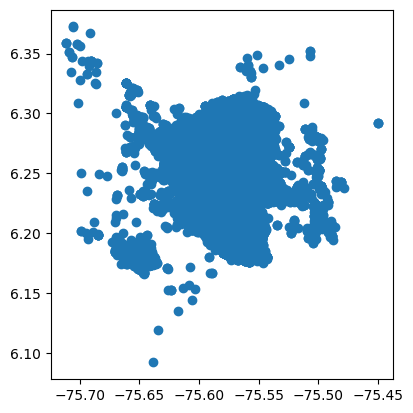

In [11]:
hurtos_coord.plot()

De manera puntual tenemos la mayoría de casos de hurtos reportados entre 2018-2022

## **Carga de shapefile asocidado con los barrios**

In [29]:
mede_shp = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/catastro/catastro.shp')

In [30]:
mede_shp.head()

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry
0,6753,9087,90,87,Suburbano Matasano 3,9,R,SANTA ELENA,81924.472168,1236.511083,"POLYGON ((-75.51343 6.27428, -75.51291 6.27425..."
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482..."
2,6755,0701,07,01,Universidad Nacional,2,U,ROBLEDO,490437.147949,2838.152470,"POLYGON ((-75.57688 6.26663, -75.57672 6.26666..."
3,6756,0510,05,10,Tricentenario,2,U,CASTILLA,421343.229492,2922.008690,"POLYGON ((-75.56621 6.29586, -75.56619 6.29586..."
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,"POLYGON ((-75.58774 6.20276, -75.58819 6.20163..."


Filtramos para los casos de las comunas a trabajar

In [32]:
mede_shp = mede_shp[~mede_shp.COMUNA.isin(['90','80','70','60','50'])]

In [15]:
mede_shp['indice_manzana'] = mede_shp.index

In [33]:
mede_shp.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [34]:
mede_shp= mede_shp.to_crs("EPSG:4326")

In [35]:
mede_shp.shape

(265, 11)

In [41]:
#len(mede_shp.COBAMA.unique())
#len(mede_shp.BARRIOVERE.unique())
#mede_shp.reset_index(drop=True, inplace=True)

In [38]:
mede_shp = mede_shp.set_geometry("geometry")

In [39]:
mede_shp.head()

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482..."
2,6755,0701,07,01,Universidad Nacional,2,U,ROBLEDO,490437.147949,2838.152470,"POLYGON ((-75.57688 6.26663, -75.57672 6.26666..."
3,6756,0510,05,10,Tricentenario,2,U,CASTILLA,421343.229492,2922.008690,"POLYGON ((-75.56621 6.29586, -75.56619 6.29586..."
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,"POLYGON ((-75.58774 6.20276, -75.58819 6.20163..."
5,6758,1113,11,13,El Estadio,4,U,LAURELES,365142.314453,2636.136878,"POLYGON ((-75.59328 6.26189, -75.59324 6.26188..."


Visualmente podemos ver como se distribuyen los hurtos a través de las diferentes comunas

<Axes: >

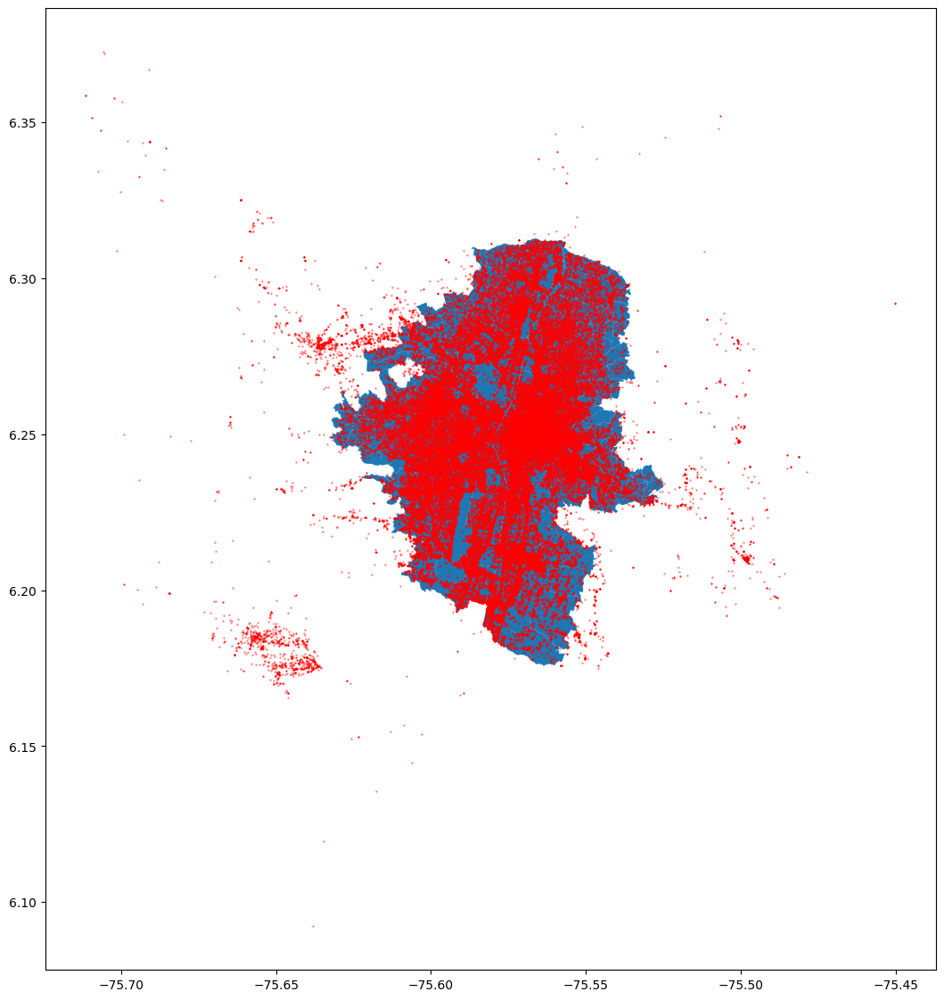

In [40]:
axis = mede_shp.plot(figsize=(20,14))
hurtos_coord.plot(ax=axis, color = "red",markersize =0.1)

Ahora vamos a hacer un cruce para dejar solo aquellos puntos que estén en Medellín


In [42]:
med_hurtos = sjoin(mede_shp,hurtos_coord)

In [43]:
med_hurtos

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry,index_right,fecha_hecho,latitud,longitud,codigo_barrio,codigo_comuna,lugar,year
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",45455,2019-12-31 20:30:00-05:00,6.262939,-75.606951,#1305,13,Vía pública,2019
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",105137,2018-05-16 11:00:00-05:00,6.262517,-75.609299,#1305,13,Vía pública,2018
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",40371,2019-11-30 00:00:00-05:00,6.262400,-75.608110,#1305,13,Vía pública,2019
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",118838,2022-02-04 14:15:00-05:00,6.262424,-75.608409,#1305,13,Vía pública,2022
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",146788,2022-04-18 05:00:00-05:00,6.262459,-75.608341,#1305,13,"Institución educativa (jardín, primaria o secu...",2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
348,7101,0805,08,05,Batallón Girardot,3,U,VILLA HERMOSA,206279.599609,2495.595303,"POLYGON ((-75.54999 6.26210, -75.54998 6.26209...",149136,2022-05-06 06:30:00-05:00,6.260804,-75.552129,#0805,8,Almacén tienda y otro,2022
348,7101,0805,08,05,Batallón Girardot,3,U,VILLA HERMOSA,206279.599609,2495.595303,"POLYGON ((-75.54999 6.26210, -75.54998 6.26209...",179735,2021-12-16 08:00:00-05:00,6.260927,-75.552234,#0805,8,"Hotel, motel y hostal",2021
348,7101,0805,08,05,Batallón Girardot,3,U,VILLA HERMOSA,206279.599609,2495.595303,"POLYGON ((-75.54999 6.26210, -75.54998 6.26209...",127917,2021-04-19 17:30:00-05:00,6.260189,-75.550803,#0805,8,Vía pública,2021
348,7101,0805,08,05,Batallón Girardot,3,U,VILLA HERMOSA,206279.599609,2495.595303,"POLYGON ((-75.54999 6.26210, -75.54998 6.26209...",127916,2021-04-19 17:30:00-05:00,6.260189,-75.550803,#0805,8,Vía pública,2021


A continuación se creará un índice que me permita diferenciar cada una de las zonas o barrios con los que trabajaremos. Para esto se hará uso de la combinación comuna + barrio, la cual presentará unicidad entre los registros tratados, esto debido de forma natural a su concepción, en el cual se enumera cada barrio al interior de cada comuna, esta última también enumerada.

In [44]:
med_hurtos['key'] = med_hurtos['COMUNA']+'_'+med_hurtos['BARRIO']

In [45]:
med_hurtos.head()

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry,index_right,fecha_hecho,latitud,longitud,codigo_barrio,codigo_comuna,lugar,year,key
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.86377,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",45455,2019-12-31 20:30:00-05:00,6.262939,-75.606951,#1305,13,Vía pública,2019,13_05
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.86377,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",105137,2018-05-16 11:00:00-05:00,6.262517,-75.609299,#1305,13,Vía pública,2018,13_05
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.86377,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",40371,2019-11-30 00:00:00-05:00,6.262400,-75.608110,#1305,13,Vía pública,2019,13_05
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.86377,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",118838,2022-02-04 14:15:00-05:00,6.262424,-75.608409,#1305,13,Vía pública,2022,13_05
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.86377,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",146788,2022-04-18 05:00:00-05:00,6.262459,-75.608341,#1305,13,"Institución educativa (jardín, primaria o secu...",2022,13_05


A continuación encontramos el número de casos por barrio

In [55]:
hurtos_by_barrio = pd.DataFrame(med_hurtos.groupby(['key']).count()['OBJECTID']).reset_index(level=['key'])
hurtos_by_barrio.columns = ['key','casos']

In [56]:
hurtos_by_barrio

,key,casos
0,01_01,360
1,01_02,89
2,01_03,294
3,01_04,148
4,01_05,148
...,...,...
260,16_17,210
261,16_18,528
262,16_19,309
263,16_20,538


Crucemos con la base de barrios, para eso creamos el índice del barrio como "comuna_barrio" de nuevo, en esta ocasion para las diferentes zonas (barrios de nuestro shapefile), de esta manera tendremos una llave que nos permita hacer los diferentes joins.

In [50]:
mede_shp.shape

(265, 11)

In [51]:
mede_shp['key'] = mede_shp['COMUNA']+'_'+mede_shp['BARRIO']

El nuevo df con el key tiene la siguiente forma

In [52]:
mede_shp

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry,key
1,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",13_05
2,6755,0701,07,01,Universidad Nacional,2,U,ROBLEDO,490437.147949,2838.152470,"POLYGON ((-75.57688 6.26663, -75.57672 6.26666...",07_01
3,6756,0510,05,10,Tricentenario,2,U,CASTILLA,421343.229492,2922.008690,"POLYGON ((-75.56621 6.29586, -75.56619 6.29586...",05_10
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,"POLYGON ((-75.58774 6.20276, -75.58819 6.20163...",15_11
5,6758,1113,11,13,El Estadio,4,U,LAURELES,365142.314453,2636.136878,"POLYGON ((-75.59328 6.26189, -75.59324 6.26188...",11_13
...,...,...,...,...,...,...,...,...,...,...,...,...
338,7091,0311,03,11,La Cruz,1,U,MANRIQUE,540244.131836,3624.131732,"POLYGON ((-75.54260 6.26906, -75.54260 6.26907...",03_11
339,7092,0507,05,07,Héctor Abad Gómez,2,U,CASTILLA,245458.812500,3508.370038,"POLYGON ((-75.55745 6.30575, -75.55742 6.30553...",05_07
341,7094,1307,13,07,Juan XXIII La Quiebra,4,U,SAN JAVIER,376465.252930,3029.274928,"POLYGON ((-75.61373 6.27017, -75.61374 6.27012...",13_07
345,7098,0602,06,02,Doce de Octubre No.1,2,U,DOCE DE OCTUBRE,452439.901367,3264.713666,"POLYGON ((-75.57882 6.30232, -75.57893 6.30236...",06_02


Hacemos el join con la cantidad de hurtos por barrio, para adisionar esta característica al df

In [57]:
mede_shp = mede_shp.merge(hurtos_by_barrio,how ='left', on='key')

In [58]:
mede_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 265 entries, 0 to 264
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    265 non-null    int64   
 1   CODIGO      265 non-null    object  
 2   COMUNA      265 non-null    object  
 3   BARRIO      265 non-null    object  
 4   NOMBRE_BAR  265 non-null    object  
 5   SECTOR      265 non-null    int64   
 6   INDICADOR_  265 non-null    object  
 7   NOMBRE_COM  265 non-null    object  
 8   SHAPE__Are  265 non-null    float64 
 9   SHAPE__Len  265 non-null    float64 
 10  geometry    265 non-null    geometry
 11  key         265 non-null    object  
 12  casos       265 non-null    int64   
dtypes: float64(2), geometry(1), int64(3), object(7)
memory usage: 29.0+ KB


In [59]:
mede_shp.casos = mede_shp.casos.astype('Int64')

In [60]:
mede_shp.shape

(265, 13)

##**En este punto tenemos la base con el número de casos por barrio**

In [62]:
mede_shp

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry,key,casos
0,6754,1305,13,05,Metropolitano,4,U,SAN JAVIER,101866.863770,1537.700241,"POLYGON ((-75.60795 6.26491, -75.60781 6.26482...",13_05,72
1,6755,0701,07,01,Universidad Nacional,2,U,ROBLEDO,490437.147949,2838.152470,"POLYGON ((-75.57688 6.26663, -75.57672 6.26666...",07_01,342
2,6756,0510,05,10,Tricentenario,2,U,CASTILLA,421343.229492,2922.008690,"POLYGON ((-75.56621 6.29586, -75.56619 6.29586...",05_10,661
3,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,"POLYGON ((-75.58774 6.20276, -75.58819 6.20163...",15_11,587
4,6758,1113,11,13,El Estadio,4,U,LAURELES,365142.314453,2636.136878,"POLYGON ((-75.59328 6.26189, -75.59324 6.26188...",11_13,1862
...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,7091,0311,03,11,La Cruz,1,U,MANRIQUE,540244.131836,3624.131732,"POLYGON ((-75.54260 6.26906, -75.54260 6.26907...",03_11,50
261,7092,0507,05,07,Héctor Abad Gómez,2,U,CASTILLA,245458.812500,3508.370038,"POLYGON ((-75.55745 6.30575, -75.55742 6.30553...",05_07,420
262,7094,1307,13,07,Juan XXIII La Quiebra,4,U,SAN JAVIER,376465.252930,3029.274928,"POLYGON ((-75.61373 6.27017, -75.61374 6.27012...",13_07,75
263,7098,0602,06,02,Doce de Octubre No.1,2,U,DOCE DE OCTUBRE,452439.901367,3264.713666,"POLYGON ((-75.57882 6.30232, -75.57893 6.30236...",06_02,146


Veamos como se ve de acuerdo al número de casos

In [63]:
#Para poder pintarlos
mede_shp.casos.fillna(0, inplace=True)

In [64]:
mede_shp.casos = mede_shp.casos.astype('int64')

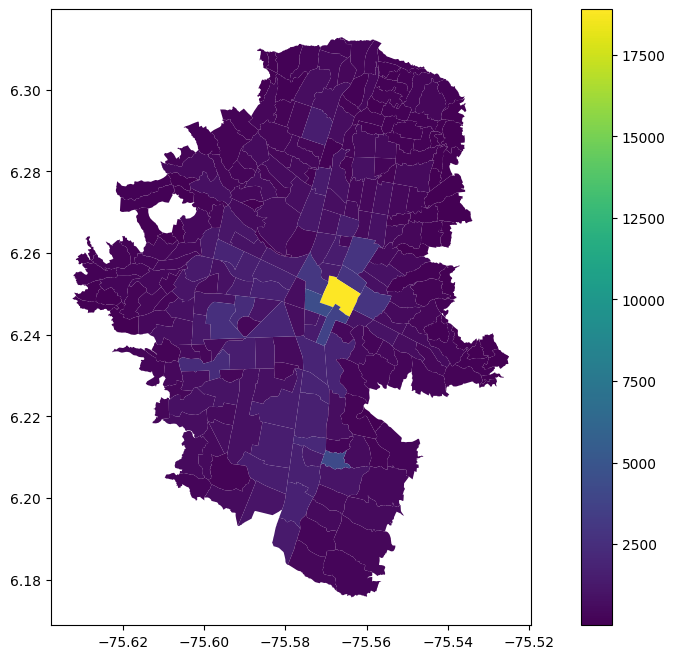

In [67]:
mede_shp.plot(column="casos",figsize=(13,8), legend = True);

El barrio con más casos es

In [68]:
mede_shp[mede_shp.casos == mede_shp.casos.max()]

,OBJECTID,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,geometry,key,casos
111,6901,1019,10,19,La Candelaria,3,U,LA CANDELARIA,661011.169434,3645.511189,"POLYGON ((-75.56726 6.25403, -75.56737 6.25374...",10_19,18900


### **Guardamos los archivos**

In [ ]:
#mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos.shp')
#mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas.shp')

<ipython-input-88-9095ccee90af>:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas.shp')


## **Revisemos los demás shapes**

Para eso validaremos el número de registros, su georreferenciación y la pertinencia de estos en el análisis.


###**Venteros**

In [69]:
venteros = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/venteros.shp')
venteros.head()

,OBJECTID,DOC_AUTORI,NROAUTORIZ,DIRECCIONV,DIRVENTAGE,UBICACION,SECTOR,CUDRANTE,NOMBRE_COM,SEXO,...,TIPO_VENTA,SUBTIPO,TIPOLGIA,NOMBRE_DEL,TIEMPO_CAR,FECHAREGIS,X_COORDENA,Y_COORDENA,LINK,geometry
0,20,Resolución,NaN,Carrera 52A 46 - CR 52A ENTRE CL 46 Y 47...,Carrera 52A 46 -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,ALBA LUZ MOLINA TORO,Femenino,...,Estacionaria,2,MARROQUINERIA,MÓDULO,L-S 07:00-19:30,01/11/2011 12:01:18 p.m.,834705.8951,1.182858e+06,NaN,POINT (834705.895 1182858.308)
1,21,Resolución,NaN,Calle 47 52A - CL 47 ENTRE CR 52A Y 53 P...,Calle 47 52A -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,Bibiana Maryi Restrepo Henao,Femenino,...,Estacionaria,2,CALZADO,MÓDULO,L-S 8:00-19:00,01/11/2011 12:06:57 p.m.,834716.1152,1.182927e+06,NaN,POINT (834716.115 1182926.565)
2,22,Resolución,NaN,Calle 47 52 - CL 47 ENTRE CR 52 Y 52A PT...,Calle 47 52 -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,MARIELA DEL SOCORRO CASTRO DE ARIAS,Femenino,...,Estacionaria,2,ROPA EXTERIOR,MÓDULO,L-S 8:00-19:00,01/11/2011 01:05:03 p.m.,834764.2862,1.182910e+06,NaN,POINT (834764.286 1182910.206)
3,23,Resolución,NaN,Calle 51 51 - 72,Calle 51 51 - 72,CENTRO REPRESENTATIVO,La Candelaria,DOS,LILIANA MARCELA ARDILA HERNANDEZ,Femenino,...,Semi Estacionario,3,FRUTAS,EXHIBIDOR,L-D 6:00-19:00,01/11/2011 01:16:56 p.m.,834930.8950,1.183215e+06,NaN,POINT (834930.895 1183214.856)
4,24,Resolución,NaN,Calle 51 55 - 13,Calle 51 55 - 13,CENTRO REPRESENTATIVO,La Candelaria,DOS,MARIA MAGDALENA LOPEZ,Femenino,...,Semi Estacionario,3,FRUTAS,CARRO,L-S 8:00-19:00,01/11/2011 01:37:30 p.m.,834600.9990,1.183350e+06,NaN,POINT (834600.999 1183349.818)


<Axes: >

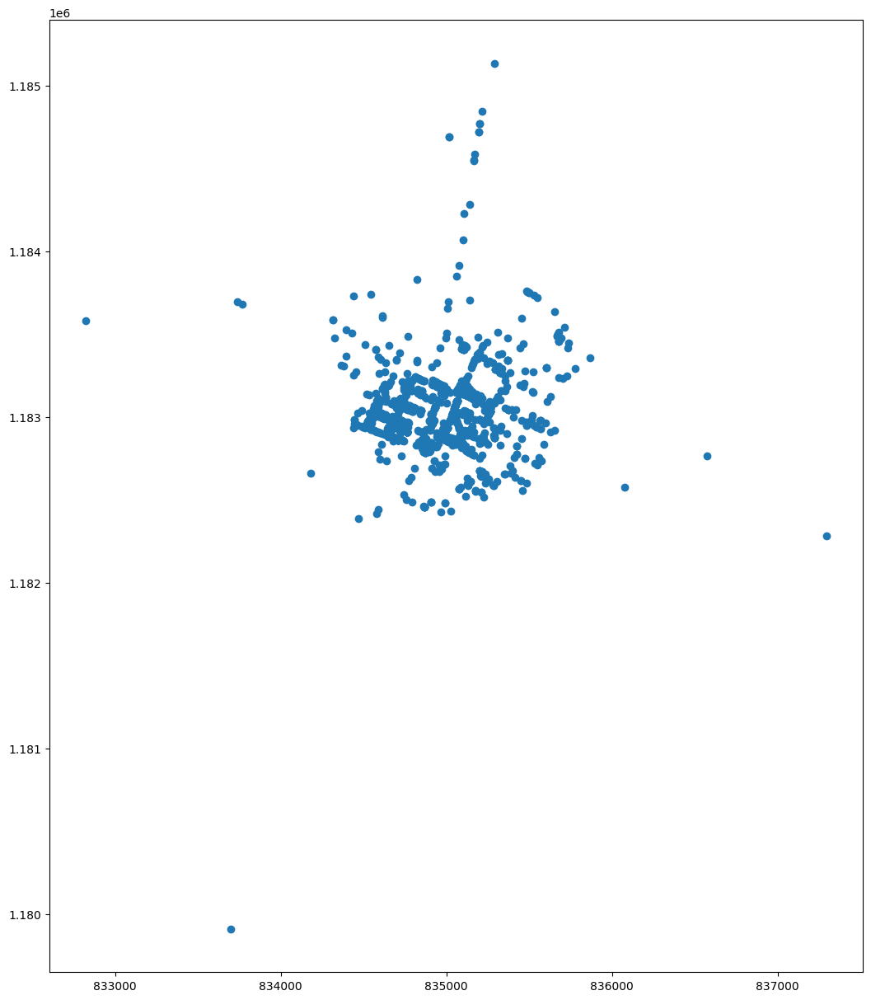

In [70]:
venteros.plot(figsize=(20,15))

In [72]:
venteros.crs

<Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [73]:
venteros= venteros.to_crs("EPSG:4326")

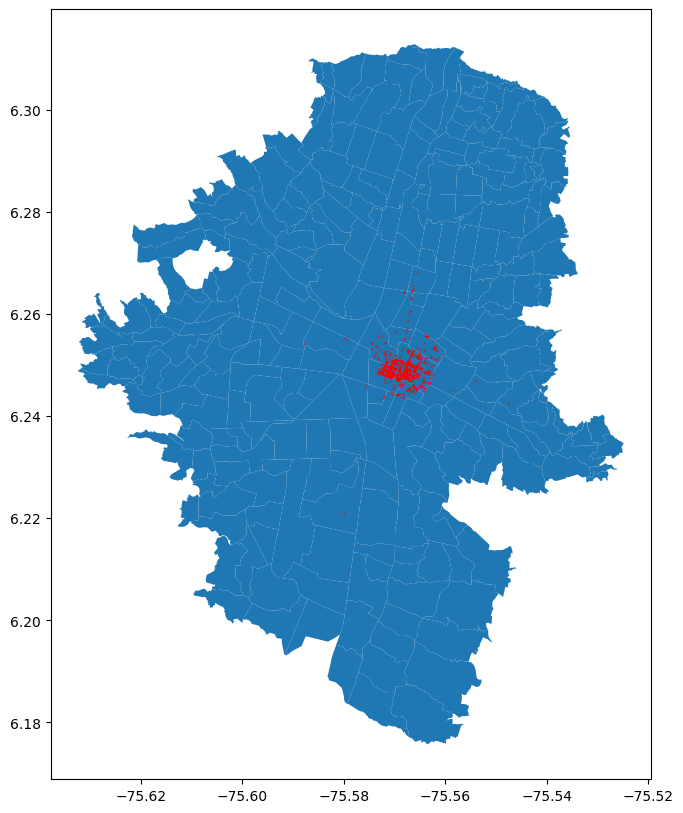

In [76]:
axis = mede_shp.plot(figsize=(16,10))
venteros.plot(ax=axis, color = "red",markersize =0.1);

Lo anterior corresponde a algunas ventas informales  que se tiene registradas en Medellín. Puede servir, aunque tenemos un número muy bajo de registros.

In [77]:
venteros.shape

(1177, 31)

###**Usos rurales**

Lugares definidos para la producción agricola, estos son legalmente destinadas para esto.

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Usos_Rurales.shp')
dummy.head()

,OBJECTID,CORREGIMIE,SHAPEAREA,SHAPELEN,CATEGORIA_,COD_CAT_US,CATEGORI_1,SUBCATEGOR,geometry
0,18,San Antonio de Prado,1.615689e+05,3187.890752,Agrícola,5,Áreas de protección para la producción,Producción agrícola,"POLYGON ((-75.64022 6.19212, -75.64022 6.19210..."
1,19,San Antonio de Prado,3.116689e+04,1021.176293,Agrícola,5,Áreas de protección para la producción,Producción agrícola,"POLYGON ((-75.65180 6.19318, -75.65179 6.19316..."
2,20,San Antonio de Prado,8.195325e+03,414.405716,Agrícola,5,Áreas de protección para la producción,Producción agrícola,"POLYGON ((-75.64980 6.19340, -75.64973 6.19340..."
3,21,San Cristóbal,2.542702e+04,754.323765,Agrícola,5,Áreas de protección para la producción,Producción agrícola,"POLYGON ((-75.61831 6.29157, -75.61819 6.29067..."
4,22,San Cristóbal,1.670528e+06,15322.284738,Agrícola,5,Áreas de protección para la producción,Producción agrícola,"POLYGON ((-75.65730 6.30386, -75.65731 6.30383..."


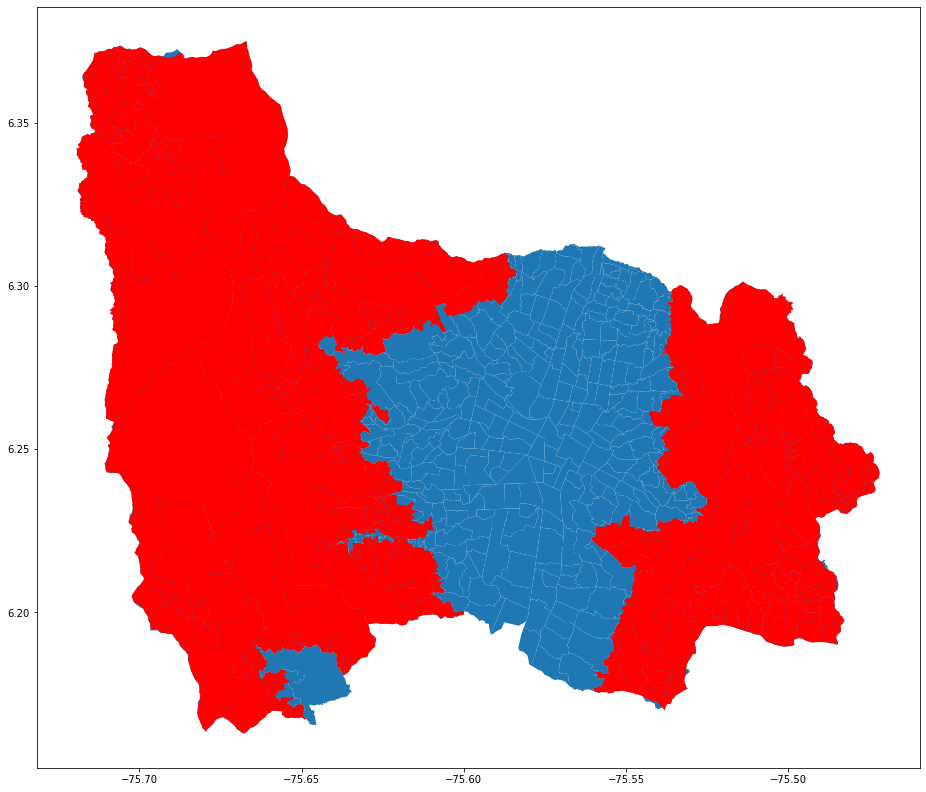

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =0.1)

Esta información no nos servirá para nuestro análisis.

###**Universidades**

In [88]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Universidades.shp')
dummy.head()

,Id,Nombre,geometry
0,0,UPB,"POLYGON ((832641.765 1181987.408, 832572.487 1..."
1,0,UNAL - Iguaná,"POLYGON ((834068.802 1184953.359, 834092.426 1..."
2,0,UNAL - Robledo,"POLYGON ((832196.089 1185737.235, 832271.256 1..."
3,0,UDEA,"POLYGON ((834767.848 1185404.356, 835208.107 1..."
4,0,UDEM,"POLYGON ((830222.647 1181267.567, 830414.331 1..."


In [89]:
dummy.crs

<Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [90]:
dummy= dummy.to_crs("EPSG:4326")

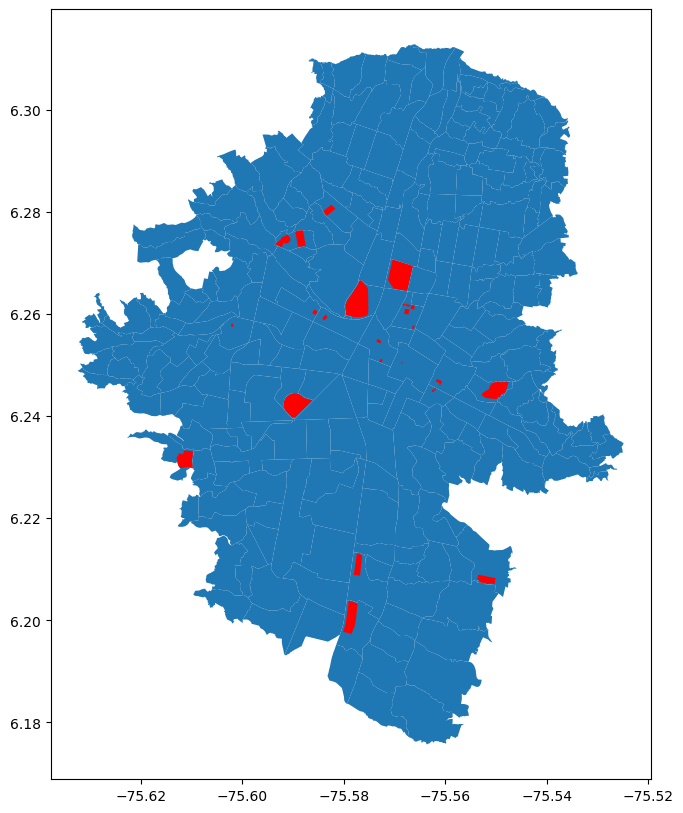

In [92]:
axis = mede_shp.plot(figsize=(14,10))
dummy.plot(ax=axis, color = "red",markersize =0.1);

Podemos calcular la distancia a las universidades y usar esto como un valor, en vez de usar la cantidad

###**Toponimia**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Toponimia.shp')
dummy.head()

,Join_Count,TARGET_FID,OBJECTID,COBAMA,NOMBRE,TIPO_SITIO,TIPO_IMPOR,CBML,X_MAGNAMED,Y_MAGNAMED,...,NOMBRE_COM,OBJECTID_1,CODIGO,NOMBRE_1,LIMITECOMU,SHAPE_AREA,SHAPE_LEN,Orden,Zona,geometry
0,1,0,14497,0723020,URBANIZACION VILLA CAMPIÑA,02,02,07230200006,831018.9732,1.186986e+06,...,ROBLEDO,869,0723,Pajarito,07,2.903139e+05,4232.764966,7,2,POINT (831018.972 1186986.340)
1,1,1,14498,1415001,C. RESERVA ETAPA 1,02,02,14150010012,835040.9262,1.177215e+06,...,EL POBLADO,895,1415,Los Balsos No.2,14,4.863598e+05,2946.534197,14,5,POINT (835040.926 1177215.501)
2,1,2,14499,9084002,TANQUE,26,03,90840020028,842412.4180,1.178702e+06,...,SANTA ELENA,1281,9006,Santa Elena Sector Central,90,3.229024e+06,9166.073911,21,3,POINT (842412.419 1178702.090)
3,1,3,14500,0903016,SANCHEZ,01,Alta,09030160004,837639.9825,1.180586e+06,...,BUENOS AIRES,887,0903,Bomboná No.2,09,6.596482e+05,4633.858540,9,3,POINT (837639.982 1180585.630)
4,1,4,14501,1005012,ALEJA,01,01,10050120009,835071.8211,1.183762e+06,...,LA CANDELARIA,911,1005,Estación Villa,10,1.950540e+05,1965.188454,10,3,POINT (835071.821 1183762.235)


In [ ]:
dummy.columns

Index(['Join_Count', 'TARGET_FID', 'OBJECTID', 'COBAMA', 'NOMBRE',
       'TIPO_SITIO', 'TIPO_IMPOR', 'CBML', 'X_MAGNAMED', 'Y_MAGNAMED',
       'CODIGO_BAR', 'NOMBRE_BAR', 'CODIGO_COM', 'NOMBRE_COM', 'OBJECTID_1',
       'CODIGO', 'NOMBRE_1', 'LIMITECOMU', 'SHAPE_AREA', 'SHAPE_LEN', 'Orden',
       'Zona', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

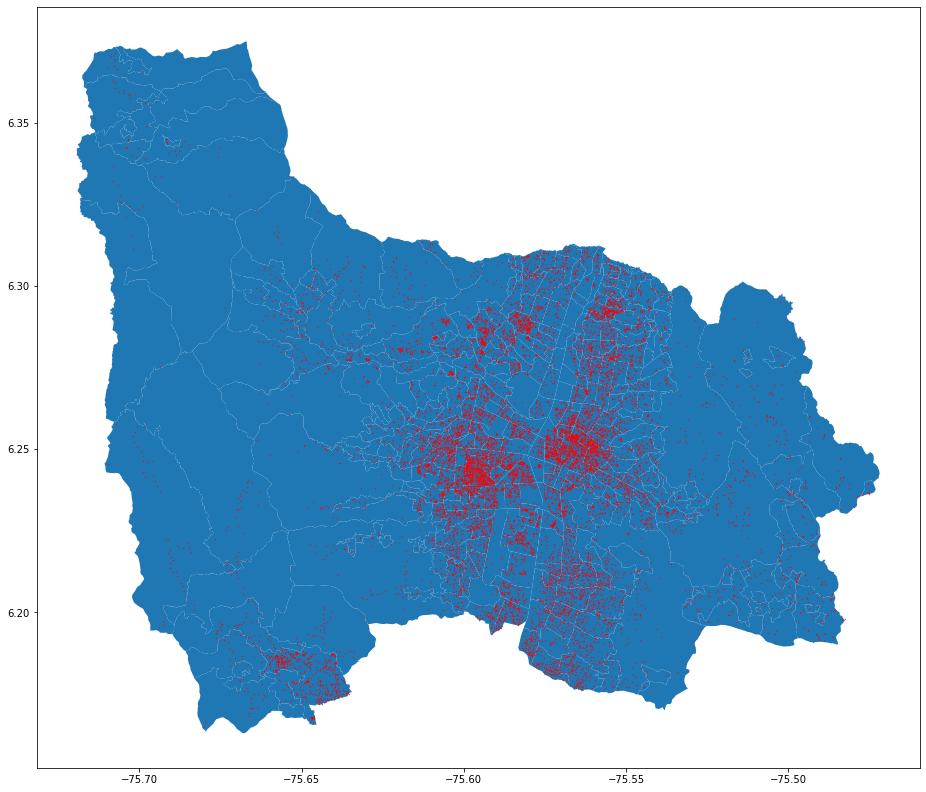

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =0.1)

In [ ]:
dummy.iloc[0]

Join_Count                                               1
TARGET_FID                                               0
OBJECTID                                             14497
COBAMA                                             0723020
NOMBRE                          URBANIZACION VILLA CAMPIÑA
TIPO_SITIO                                              02
TIPO_IMPOR                                              02
CBML                                           07230200006
X_MAGNAMED                                     831018.9732
Y_MAGNAMED                                    1186986.3419
CODIGO_BAR                                            0723
NOMBRE_BAR                                        Pajarito
CODIGO_COM                                              07
NOMBRE_COM                                         ROBLEDO
OBJECTID_1                                             869
CODIGO                                                0723
NOMBRE_1                                          Pajari

**Se debe investigar que es?**

###**Sitios_turisticos**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Sitios_turisticos.shp')
dummy.head()

,OBJECTID,NOMBRESITI,IMPERDIBLE,TIPOATRACT,COD_COMUNA,COM_CORR,LABEL,geometry
0,1,Cerro Nutibara,NO,Cerro,16,Belén,Cerro Nutibara,POINT (833753.022 1181545.608)
1,2,Teatro La Casa de Crisanto,NO,Edificación para la cultura,16,Belén,Teatro La Casa de Crisanto,POINT (833767.182 1181871.964)
2,3,Unidad Deportiva de Belén Andrés Escobar Salda...,NO,Escenario para la recreación y el deporte,16,Belén,UD. Belén,POINT (832809.285 1181521.876)
3,4,Teatro Universidad de Medellín Gabriel Obregón...,NO,Edificación para la cultura,16,Belén,Teatro Universidad de Medellín,POINT (830326.576 1181209.786)
4,5,Aeroparque Juan Pablo II,NO,Escenario para la recreación y el deporte,15,Guayabal,Aeroparque Juan Pablo II,POINT (832376.684 1179944.475)


In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

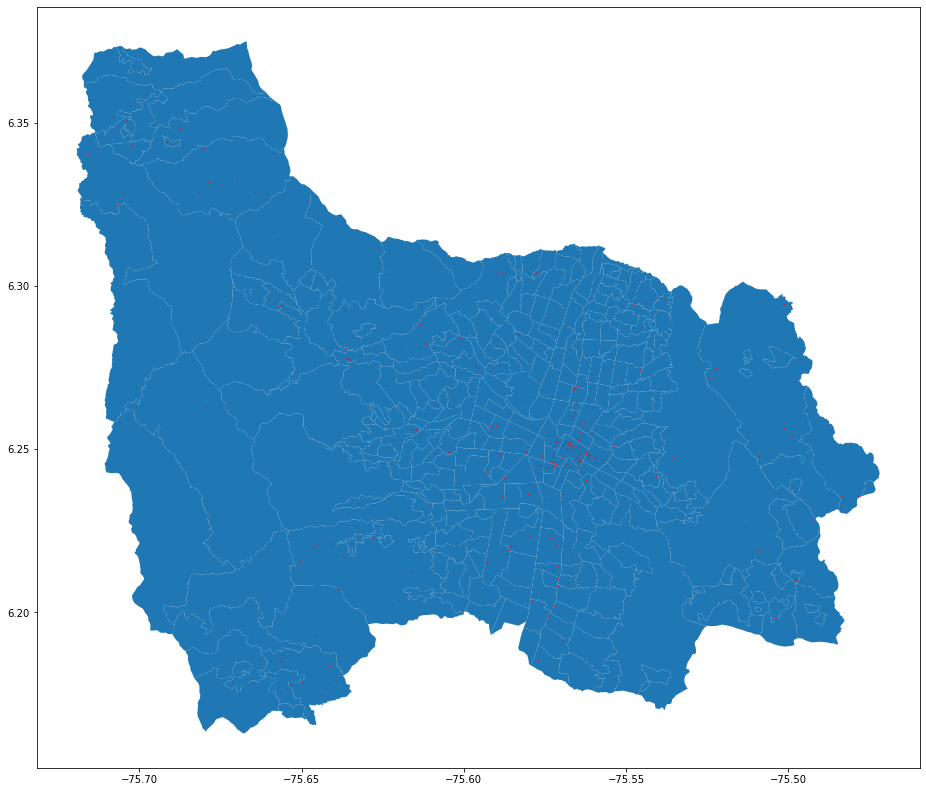

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =0.1)

Tenemos dos opciones con esta variable:

* Poner la distancia a un sitio turístico
* Poner la cantidad de estos en el lugar

###**Semaforos**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Semaforos.shp')
dummy.head()

,OBJECTID,LAYER,ORDEN,DIRECCION,CLASE_CL,M,M1,M2,M3,P,...,IDCRUCE,IDCONTROL,FECHA_INST,COMENTARIO,SEM_CICLA,SEM_PEAT_C,PULSADOR_P,DETECT_MAL,DETEC_MALL,geometry
0,27,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 34 x CL 7,EC-1,2.0,0.0,None,None,2.0,...,0052,039,None,None,0,0,0,0,None,POINT (835401.374 1178247.054)
1,28,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 35 x CL 10,EC-1,0.0,1.0,1,None,0.0,...,0053,020,None,None,0,0,2,0,1,POINT (835299.874 1178543.562)
2,29,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 35 x CL 10 A,EC-1,0.0,0.0,1,None,0.0,...,0054,014,None,None,0,0,2,0,None,POINT (835344.076 1178633.033)
3,30,CORREDOR TRANVIARIO,9.0,CR 35 x CL 49,None,0.0,3.0,None,None,0.0,...,0055,250,None,None,0,0,0,0,None,POINT (836306.003 1182312.778)
4,31,CONECTADOS A CENTRAL CON PARES PROPIOS DE LA S...,14.0,CR 35 x CL 5 SUR,EC-1,1.0,1.0,1,None,0.0,...,0056,042,None,None,0,0,4,0,None,POINT (834984.642 1177245.022)


In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

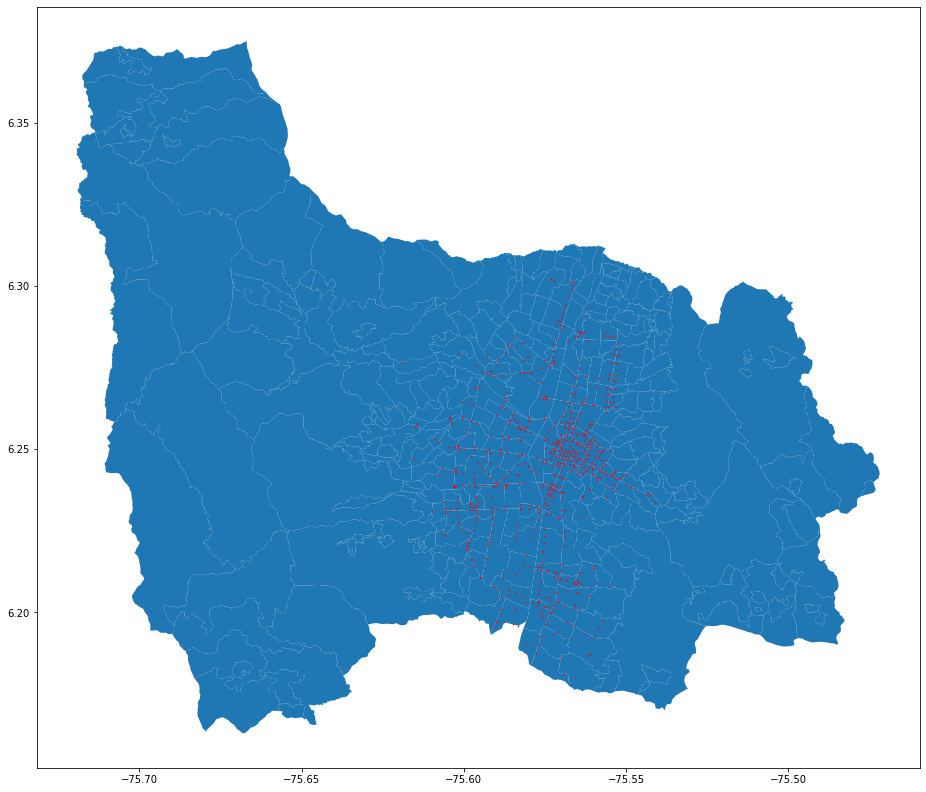

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =0.4)

Podemos ingresar la cantidad de semaforos

###**SedeSalud**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/SedeSalud.shp')
dummy.head()

,OBJECTID,CODIGO_SED,NOMBRE_CEN,NATURALEZA,FAX,TELEFONO,CORREO,COMPHOSP,MODALIDAD,COMPLURG,...,DIRECCION,CODIGO_BAR,CODSCONS,LINK,OBSERVACIO,REPORTASIV,REPORTAVAC,REPORTARIP,REPORTANUT,geometry
0,268,050010217846,CENTRO DE SALUD LA LOMA,Pública,None,4387767,coordinacionlaloma@metrosalud.gov.co,Ninguna,Ninguna,Ninguna,...,CL 55A 125A 05,6014,050010217846,None,None,Si,Si,Si,Si,POINT (828068.330 1185541.980)
1,269,050010921401,CLINICA DEL CAMPESTRE S.A,Privado con Ánimo de Lucro,None,4442006,clinicadelcampestre1@une.net.co,Ninguna,Ninguna,Ninguna,...,CL 17SUR 44 06,1423,050010921401,None,None,Si,No,Si,No,POINT (833861.350 1176225.920)
2,270,050010819901,UBA COOMEVA EPS CLINICA MEDELLIN LTDA,Privado con Ánimo de Lucro,None,3697221,gerencia@ubamedellin.co,Ninguna,Ninguna,Ninguna,...,CL 54 46 27,1019,050010819901,None,None,Si,Si,Si,Si,POINT (835505.250 1183255.230)
3,271,050010217841,CENTRO DE SALUD FLORENCIA,Pública,None,4614747,coordinacionflorencia@metrosalud.gov.co,Ninguna,Ninguna,Ninguna,...,CL 112 74 20,5040,050010217841,None,None,Si,Si,Si,Si,POINT (834814.790 1189629.200)
4,272,050010115001,FUNDACION INSTITUTO NEUROLOGICO DE COLOMBIA,Privado sin Ánimo de Lucro,None,None,Ninguna,Alta,Hospitalario,Baja,...,CL 55 46 36,1018,050010115001,None,None,Si,No,Si,No,POINT (835528.490 1183375.090)


In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

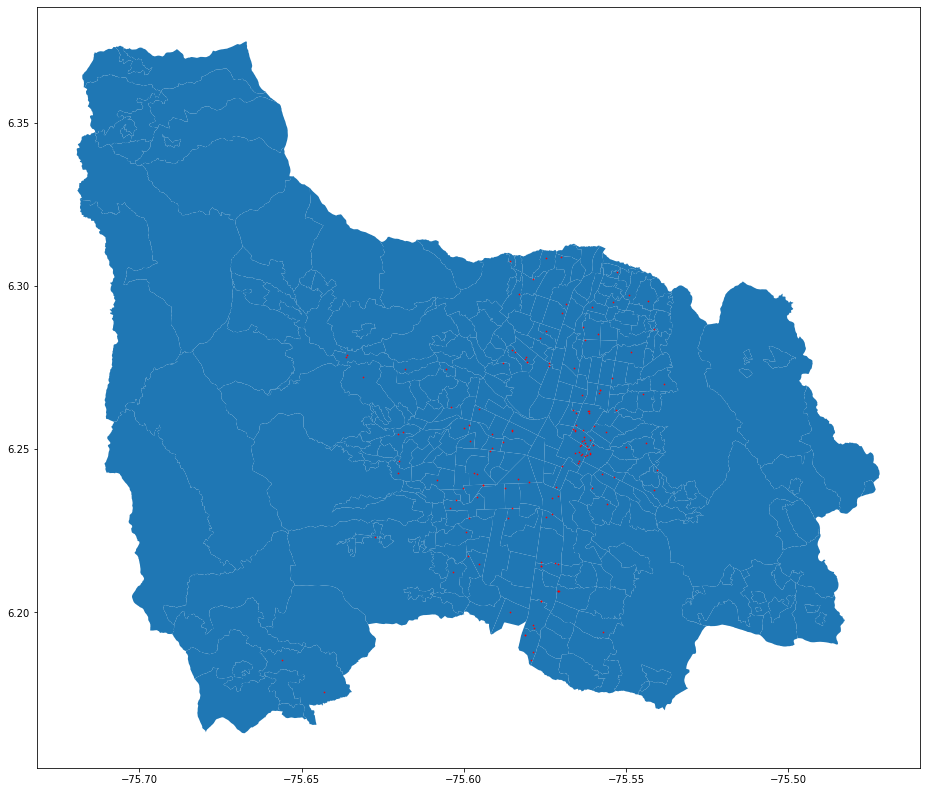

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =0.4)

Tenemos dos opciones con esta variable:

* Poner la distancia al centro de salud
* Poner la cantidad de estos en el lugar

###**Rutas_bus**

In [78]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Rutas_bus.shp')
dummy.head()

,OBJECTID,NOMBRE,ID_RUTA,CODIGO,RECORRIDO,FROM_DATE,SISTEMA,TIPO,EMPRESA,ID_GFLOTA,LONGITUD,SHAPE_LEN,geometry
0,58,San Antonio,90281,107,Origen Destino_Destino Origen,2020-07-13,6H,Directa Centro,Cootransvi,111885,13130.050280,9280.935795,"MULTILINESTRING ((838487.978 1181945.419, 8384..."
1,59,Santa Lucia,90324,311i,Origen Destino_Destino Origen,2021-11-11,8A,Integrada,Coonatra,112192,9589.514838,5201.486888,"MULTILINESTRING ((831834.639 1185441.986, 8318..."
2,60,Buenos Aires,90173,96,Origen Destino_Destino Origen,2020-07-13,6A,Directa Centro,Flota la V,111085,21841.671516,15275.430277,"MULTILINESTRING ((834484.726 1182638.944, 8344..."
3,61,Buenos Aires,90174,096 Horario Esp,Origen Destino_Destino Origen,2020-07-13,6A,Directa Centro,Flota la V,112855,24875.957910,18309.716671,"MULTILINESTRING ((837407.560 1181751.978, 8373..."
4,73,Popular N° 1,90205,23,Origen Destino_Destino Origen,2020-07-13,6B,Directa Centro,Transporte Aranjuez Santa Cruz,111235,18283.006039,14785.457896,"MULTILINESTRING ((837075.485 1189033.441, 8370..."


In [79]:
dummy.crs

<Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [80]:
dummy= dummy.to_crs("EPSG:4326")

<Axes: >

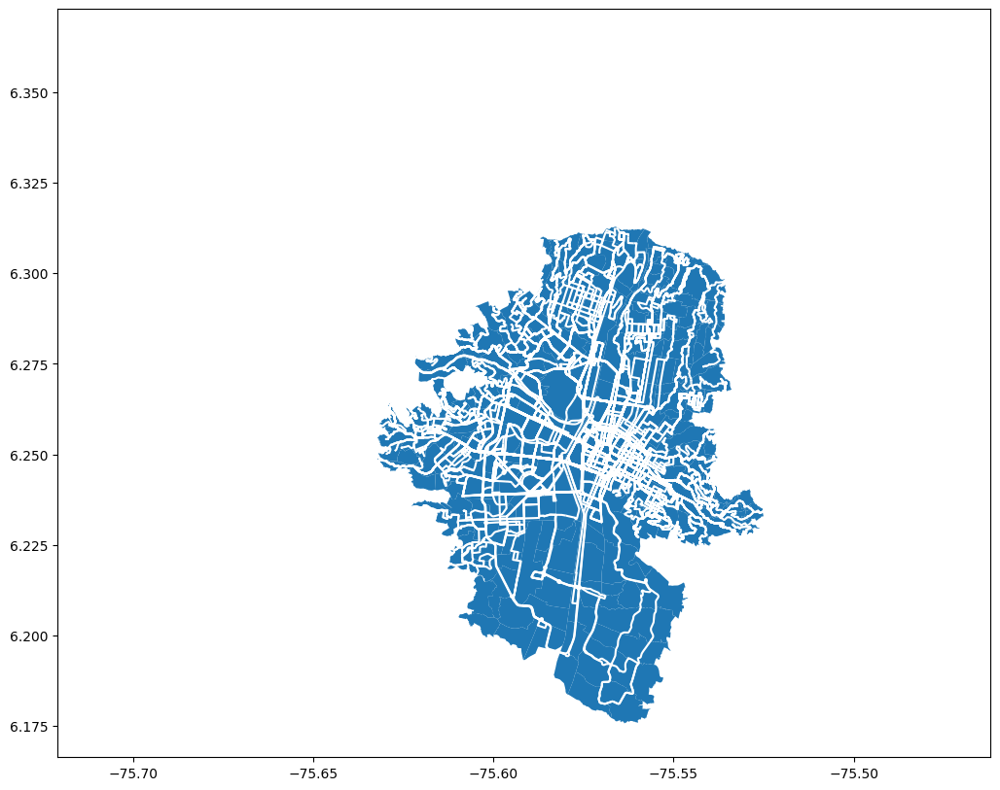

In [82]:
axis = mede_shp.plot(figsize=(14,10))
dummy.plot(ax=axis, color = "white",markersize =0.4)

In [ ]:
mede_shp.geometry[0].distance(dummy.geometry[0])

0.03729872139624166

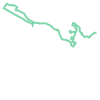

In [ ]:
dummy.geometry[0]

**Número de rutas que pasan por el barrio**

###**Red_ciclista**

In [83]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Red_ciclista.shp')
dummy.head()

,OBJECTID,TIP_RC,TIPOLOGIA,NIVEL,ESTADO,PERIODO,NOM_COMUNA,ID_COMUNA,MUNICIPIO,SHAPE_LEN,geometry
0,109,Vias Ciclistas,Bidireccional a nivel de andén,Anden,Existente,2004 - 2007,La Candelaria,10,MEDELLIN,120.870879,"LINESTRING Z (835139.848 1184323.010 0.000, 83..."
1,110,Vias Ciclistas,Bidireccional a nivel de andén,Anden,Existente,2004 - 2007,La Candelaria,10,MEDELLIN,93.718385,"LINESTRING Z (835116.950 1184204.355 0.000, 83..."
2,111,Vias Ciclistas,Bidireccional a nivel de andén,Anden,Existente,2004 - 2007,La Candelaria,10,MEDELLIN,114.187095,"LINESTRING Z (835099.015 1184112.459 0.000, 83..."
3,112,Vias Ciclistas,Bidireccional a nivel de andén,Anden,Existente,2004 - 2007,La Candelaria,10,MEDELLIN,104.483886,"LINESTRING Z (835078.995 1184000.041 0.000, 83..."
4,113,Vias Ciclistas,Bidireccional a nivel de andén,Anden,Existente,2004 - 2007,La Candelaria,10,MEDELLIN,78.983034,"LINESTRING Z (835064.383 1183897.476 0.000, 83..."


In [84]:
dummy.crs

<Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [85]:
dummy= dummy.to_crs("EPSG:4326")

<Axes: >

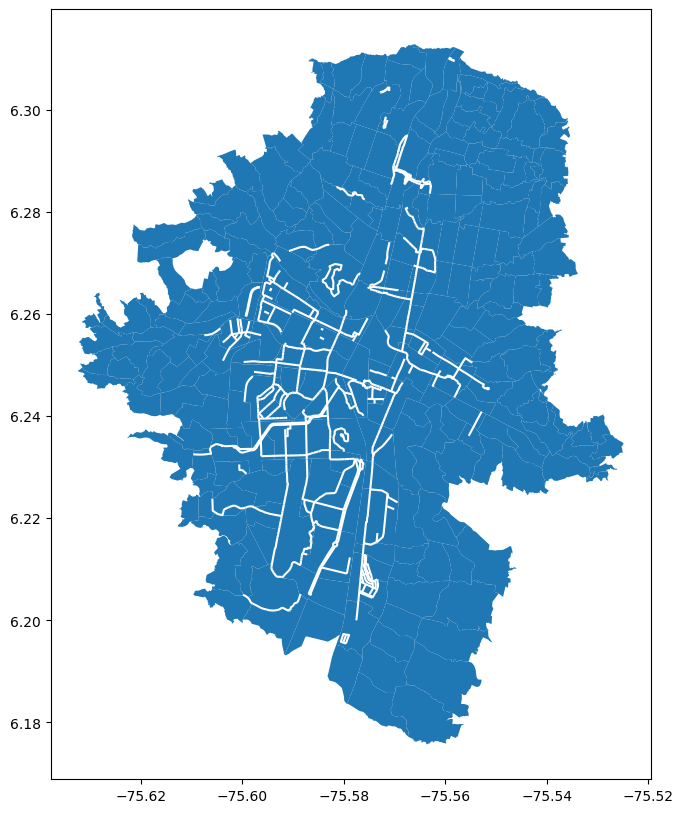

In [87]:
axis = mede_shp.plot(figsize=(14,10))
dummy.plot(ax=axis, color = "white",markersize =0.4)

** número de rutas o cercanía a estas**

###**Puntos_críticos**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Puntos_críticos.shp')
dummy.head()

,OBJECTID,CODIGO,DIRECCION,ANO,COMUNA,BARRIO,COORD_X,COORD_Y,LONGITUD,LATITUD,ID_CONTRAT,NO_PUNTO,geometry
0,16,21,None,0,None,None,836965.186119,1.188870e+06,-75.550552,6.302012,2007,PC000021,POINT (836965.186 1188869.948)
1,321,22,None,0,None,None,836072.012013,1.187900e+06,-75.558622,6.293240,2007,PC000022,POINT (836072.012 1187899.602)
2,322,23,None,0,None,None,837194.118404,1.189034e+06,-75.548484,6.303499,2007,PC000023,POINT (837194.118 1189034.368)
3,323,24,None,0,None,None,836380.664897,1.187469e+06,-75.555834,6.289343,2007,PC000024,POINT (836380.665 1187468.519)
4,12,0,None,0,None,None,836930.108159,1.188274e+06,-75.550869,6.296627,2010,PC000000,POINT (836930.108 1188274.304)


In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

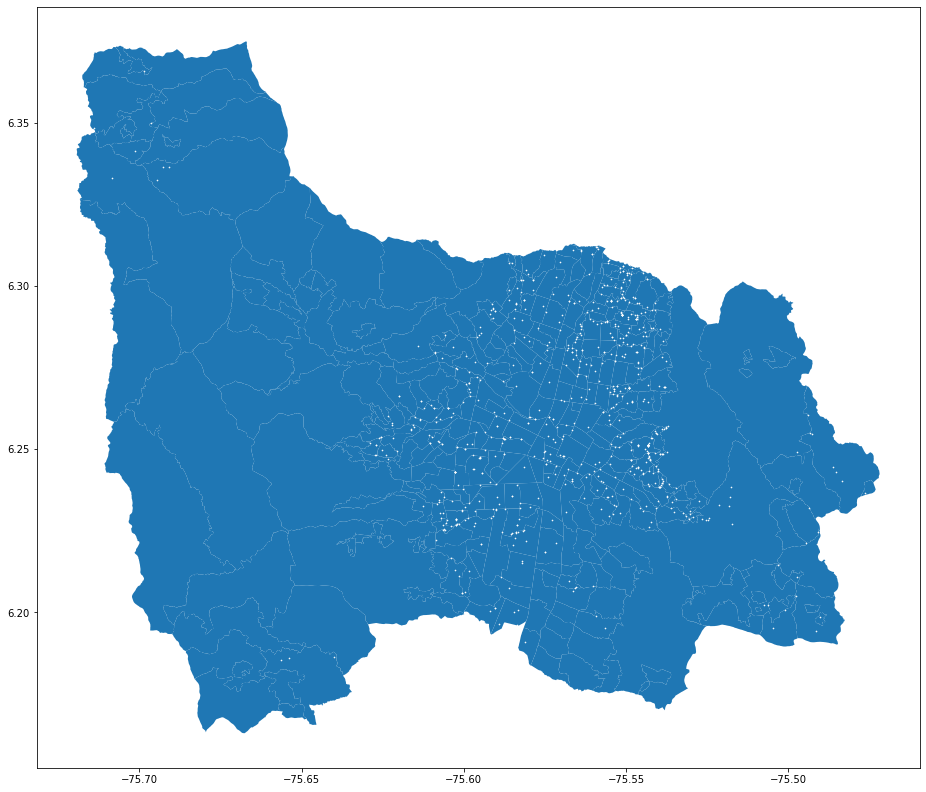

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Investigar a que hace referencia**

###**Poste_Alumbrado**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Poste_Alumbrado.shp')
dummy.head()

,OBJECTID,G3E_FID,ESTADO,MATERIAL,ALTURA,PROPIETARI,DEPARTAMEN,CLASE,TIPO_INSTA,PROYECTO,REQUERIMIE,geometry
0,45,14142951,OPERACION,CONCRETO,0,MEDELLÍN,None,CIRCULAR,None,19381264,46131,MULTIPOINT (825323.389 1174958.977)
1,46,14194011,OPERACION,PRFV,0,ALUMBRADO PUBLICO,None,CIRCULAR,None,20422211,48696,MULTIPOINT (825362.719 1175002.324)
2,47,14194029,OPERACION,PRFV,0,ALUMBRADO PUBLICO,None,CIRCULAR,None,20422211,48696,MULTIPOINT (825371.510 1175013.702)
3,48,14194039,OPERACION,PRFV,0,ALUMBRADO PUBLICO,None,CIRCULAR,None,20422211,48696,MULTIPOINT (825391.319 1175027.428)
4,49,14194077,OPERACION,PRFV,0,ALUMBRADO PUBLICO,None,CIRCULAR,None,20422211,48696,MULTIPOINT (825353.675 1175015.297)


In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

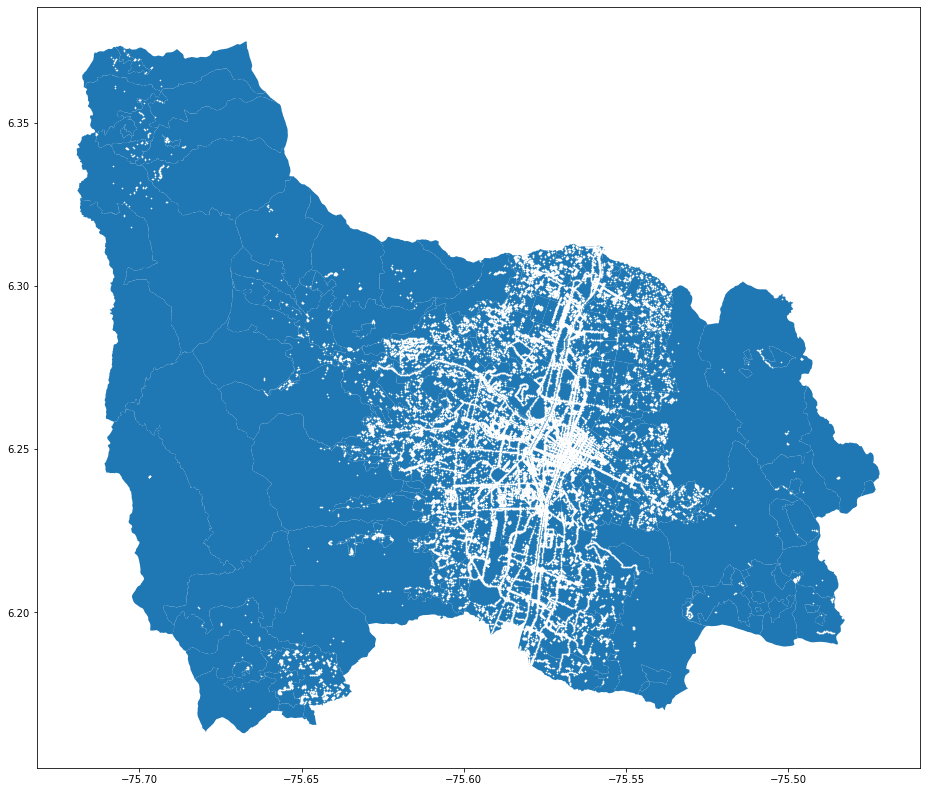

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Podemos usar la cantidad de postes de alumbrado público**

###**Poblacion_Comuna**

In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Poblacion_Comuna.shp')
dummy.head()

,OBJECTID,CODIGO,NOMBRE,SUBTIPO_CO,TOTAL_2005,TOTAL_2006,TOTAL_2007,TOTAL_2008,TOTAL_2009,TOTAL_2010,...,TOTAL_2014,TOTAL_2015,TOTAL_2016,TOTAL_2017,TOTAL_2018,TOTAL_2019,TOTAL_2020,SHAPE_AREA,SHAPE_LEN,geometry
0,1,01,Popular,1,122067,123120,124141,125110,126024,126887,...,129781,130369,130914,131445,131968,132482,132991,3.098290e+06,9604.987826,"POLYGON ((837244.583 1189129.175, 837253.337 1..."
1,2,02,Santa Cruz,1,103212,104168,105127,106070,106989,107869,...,110858,111452,111992,112514,113024,113520,114007,2.195875e+06,8597.714449,"POLYGON ((836247.701 1189761.690, 836253.127 1..."
2,3,03,Manrique,1,148762,150128,151449,152715,153912,155049,...,158877,159658,160378,161070,161735,162374,162990,5.096746e+06,12078.237108,"POLYGON ((837853.931 1187134.721, 837854.740 1..."
3,4,04,Aranjuez,1,156845,157575,158265,158911,159511,160068,...,161885,162252,162596,162915,163213,163489,163748,4.883731e+06,9643.089265,"POLYGON ((835665.830 1187680.766, 835674.393 1..."
4,5,05,Castilla,1,142867,143603,144328,145049,145764,146471,...,149133,149751,150347,150881,151361,151785,152158,6.064367e+06,16098.614898,"POLYGON ((835293.089 1190042.230, 835301.047 1..."


In [ ]:
dummy.columns

Index(['OBJECTID', 'CODIGO', 'NOMBRE', 'SUBTIPO_CO', 'TOTAL_2005',
       'TOTAL_2006', 'TOTAL_2007', 'TOTAL_2008', 'TOTAL_2009', 'TOTAL_2010',
       'TOTAL_2011', 'TOTAL_2012', 'TOTAL_2013', 'TOTAL_2014', 'TOTAL_2015',
       'TOTAL_2016', 'TOTAL_2017', 'TOTAL_2018', 'TOTAL_2019', 'TOTAL_2020',
       'SHAPE_AREA', 'SHAPE_LEN', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

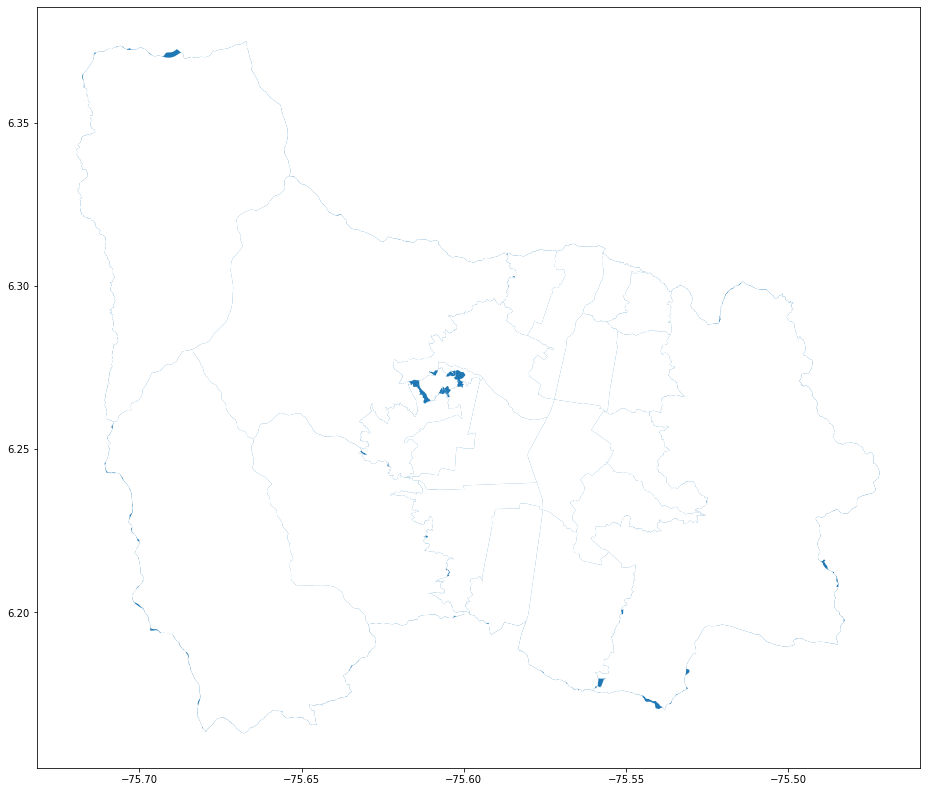

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Está desactualizado y necesitamos a nivel de barrio**

###**Paraderos**



In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Paraderos.shp')
dummy.head()

,OBJECTID,ID_PARADER,NOMBRE,DIRECCION,ORIENTACIO,MOBILIARIO,FROM_DATE,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,geometry
0,228,50228,None,"CR 62 x CL 56A, Medellin",E,None,2018-08-01,826663.6218,1.174641e+06,-75.643610,6.173367,POINT (826663.622 1174640.612)
1,229,50229,None,"CR 62 55 Sur-69, Medellin",N,None,2018-08-01,826672.5699,1.174765e+06,-75.643530,6.174487,POINT (826672.570 1174764.552)
2,230,50230,None,"CR 62B x CL 33, Medellin",W,None,2018-08-01,826674.2832,1.176694e+06,-75.643517,6.191933,POINT (826674.283 1176694.350)
3,231,50231,None,"CR 62 x CL 55, Medellin",S,None,2018-08-01,826674.3375,1.174758e+06,-75.643514,6.174427,POINT (826674.338 1174757.941)
4,233,50233,None,"CL 62B x CR 143A , Medellin",S,None,2018-08-01,826678.1049,1.186126e+06,-75.643495,6.277197,POINT (826678.105 1186125.666)


In [ ]:
dummy.columns

Index(['OBJECTID', 'ID_PARADER', 'NOMBRE', 'DIRECCION', 'ORIENTACIO',
       'MOBILIARIO', 'FROM_DATE', 'X_MAGNAMED', 'Y_MAGNAMED', 'LONGITUD',
       'LATITUD', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

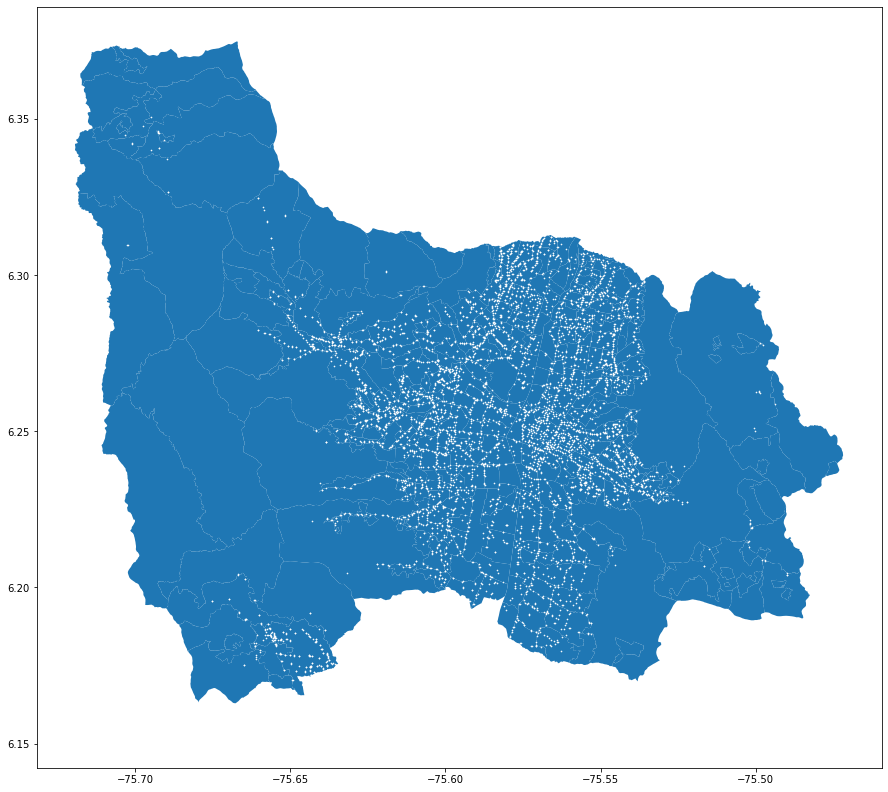

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

Cantidad de paraderos de buses

###**Malla_vial**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Malla_vial.shp')
dummy.head()

,OBJECTID,ID_NM_VIAL,COMUNA,VERSION,GRUPO_VIA,TIPO_VIA,NUMERO_VIA,APENDICE_V,ORIENTACIO,VIA_PRINCI,...,COD_BAR_DE,BARRIO_DER,PREFIJO,LABEL_OLD,MUNICIPIO,IMPORTANCI,ORIENTAC_1,LONGITUD,SHAPE_LEN,geometry
0,36334,1222475,60,1,V,CR,129,A,None,129A,...,6015,SAN JOSE DE LA MONTAÑA,None,None,MEDELLIN,2,None,1436.0,1435.597775,"LINESTRING (827363.584 1189249.702, 827389.786..."
1,36335,1222915,01,1,V,CR,27,CC,None,27CC,...,0111,La Avanzada,None,CR 27CC,MEDELLIN,2,None,7.0,6.668385,"LINESTRING (838074.924 1187950.668, 838078.673..."
2,36336,1222947,01,1,V,CR,32,A,None,32A,...,0101,Santo Domingo Savio No. 1,None,CR 32A,MEDELLIN,0,None,25.0,24.934370,"LINESTRING (837825.956 1188205.064, 837822.214..."
3,36337,1222948,01,1,V,CR,33,None,None,33,...,0101,Santo Domingo Savio No. 1,None,CR 32A,MEDELLIN,0,None,9.0,8.903307,"LINESTRING (837762.693 1188174.556, 837760.143..."
4,36338,1211531,80,1,V,CR,65,None,None,65,...,8000,Cabecera San Antonio de Prado,None,CR 65,MEDELLIN,3,S,95.0,95.173457,"LINESTRING (826444.617 1175564.322, 826434.245..."


In [ ]:
dummy.columns

Index(['OBJECTID', 'ID_NM_VIAL', 'COMUNA', 'VERSION', 'GRUPO_VIA', 'TIPO_VIA',
       'NUMERO_VIA', 'APENDICE_V', 'ORIENTACIO', 'VIA_PRINCI', 'ID_NM_GENE',
       'VIA_GENERA', 'NAME', 'NOMBRE_COM', 'LABEL', 'LABEL_BIG', 'ESTADO',
       'JERARQUIA_', 'COD_BAR_IZ', 'BARRIO_IZQ', 'COD_BAR_DE', 'BARRIO_DER',
       'PREFIJO', 'LABEL_OLD', 'MUNICIPIO', 'IMPORTANCI', 'ORIENTAC_1',
       'LONGITUD', 'SHAPE_LEN', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

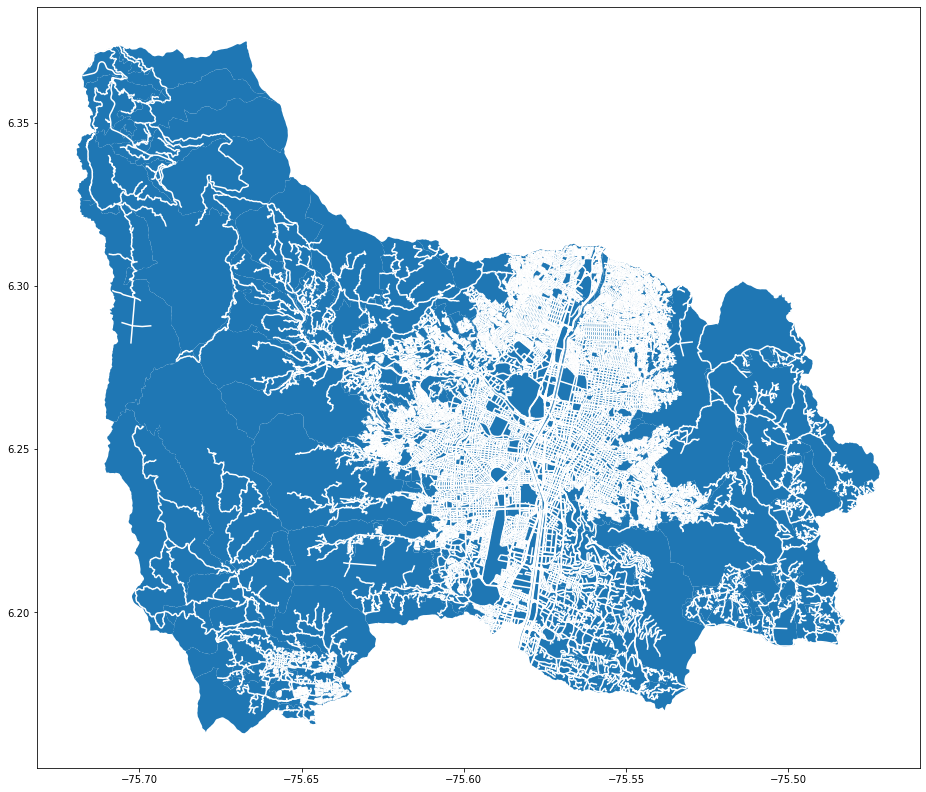

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Número de vías o cercanía a estas. Me decanto por lo primero**

###**Luminarias**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Luminarias.shp')
dummy.head()

,geometry
0,MULTIPOINT (826744.856 1174843.457)
1,MULTIPOINT (826729.049 1174842.239)
2,MULTIPOINT (826729.016 1174843.815)
3,MULTIPOINT (826715.296 1174850.316)
4,MULTIPOINT (826806.138 1174926.188)


In [ ]:
dummy.columns

Index(['geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

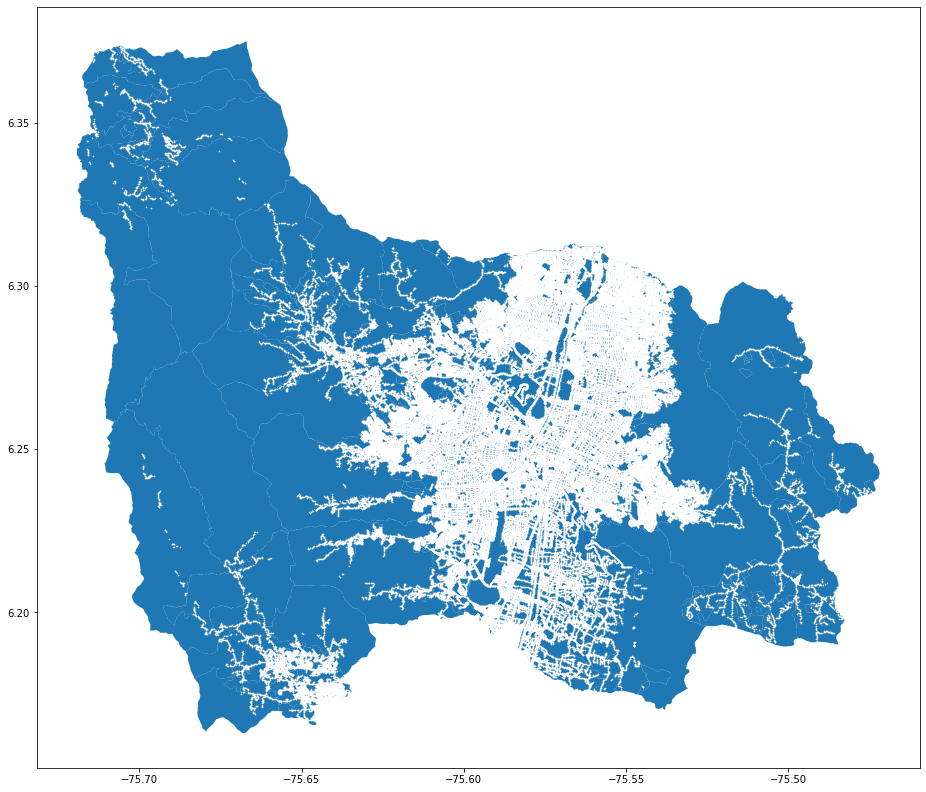

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Revisar a que hacen referencia estos datos**

###**Lineas_metro**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Lineas_metro.shp')
dummy.head()

,OBJECTID,NOMBRE,LINEA,TIPO,ESTADO,SHAPE_LEN,geometry
0,1,U. de M-Av. del Ferrocarril-Parque Aranjuez,Línea 1,3,1,13617.517478,"MULTILINESTRING ((830411.876 1181014.851, 8305..."
1,2,San Antonio-Alejandro Echavarría,Línea T-A,4,1,4236.783484,"LINESTRING (838119.160 1181251.327, 838099.231..."
2,3,U. de M- Pretroncal Oriental,Línea 2,3,1,5043.098924,"MULTILINESTRING ((834769.199 1180712.927, 8347..."
3,4,Alejandro Echavarría-La Sierra,Línea H,2,4,1420.523137,"LINESTRING (838119.160 1181251.327, 838201.525..."
4,5,San Antonio-San Javier,Línea B,1,1,5507.218632,"LINESTRING (834844.267 1182805.203, 834841.068..."


In [ ]:
dummy.columns

Index(['geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

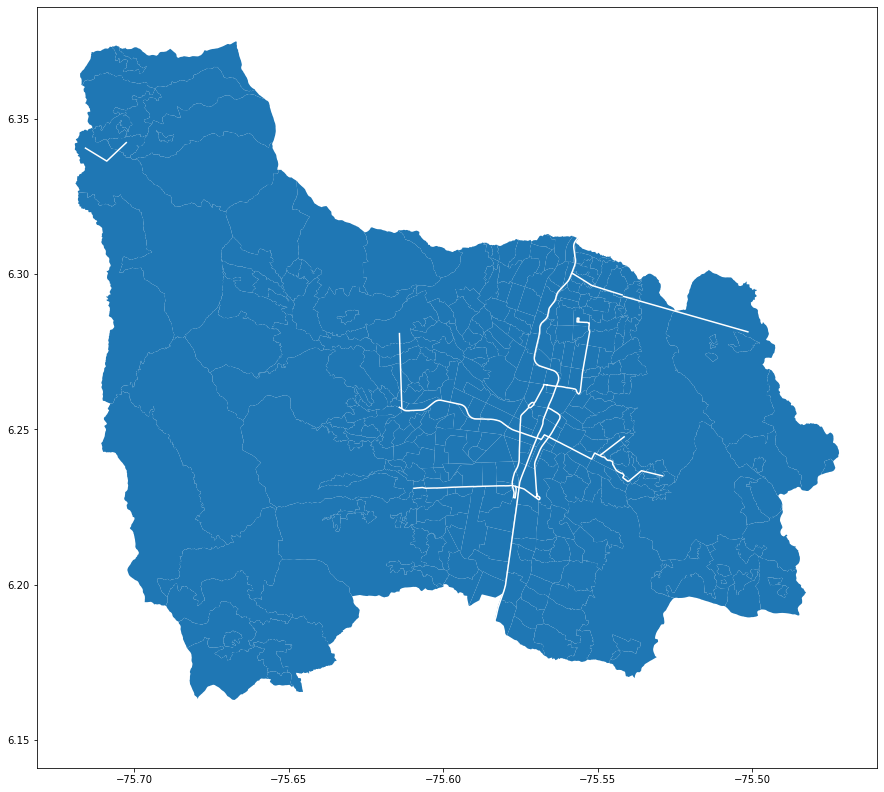

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Cercanía a una línea del metro**

###**InstituEduca**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/InstituEduca.shp')
dummy.head()

,OBJECTID,NOMBRE_EST,SEDE_EDUCA,NUCLEO,SERVICIO,SECTOR,DIRECCION,TELEFONO,ESTADO,VIGENCIA,X_MAGNAMED,Y_MAGNAMED,CLASIFICAC,CODIGO_DAN,CONS_SEDE,DANE_SEDE,geometry
0,102,INST EDUC PEDRO LUIS VILLA,INST EDUC PEDRO LUIS VILLA,916.0,OFICIAL,Oficial,CR 43 66 C 40,2337963,Activo,2020.0,836597.1525,1.184350e+06,Oficial - Sede Principal,105001002488,10500100248801,105001002488,POINT (836597.152 1184349.520)
1,103,INST EDUC PEDRO LUIS VILLA,SEC ESC MARCO FIDEL SUAREZ,916.0,OFICIAL,Oficial,CL 70 A 43 74,2331640,Activo,2020.0,836641.0500,1.184897e+06,Oficial - Sede Escuela,105001002488,10500100248802,105001002046,POINT (836641.050 1184897.220)
2,104,INST EDUC PEDRO LUIS VILLA,SEC ESC VERSALLES,916.0,OFICIAL,Oficial,CL 71 33 33,2843485,Activo,2020.0,837469.2060,1.184828e+06,Oficial - Sede Escuela,105001002488,10500100248803,105001006122,POINT (837469.206 1184827.623)
3,105,INST EDUC CRISTO REY,INST EDUC CRISTO REY,933.0,OFICIAL,Oficial,CL 2 SUR 50 D 30,2850778,Activo,2020.0,833516.7700,1.178141e+06,Oficial - Sede Principal,105001002496,10500100249601,105001002496,POINT (833516.770 1178141.250)
4,106,INST EDUC CRISTO REY,SEC ESC CRISTO REY-APOLO,933.0,OFICIAL,Oficial,CR 50G 3SUR 34,2556549,Activo,2020.0,833283.1000,1.178079e+06,Oficial - Sede Escuela,105001002496,10500100249602,105001010740,POINT (833283.100 1178079.126)


In [ ]:
dummy.columns

Index(['OBJECTID', 'NOMBRE_EST', 'SEDE_EDUCA', 'NUCLEO', 'SERVICIO', 'SECTOR',
       'DIRECCION', 'TELEFONO', 'ESTADO', 'VIGENCIA', 'X_MAGNAMED',
       'Y_MAGNAMED', 'CLASIFICAC', 'CODIGO_DAN', 'CONS_SEDE', 'DANE_SEDE',
       'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
i=0
for vals in dummy.geometry:
  print(i,vals)
  i+=1

In [ ]:
dummy.drop(index=list(range(804,835)), inplace=True)

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

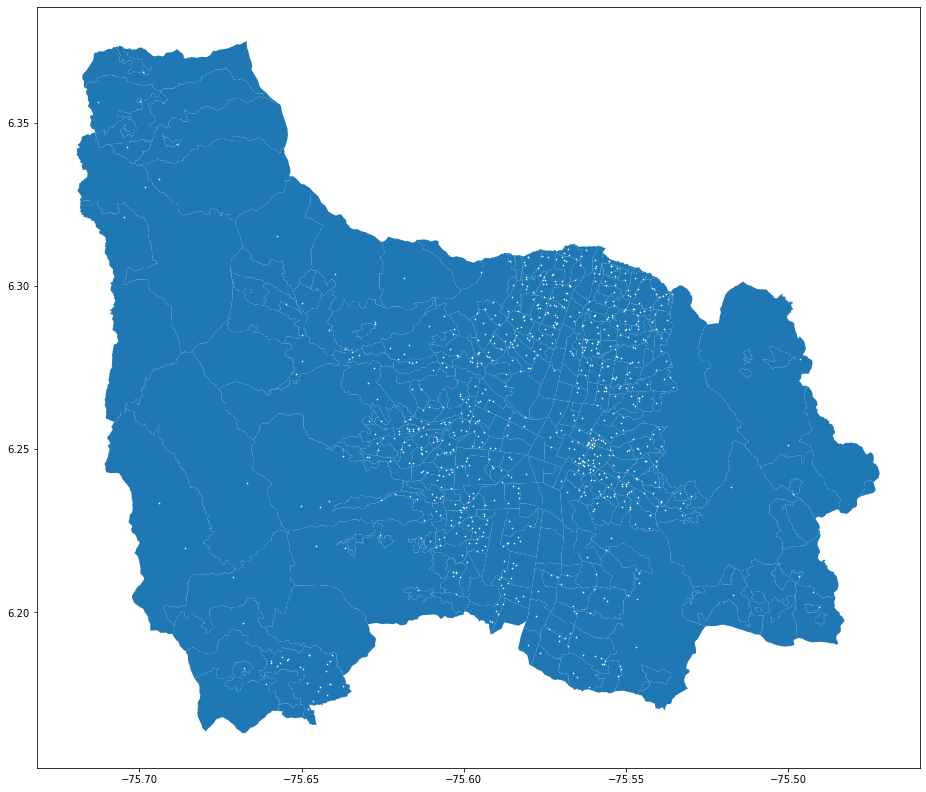

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Cantidad por barrio**

###**Hoteles**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Hoteles.shp')
dummy.head()

,OBJECTID,NOMBRE,DIRECCION,CATEGORIA,TEL,FAX,GERENTE,LINK,HABITACION,ESTRELLAS,RULEID,NIT,ESTADO,RNT,ID,geometry
0,577,NORMANDIA,CL 53 49 100,HOTEL,2512296,None,LUIS FERNANDO LOBO,hotelnrmandia@hotmail.com,0,0,1,13360239-4,ACTIVO,11308,83,POINT (835239.690 1183352.532)
1,578,MARACAIBO REAL,CL 53 49 64,HOTEL,5129197,None,ELPIDIA ZULUAGA,None,0,0,1,13360239-4,ACTIVO,12744,84,POINT (835261.283 1183338.597)
2,579,JUNIMAR,CL 53 49 80,HOTEL,512527,2316595,MARGARITA PÉREZ,None,0,0,1,39715924,CANCELADO,11893,85,POINT (835251.881 1183344.822)
3,580,LA BELLA VILLA,CL 53 50 28,HOTEL,None,None,ELIZABETH RESTREPO,None,0,0,1,1127276044-0,SUSPENDIDO,11571,86,POINT (835154.665 1183404.901)
4,581,SANTELMO,CL 53 50A 8,APARTA HOTEL,2313144,None,JULIO CESAR SALAZAR ECHEVERRI,None,0,0,2,800052538-5,ACTIVO,12295,35,POINT (835118.400 1183427.484)


In [ ]:
dummy.columns

Index(['OBJECTID', 'NOMBRE', 'DIRECCION', 'CATEGORIA', 'TEL', 'FAX', 'GERENTE',
       'LINK', 'HABITACION', 'ESTRELLAS', 'RULEID', 'NIT', 'ESTADO', 'RNT',
       'ID', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

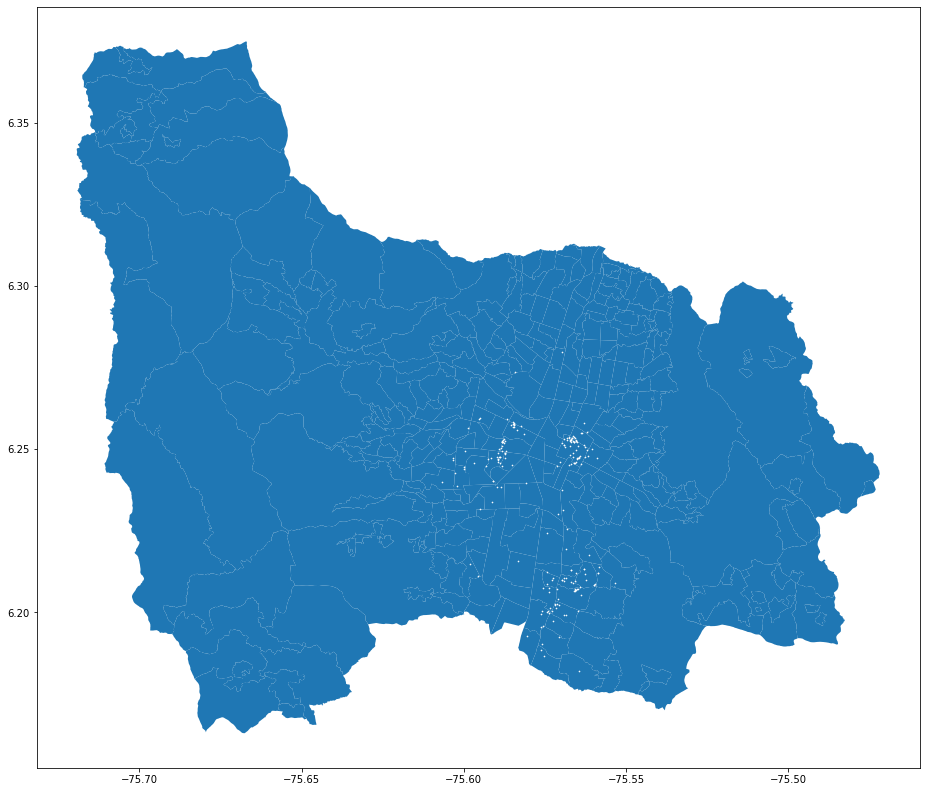

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

**Cantidad por barrio**

###**estratificacion**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/estratificacion.shp')
dummy.head()

,OBJECTID,COMUNA,BARRIO,CODIGO_BAR,MANZANA,ESTRATO,SHAPE_AREA,SHAPE_LEN,geometry
0,26488,15,01,1501,1501004,3,2.849957,7.279840,"POLYGON ((832508.758 1178003.917, 832508.092 1..."
1,26489,15,01,1501,1501004,3,2.850107,7.280048,"POLYGON ((832489.925 1178003.422, 832487.895 1..."
2,26490,15,01,1501,1501004,3,22.799985,28.679315,"POLYGON ((832467.097 1177997.375, 832465.068 1..."
3,26491,15,01,1501,1501004,3,2.849617,7.279701,"POLYGON ((832506.063 1178004.451, 832505.397 1..."
4,26492,15,01,1501,1501004,3,2.850115,7.280213,"POLYGON ((832484.534 1178004.491, 832483.869 1..."


In [ ]:
dummy.columns

Index(['OBJECTID', 'COMUNA', 'BARRIO', 'CODIGO_BAR', 'MANZANA', 'ESTRATO',
       'SHAPE_AREA', 'SHAPE_LEN', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

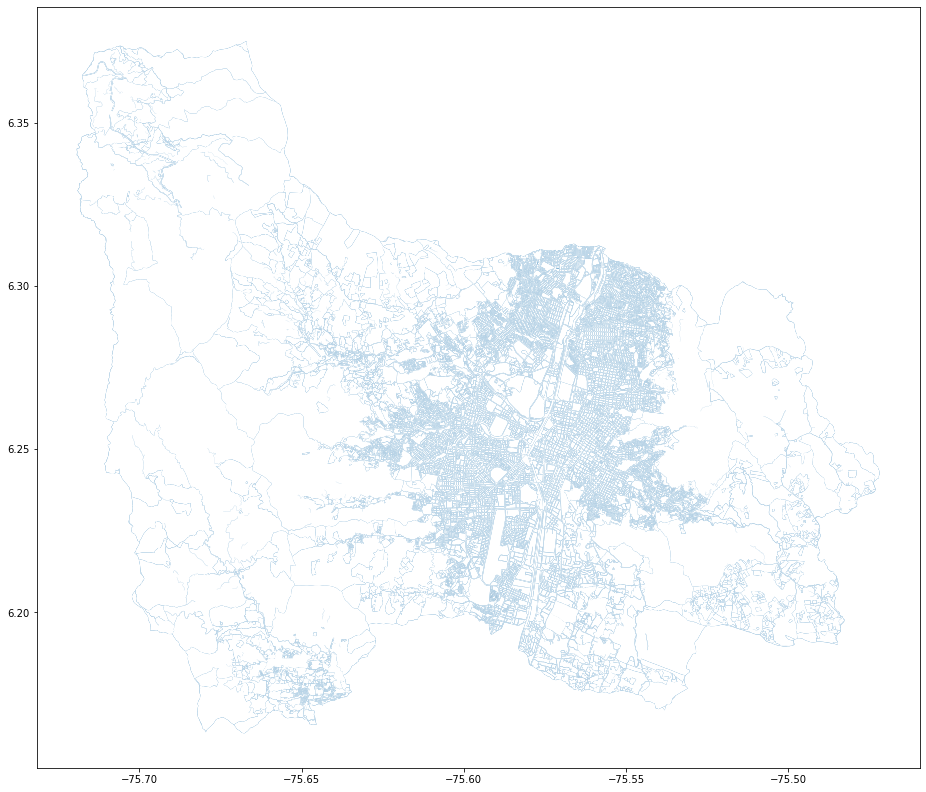

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "white",markersize =0.4)

variable categorica, me sirve

###**Estaciones_metro**


In [98]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Estaciones_metro.shp')
dummy.head()

,OBJECTID,NOMBRE,LINEA,RULEID,ESTADO,TIPO,geometry
0,145,El Molino,Línea 1,4,1,4,POINT (837936.869 1181518.822)
1,146,Bicentenario,Línea TA,4,1,4,POINT (836060.262 1182447.263)
2,147,Loyola,Línea TA,4,1,4,POINT (837561.157 1181907.355)
3,148,Alejandro Echavarría,Línea TA,4,1,4,POINT (838117.964 1181252.903)
4,149,Pabellón del Agua EPM,Línea TA,4,1,4,POINT (835695.867 1182628.401)


In [99]:
dummy.columns

Index(['OBJECTID', 'NOMBRE', 'LINEA', 'RULEID', 'ESTADO', 'TIPO', 'geometry'], dtype='object')

In [100]:
dummy.crs

<Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [101]:
dummy= dummy.to_crs("EPSG:4326")

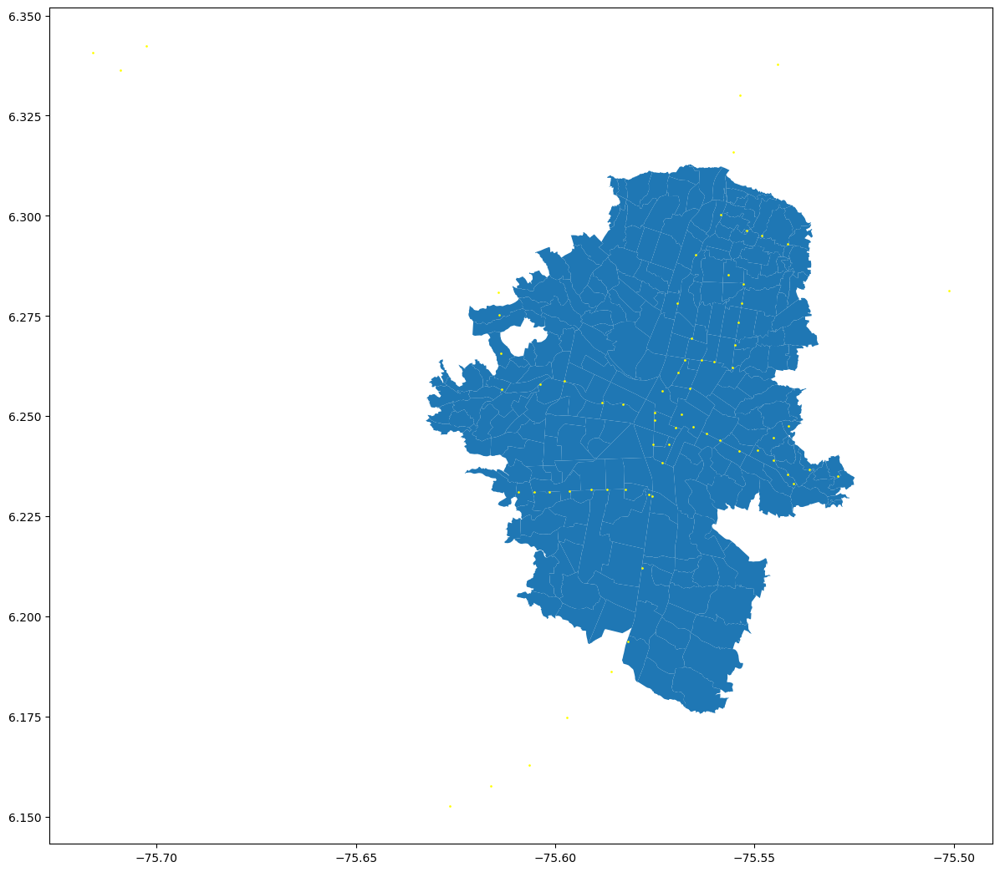

In [112]:
axis = mede_shp.plot(figsize=(17,13))
dummy.plot(ax=axis, color = "yellow",markersize =0.9);

Cantidad o cercanía. Mirar si existe uno mas actualizado

###**Estacion_encicla**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Estacion_encicla.shp')
dummy.head()

,OBJECTID,ITEM,COBAMA,CBMC,ANCHO,LARGO,COMUNA,BARRIO,OBSERVACIO,BUFFER_MOD,BUFFER_REL,FECHA,SHAPE_AREA,SHAPE_LEN,geometry
0,1,567,1107038,110703801,2.80,10.55,Laureles Estadio,Bolivariana,None,4.0,4.0,2018-02-27,29.540339,26.700462,"POLYGON ((832757.540 1183014.712, 832757.204 1..."
1,2,2736,1108026,110802602,3.57,18.86,Laureles Estadio,Laureles,None,4.0,4.0,2017-12-10,67.330421,44.860038,"POLYGON ((831843.570 1182240.582, 831847.132 1..."
2,3,2733,1108026,110802602,9.70,2.44,Laureles Estadio,Laureles,None,4.0,4.0,2017-12-10,23.667711,24.279900,"POLYGON ((831847.132 1182240.817, 831843.570 1..."
3,4,1393,1506001,150600102,2.11,14.47,Belén,Parque Juan Pablo II,girada con franja amoblamiento. 5 modulos. 2 g...,4.0,4.0,2017-11-26,30.531921,33.160057,"POLYGON ((832252.038 1179309.250, 832253.679 1..."
4,5,247,1604021,160402104,2.90,2.00,Belén,Granada,Modulo de encicla,4.0,4.0,2017-11-26,5.799921,9.799971,"POLYGON ((832430.343 1181054.002, 832430.414 1..."


In [ ]:
dummy.columns

Index(['OBJECTID', 'ITEM', 'COBAMA', 'CBMC', 'ANCHO', 'LARGO', 'COMUNA',
       'BARRIO', 'OBSERVACIO', 'BUFFER_MOD', 'BUFFER_REL', 'FECHA',
       'SHAPE_AREA', 'SHAPE_LEN', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy['centroid']=dummy.centroid

<ipython-input-234-51ee35688c86>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  dummy['centroid']=dummy.centroid


In [ ]:
dummy= dummy.to_crs("EPSG:4326")

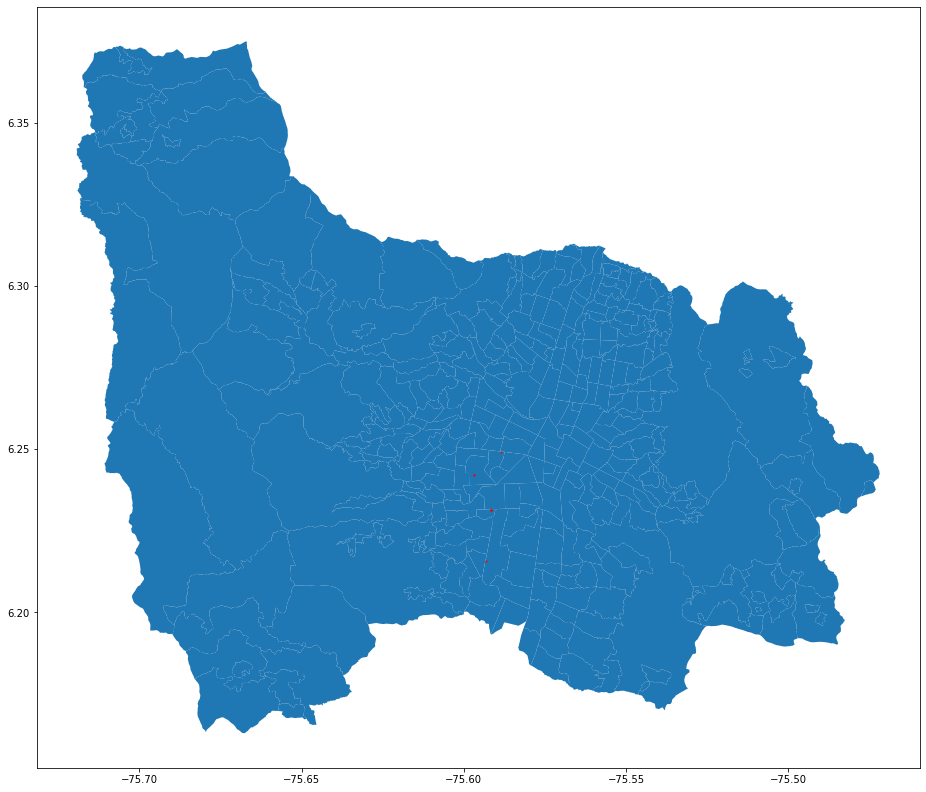

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy['centroid'].plot(ax=axis, color = "red",markersize =1)

No me funciona

###**Establecimiento_comercial**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Establecimiento_comercial.shp')
dummy.head()

,geometry
0,POINT (834294.037 1179866.866)
1,POINT (831801.125 1181131.784)
2,POINT (835211.873 1183367.350)
3,POINT (831361.242 1177903.182)
4,POINT (837901.252 1183548.953)


In [ ]:
dummy.columns

Index(['geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

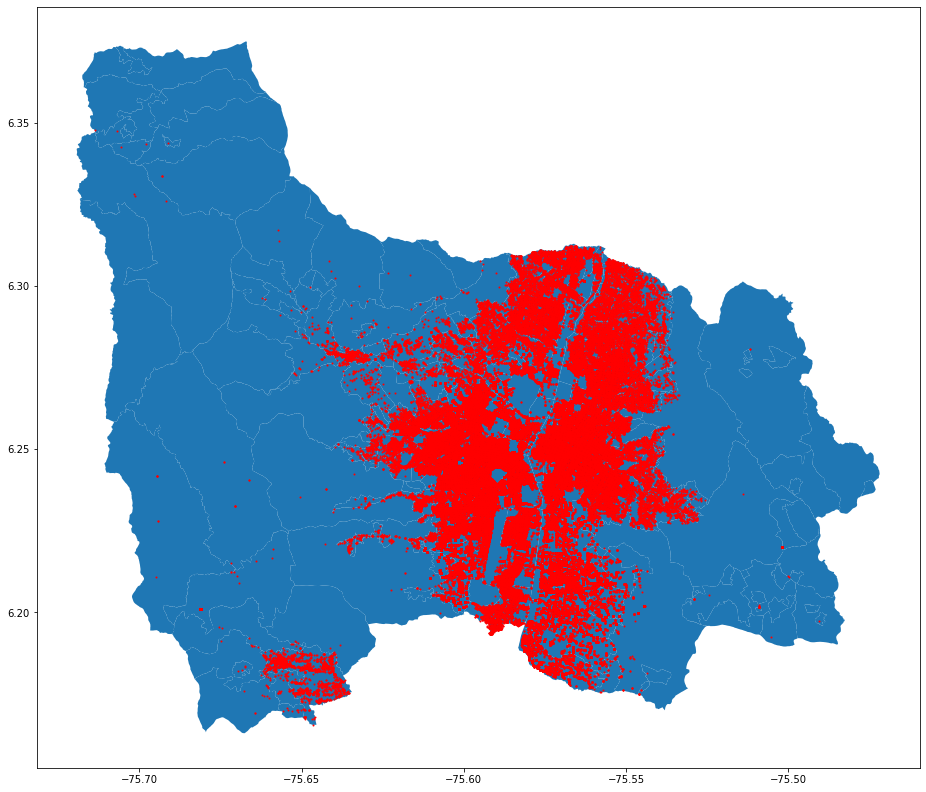

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Cantidad

###**Espacio_publico**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Espacio_publico.shp')
dummy.head()

,OBJECTID,CODIGO,CODIGO_TAL,CODIGO_OBR,CODIGO_BIE,PROCEDENCI,NOMBRE,CBML,ZONA,CODIGO_COM,...,LICENCIA_O,NUMERO_RES,APROVECHAM,CONTRATO_A,ALTERNATIV,PLANO_USOS,INDICADOR,SHAPE_AREA,SHAPE_LEN,geometry
0,5820,056521001001,EP_10_P_13,056521001001,None,None,BULEVAR BOLIVAR,No Posee,Z3,1001,...,No,-,No,-,-,Si,Si,2873.653901,465.999665,"POLYGON ((835267.512 1183967.545, 835350.835 1..."
1,5821,056513000001,EP_10_P_14,056513000001,None,None,ATRIO PARROQUIA EL ESPIRITU SANTO,No Posee,Z3,1001,...,No,-,No,-,-,Si,Si,126.942366,144.213617,"POLYGON ((835515.891 1184189.648, 835574.661 1..."
2,5822,056521007001,EP_10_P_15,056521007001,None,None,PLAZUELA HOSPITAL Y CRUCE VIAL.,No Posee,Z3,1001,...,No,-,No,-,7,Si,Si,1907.401949,226.445078,"POLYGON ((835622.034 1184667.263, 835622.678 1..."
3,5827,056520406001,EP_10_P_18,056520406001,None,None,Plazoleta Metro,10010730001,Z3,1001,...,No,-,No,-,7,Si,Si,382.072604,90.905570,"POLYGON ((835555.419 1184568.053, 835540.509 1..."
4,5832,056517000005,EP_10_P_17,056517000005,None,None,Zona Verde Vial,No Posee,Z3,1001,...,No,-,No,-,7,Si,Si,995.104274,1223.633555,"MULTIPOLYGON (((835857.130 1184612.171, 835856..."


In [ ]:
dummy.columns

Index(['geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

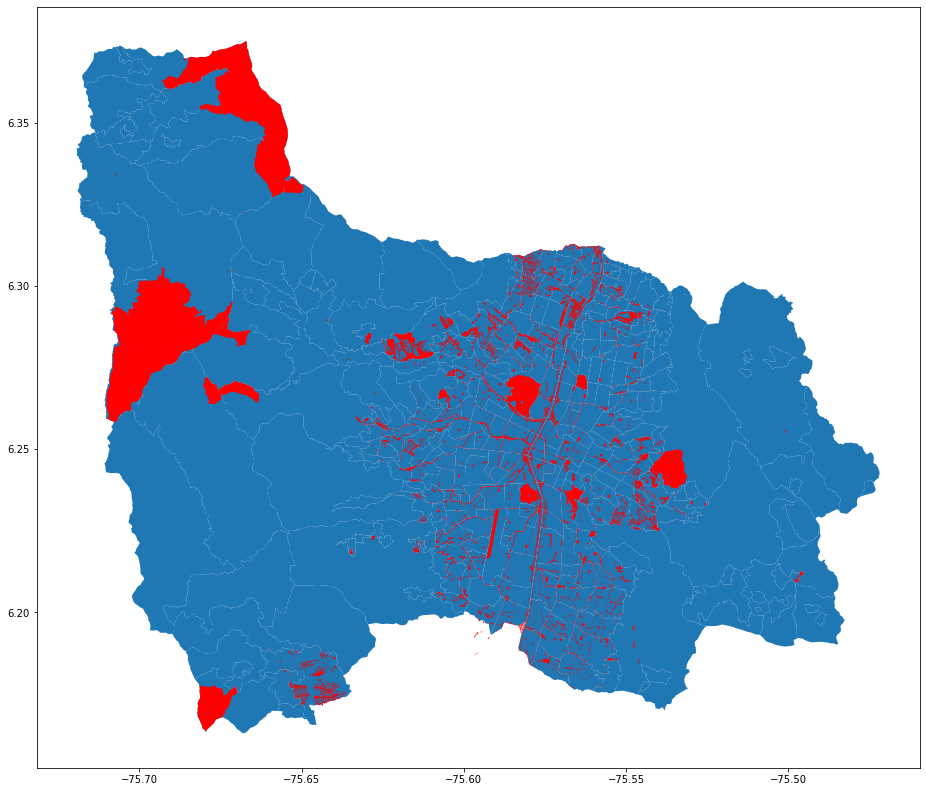

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Buscar información acerca de esto, que significa

###**Escenarios_deportivos**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Escenarios_deportivos.shp')
dummy.head()

,OBJECTID,ID,COD_DEFINI,NOMBRE,NOMBRE_EQU,TIPOLOGIA_,DIRECCION,CBML,COD_TIPOLO,TIPOLOGIA1,...,COD_BARRIO,NOMBRE_BAR,HORARIO,LINK_FOTO,LINK_DETAL,X_MAGNAMED,Y_MAGNAMED,LATITUD,LONGITUD,geometry
0,1,1.0,01_02_05,CANCHA POLIDEPORTIVA CARPINELO,NA,BARRIAL,CR 26C CL 97A,01120080033,1.0,CANCHA POLIDEPORTIVA,...,0112,Carpinelo,None,None,None,837992.6961,1.187208e+06,6.286986,-75.541269,POINT (837992.696 1187207.874)
1,2,2.0,01_03_01,GIMNASIO AL AIRE LIBRE CARPINELO,NA,BARRIAL,CR 26C CL 97A,01120080033,14.0,GIMNASIO AL AIRE LIBRE,...,0112,Carpinelo,None,None,None,837987.4752,1.187187e+06,6.286796,-75.541316,POINT (837987.475 1187186.811)
2,3,3.0,01_02_06,CANCHA POLIDEPORTIVA DIVINA PROVIDENCIA,NA,BARRIAL,CL 108 CR 43B,01030110001,1.0,CANCHA POLIDEPORTIVA,...,0103,Popular,None,None,None,837154.2567,1.188302e+06,6.296877,-75.548844,POINT (837154.257 1188301.922)
3,4,4.0,01_03_03,GIMNASIO AL AIRE LIBRE DIVINA PROVIDENCIA,NA,BARRIAL,CL 108 CR 43B,01030110001,14.0,GIMNASIO AL AIRE LIBRE,...,0103,Popular,None,None,None,837155.3843,1.188300e+06,6.296856,-75.548834,POINT (837155.384 1188299.579)
4,5,5.0,01_04_05,LUDOTEKA POPULAR DIVINA PROVIDENCIA,NA,BARRIAL,CL 107E CR 43 - 35,01030040055,31.0,LUDOTEKA INTERACTIVA,...,0103,Popular,None,None,None,837138.7970,1.188285e+06,6.296725,-75.548984,POINT (837138.797 1188285.063)


In [ ]:
dummy.columns

Index(['geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

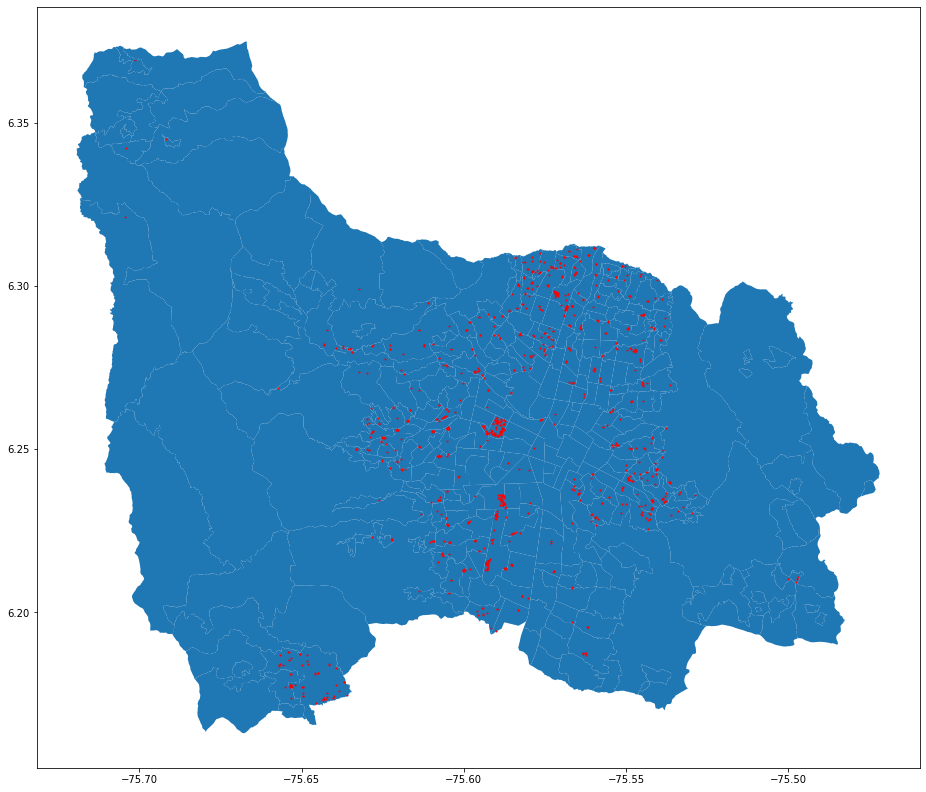

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Cantidad o cercanía

###**Convive_la_noche**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Convive_la_noche.shp')
dummy.head()

,NOMBRE_DEL,DIRECCIÓN,COMUNA,HORARIO,CODIGO,BARRIO,COMUNA1,x,y,geometry
0,ABEYMAR (Nuevo),CLL 106 # 32 A-97 INT. 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837752.68,1187940.93,POINT (837752.680 1187940.930)
1,BAR CANELA,CL 106A 33A 26,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837774.26,1187962.83,POINT (837774.260 1187962.830)
2,BAR LOS RELICARIOS,CR 46 109 54,1.0,2:00 a.m,0103,Popular,01,837102.37,1188576.12,POINT (837102.370 1188576.120)
3,BAR SEVEN NIGHT,CL 106 32A 87 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837780.50,1187934.20,POINT (837780.500 1187934.200)
4,BILLAR CALICHE DE SANTO DOMINGO,CR 30 111 02,1.0,2:00 a. m.,0102,Santo Domingo Savio No.2,01,837878.13,1188631.24,POINT (837878.130 1188631.240)


In [ ]:
dummy.columns

Index(['NOMBRE_DEL', 'DIRECCIÓN', 'COMUNA', 'HORARIO', 'CODIGO', 'BARRIO',
       'COMUNA1', 'x', 'y', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

In [ ]:
dummy.iloc[:-2]

,NOMBRE_DEL,DIRECCIÓN,COMUNA,HORARIO,CODIGO,BARRIO,COMUNA1,x,y,geometry
0,ABEYMAR (Nuevo),CLL 106 # 32 A-97 INT. 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837752.68,1187940.93,POINT (-75.54344 6.29361)
1,BAR CANELA,CL 106A 33A 26,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837774.26,1187962.83,POINT (-75.54324 6.29381)
2,BAR LOS RELICARIOS,CR 46 109 54,1.0,2:00 a.m,0103,Popular,01,837102.37,1188576.12,POINT (-75.54931 6.29936)
3,BAR SEVEN NIGHT,CL 106 32A 87 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837780.50,1187934.20,POINT (-75.54319 6.29355)
4,BILLAR CALICHE DE SANTO DOMINGO,CR 30 111 02,1.0,2:00 a. m.,0102,Santo Domingo Savio No.2,01,837878.13,1188631.24,POINT (-75.54230 6.29985)
...,...,...,...,...,...,...,...,...,...,...
1120,TABERNA TROPICAL LICOR,CR 82 41 SUR 59,80.0,4:00 a.m,AUC2,San Antonio de Prado,80,825025.96,1175916.29,POINT (-75.65841 6.18490)
1121,TABERNA-PIZZERIA MAIZ TRILLADO,CL 42 SUR 81 04,80.0,4:00 a.m,AUC2,San Antonio de Prado,80,825116.45,1175906.74,POINT (-75.65759 6.18481)
1122,TATOS BAR,CR 79 42 SUR 26 LC 107,80.0,4:00 a. m.,AUC2,San Antonio de Prado,80,825281.88,1175841.74,POINT (-75.65609 6.18422)
1123,TIENDA MIXTA BRISAS DEL RIO(NUEVO),CRA 60D#38Sur-12,80.0,2:00 a. m.,AUC2,San Antonio de Prado,80,826978.30,1176035.40,POINT (-75.64077 6.18598)


In [ ]:
sjoin(mede_shp,dummy)

,OBJECTID,CODIGO_left,COMUNA_left,BARRIO_left,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,...,index_right,NOMBRE_DEL,DIRECCIÓN,COMUNA_right,HORARIO,CODIGO_right,BARRIO_right,COMUNA1,x,y
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,...,980,FONDA LA BOOOMBA,CR 52 11SUR 21,15.0,4:00 a. m.,1511,La Colina,15,832619.74,1177426.32
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,...,986,PARILLA BAR JALISCO,CL 10SUR 52 02,15.0,2:00 a. m.,1511,La Colina,15,832676.29,1177541.36
4,6757,1511,15,11,La Colina,6,U,GUAYABAL,689537.432617,4825.014239,...,981,LICOFER (NUEVO) SOLO VENTA,CLL 9 SUR 53 09,15.0,2:00 a. m.,1511,La Colina,15,832533.56,1177766.47
5,6758,1113,11,13,El Estadio,4,U,LAURELES,365142.314453,2636.136878,...,623,BAR Y LICORES LICOEXPRESS EL ATANASIO,CR 74 48A 09,11.0,4:00 a.m,1113,Estadio,11,832393.76,1183961.44
5,6758,1113,11,13,El Estadio,4,U,LAURELES,365142.314453,2636.136878,...,635,CASINO COPACABANA,CR 80 48B 02,11.0,4:00 a.m,1113,Estadio,11,831791.31,1184237.74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
335,7088,1108,11,08,Laureles,4,U,LAURELES,721475.017578,3959.067927,...,655,DRINK SPORTS,TV 39B 70 207,11.0,4:00 a.m,1108,Laureles,11,832427.23,1182104.01
335,7088,1108,11,08,Laureles,4,U,LAURELES,721475.017578,3959.067927,...,688,LA GUAYABA TIENDA MIXTA,TV 39B 70 215,11.0,4:00 a.m,1108,Laureles,11,832422.23,1182110.01
335,7088,1108,11,08,Laureles,4,U,LAURELES,721475.017578,3959.067927,...,630,BODEGA BBC LAURELES,CL 74B 39B 90,11.0,4:00 a.m,1108,Laureles,11,832026.14,1182706.74
335,7088,1108,11,08,Laureles,4,U,LAURELES,721475.017578,3959.067927,...,1008,DISTRILICORES BULERIAS,CL 33 74B 13,16.0,4:00 a. m.,1108,Laureles,11,832559.11,1181928.02


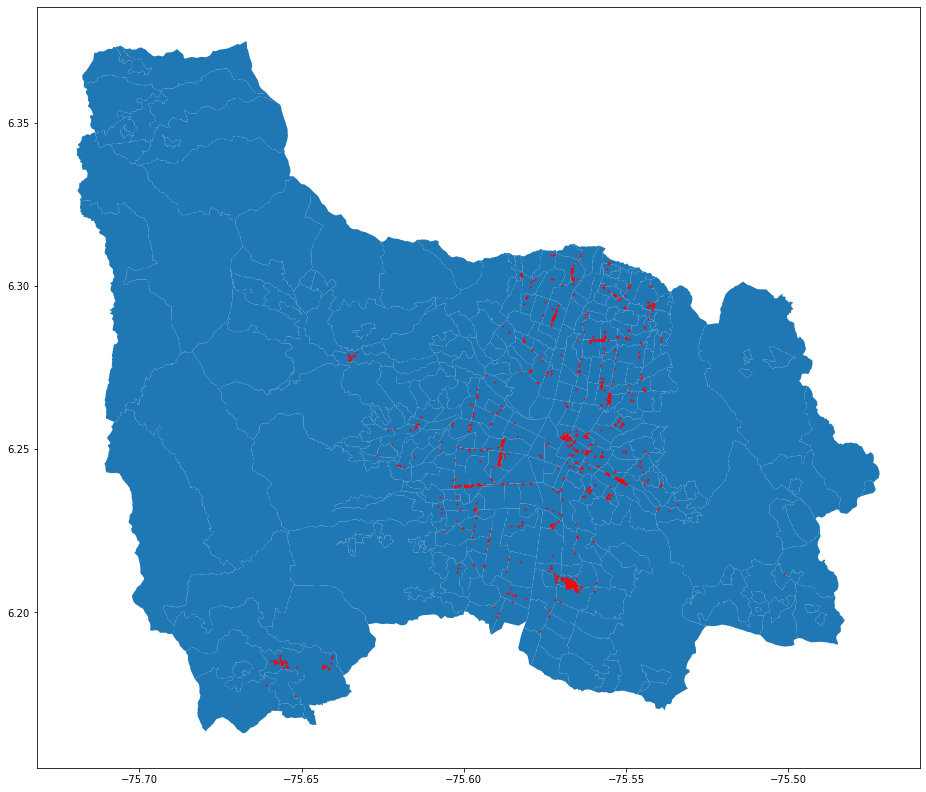

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
sjoin(dummy, mede_shp).plot(ax=axis, color = "red",markersize =1)

Realizar el conteo

###**Cicloruta**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Cicloruta.shp')
dummy.head()

,OBJECTID,PROYECTO,SYMBOL,FECHA,PK_CUE,RULEID,SHAPE_LEN,geometry
0,102,None,2,None,0.0,1,3.112933,"LINESTRING Z (832829.740 1183580.613 1473.910,..."
1,103,None,2,None,0.0,1,8.790008,"LINESTRING Z (832825.845 1183583.608 1474.092,..."
2,104,None,2,None,0.0,1,28.829002,"LINESTRING Z (832787.930 1183577.394 1474.320,..."
3,105,None,2,None,0.0,1,158.629358,"LINESTRING Z (832793.565 1183262.318 1475.305,..."
4,106,None,2,None,0.0,1,59.501435,"LINESTRING Z (832232.915 1183162.538 1488.268,..."


In [ ]:
dummy.columns

Index(['OBJECTID', 'PROYECTO', 'SYMBOL', 'FECHA', 'PK_CUE', 'RULEID',
       'SHAPE_LEN', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

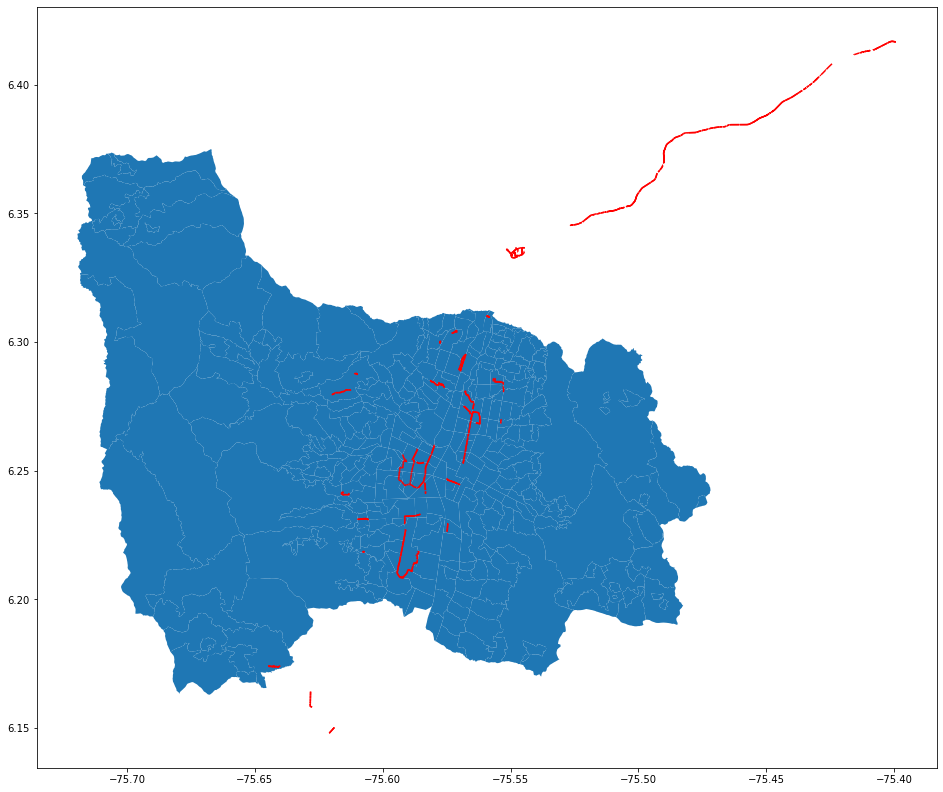

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

No va funcionar tanto


###**Centros_comerciales**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Centros_comerciales.shp')
dummy.head()

,OBJECTID,NOMBRE,DIRECCION,LINK_FOTO,LINK_DETAL,CREDITOS_F,ID,LABEL,geometry
0,1,Centro Comercial Villanueva,Carrera 47 52 86,None,None,None,1,C.C. Villanueva,POINT (835450.924 1183702.952)
1,2,Centro Comercial La Strada,Carrera 43A 1Sur 150,None,None,None,2,C.C. La Strada,POINT (834608.972 1177807.245)
2,3,Centro Comercial Los Molinos,Calle 30A 82A 26,None,None,None,3,C.C. Los Molinos,POINT (831000.770 1181150.205)
3,4,Centro Comercial Monterrey,Carrera 48 10 45,None,www.monterrey.com.co,None,4,C.C. Monterrey,POINT (834075.428 1179130.732)
4,5,Centro Comercial Oviedo,Carrera 43A 6Sur 15,None,https://www.oviedo.com.co,None,5,C.C. Oviedo,POINT (834309.314 1177497.958)


In [ ]:
dummy.columns

Index(['OBJECTID', 'NOMBRE', 'DIRECCION', 'LINK_FOTO', 'LINK_DETAL',
       'CREDITOS_F', 'ID', 'LABEL', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

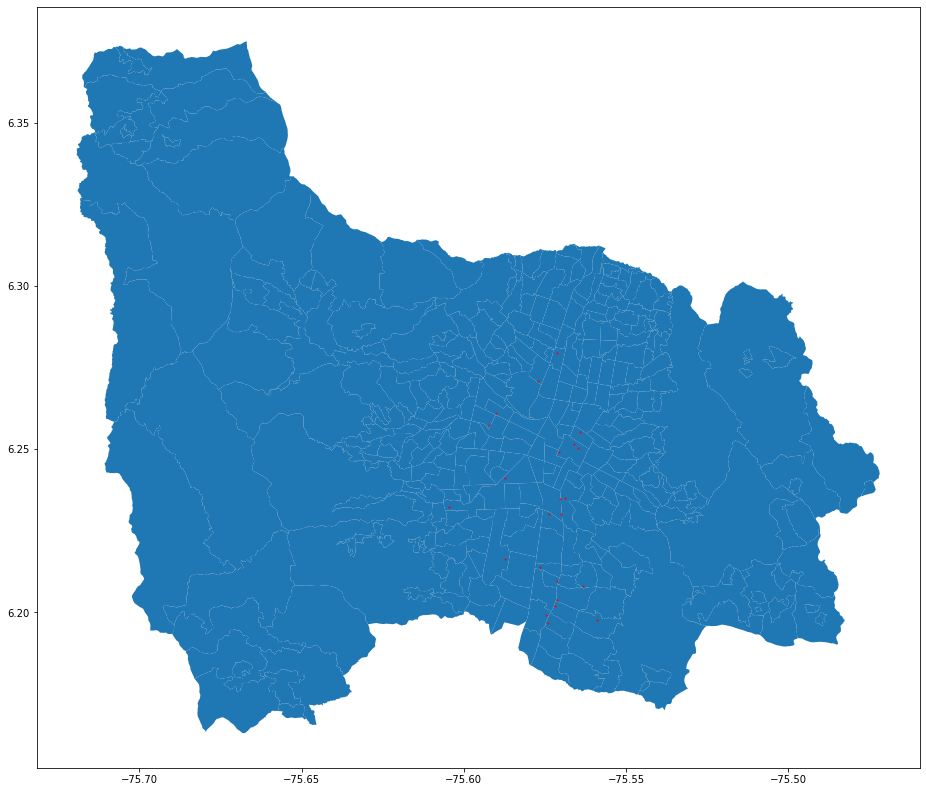

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Puede ser cercanía

###**centro_acopio**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/centro_acopio.shp')
dummy.head()

,OBJECTID,DIRECCION,TIPO,COORD_X,COORD_Y,NOMBRE,geometry
0,1,Calle 55 # 73,CATE,832980.9149,1.184684e+06,La Iguaná,POINT (832980.915 1184684.442)
1,2,Calle 59A # 35 - 55,CATE,836739.7235,1.183162e+06,La Ladera,POINT (836739.723 1183161.620)
2,3,Calle 47 # 87A,CATE,831033.6639,1.183910e+06,Santa Lucía,POINT (831033.664 1183910.289)
3,4,None,Centro de Acopio,835154.7144,1.183897e+06,Bazar de los Puentes,POINT (835154.714 1183896.667)
4,5,None,Centro de Acopio,834500.9731,1.180495e+06,Barrio Colombia,POINT (834500.973 1180495.322)


In [ ]:
dummy.columns

Index(['OBJECTID', 'DIRECCION', 'TIPO', 'COORD_X', 'COORD_Y', 'NOMBRE',
       'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

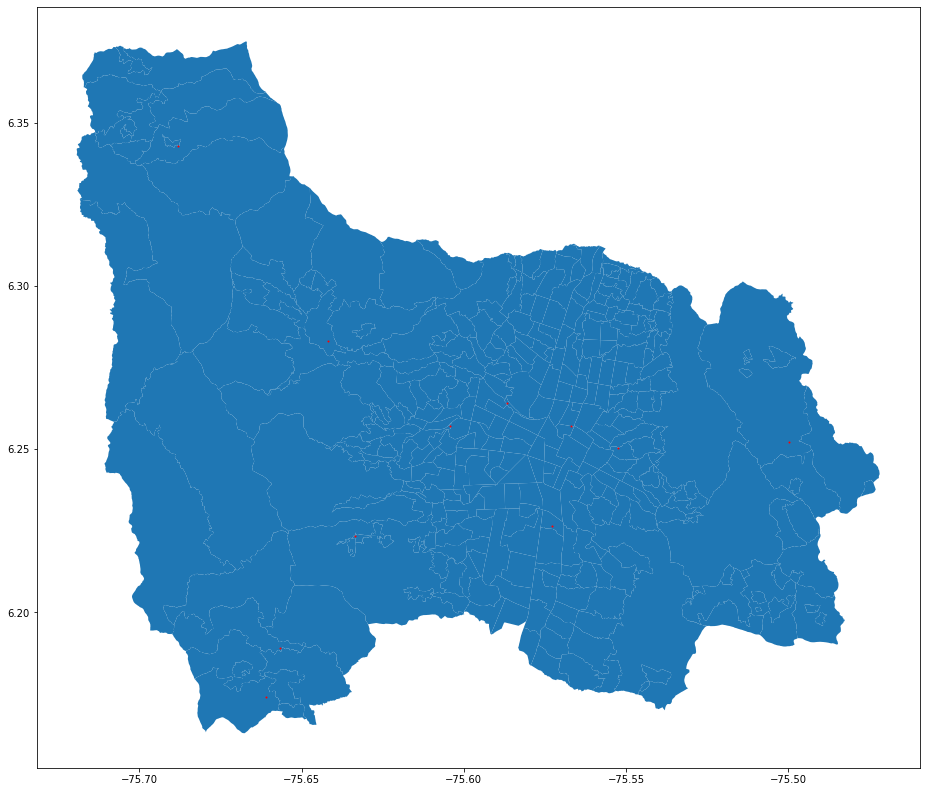

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

In [ ]:
dummy.shape

(11, 7)

Muy pocos valores

###**Camaras**


In [93]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Camaras.shp')
dummy.head()

,ID_PVV,Tipo,Año,Estado,COD_BAR,BARRIO,COMUNA,X,Y,geometry
0,472,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833850.116704,1.182219e+06,POINT (833850.117 1182218.615)
1,473,PVV Cámara FIJA,2017.0,Fuera de servicio,1105,Los Conquistadores,11.0,833839.048021,1.182230e+06,POINT (833839.048 1182229.677)
2,474,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833830.194390,1.182293e+06,POINT (833830.194 1182292.726)
3,475,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833811.377148,1.182291e+06,POINT (833811.377 1182290.514)
4,476,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833810.271068,1.182324e+06,POINT (833810.271 1182323.698)


In [94]:
dummy.columns

Index(['ID_PVV', 'Tipo', 'Año', 'Estado', 'COD_BAR', 'BARRIO', 'COMUNA', 'X',
       'Y', 'geometry'],
      dtype='object')

In [95]:
dummy.crs

<Projected CRS: PROJCS["PCS_MAG_Ant_Medellin",GEOGCS["GCS_MAG_Ant_ ...>
Name: PCS_MAG_Ant_Medellin
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: D_DAT_MAG_Ant_Medellin
- Ellipsoid: GRS1980_MAG_Ant_Medellin
- Prime Meridian: Greenwich

In [96]:
dummy= dummy.to_crs("EPSG:4326")

<Axes: >

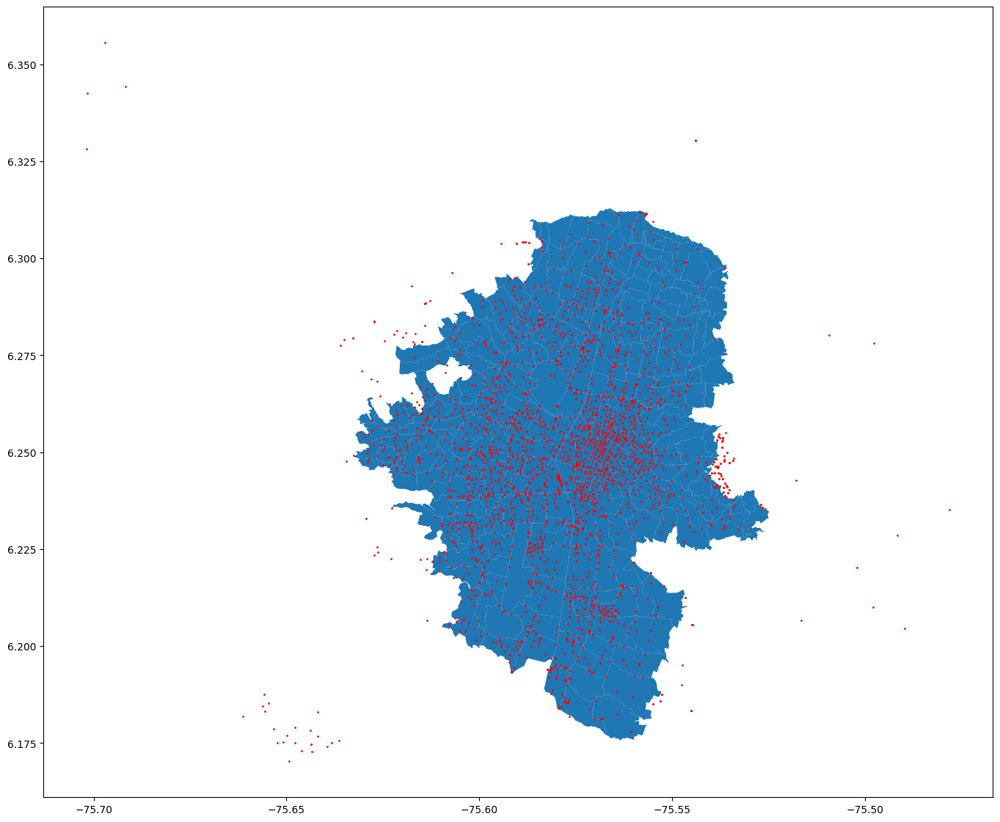

In [97]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)



Cantidad

###**Bibliotecas**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Bibliotecas.shp')
dummy.head()

,OBJECTID,UBICACION,NOMBRE,TELEFONO,TIPO,COMUNA,BARRIO,HORARIO,LABEL,X_COORD,Y_COORD,LINK_FOTO,CREDITOS_F,LINK_DETAL,CORREO,geometry
0,1,CL 50 43 64,Archivo Histórico de Medellín,385 73 46 / 512 65 47,ARCHIVO HISTÓRICO,La Candelaria,La Candelaria,Lunes a jueves: 7:30 am-12:00 m y 1:30-5:30 pm...,Archivo Histórico de Medellín,835543.7151,1.182855e+06,None,None,http://bibliotecasmedellin.gov.co/archivo-hist...,archivo.historico@medellin.gov.co,POINT (835543.716 1182854.746)
1,2,CR 43 118 26 piso 3,Biblioteca Pública Popular No.2,236 03 16 / 522 00 38,BIBLIOTECA DE PROXIMIDAD,Popular,Popular,Lunes a viernes: 9:00 am - 6:00 pm. Sábado: 9:...,Biblioteca Pública Popular No.2,837338.2142,1.188890e+06,None,None,http://bibliotecasmedellin.gov.co/biblioteca-p...,popular2@bibliotecasmedellin.gov.co,POINT (837338.215 1188890.175)
2,3,CR 80 104 04,"Parque Biblioteca Gabriel García Márquez, Doce...",477 67 27,PARQUE BIBLIOTECA,Doce de Octubre,Santander,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,Gabriel García Márquez - Doce de Octubre,833956.3085,1.189135e+06,None,None,http://bibliotecasmedellin.gov.co/parque-bibli...,docedeoctubre@bibliotecasmedellin.gov.co,POINT (833956.309 1189135.458)
3,4,CR 65 14 115,"Parque Biblioteca Manuel Mejía Vallejo, Guayabal",351 04 95 / 351 29 66,PARQUE BIBLIOTECA,Guayabal,Santa Fe,Lunes a sábado: 8:00 am - 7:00 pm. Domingos y ...,Manuel Mejía Vallejo - Guayabal,833011.5805,1.179833e+06,None,None,http://bibliotecasmedellin.gov.co/parque-bibli...,guayabal@bibliotecasmedellin.gov.co,POINT (833011.581 1179833.015)
4,5,CR 4C 6 206,"Parque Biblioteca José Horacio Betancur, San A...",286 29 77 / 286 54 24,PARQUE BIBLIOTECA,Corregimiento de San Antonio de Prado,Área de Expansión San Antonio de Prado,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,José Horacio Betancur - San Antonio de Prado,825459.4690,1.174971e+06,None,None,http://bibliotecasmedellin.gov.co/parque-bibli...,sanantonio@bibliotecasmedellin.gov.co,POINT (825459.474 1174970.641)


In [ ]:
dummy.columns

Index(['OBJECTID', 'UBICACION', 'NOMBRE', 'TELEFONO', 'TIPO', 'COMUNA',
       'BARRIO', 'HORARIO', 'LABEL', 'X_COORD', 'Y_COORD', 'LINK_FOTO',
       'CREDITOS_F', 'LINK_DETAL', 'CORREO', 'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

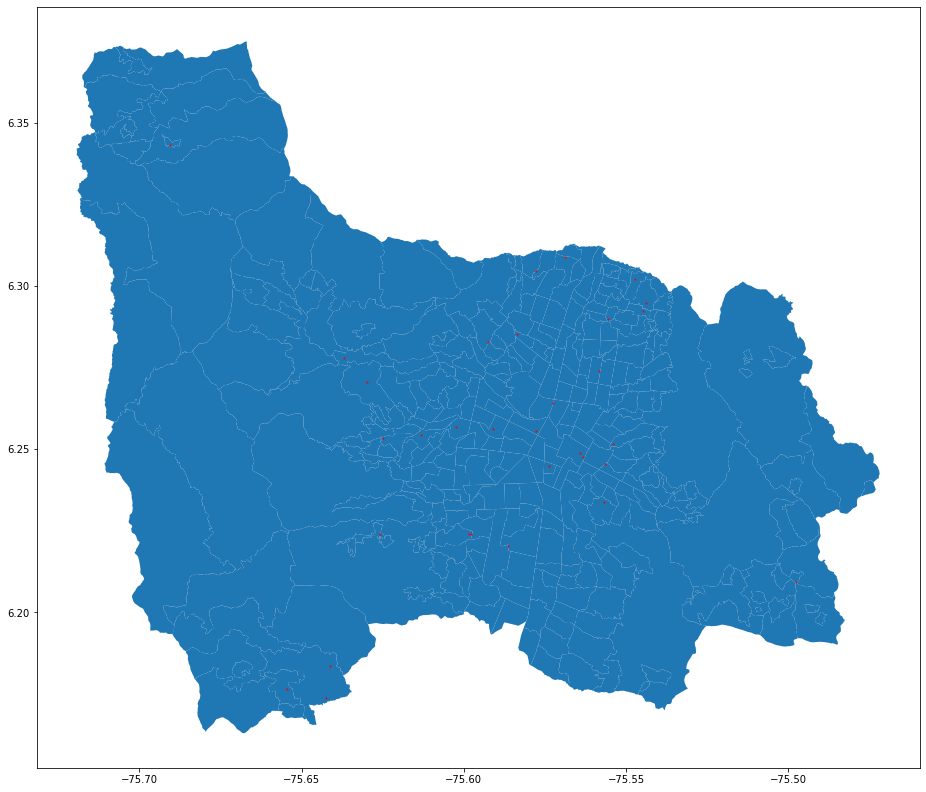

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Cercanía

###**basurera**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/basurera.shp')
dummy.head()

,OBJECTID,ITEM,COBAMA,CBMC,TIPO_MEP,ANCHO,LARGO,COMUNA,BARRIO,OBSERVACIO,BUFFER_MOD,BUFFER_REL,FECHA,geometry
0,83,924,1103007,110300703,1,0.37,0.37,La Candelaria,Naranjal,None,0.0,2.5,2018-02-27,POINT (832766.985 1183044.849)
1,84,929,1103007,110300703,1,0.37,0.37,La Candelaria,Naranjal,None,0.0,2.5,2018-02-27,POINT (832775.938 1183043.868)
2,85,934,1103007,110300703,7,0.35,0.35,La Candelaria,Naranjal,None,0.0,2.5,2018-02-27,POINT (832781.705 1183039.982)
3,86,945,1103007,110300703,7,0.35,0.35,La Candelaria,Naranjal,None,0.0,2.5,2018-02-27,POINT (832813.298 1183036.258)
4,87,968,1103007,110300703,7,0.35,0.35,La Candelaria,Naranjal,None,0.0,2.5,2018-02-27,POINT (832919.517 1183027.206)


In [ ]:
dummy.columns

Index(['OBJECTID', 'ITEM', 'COBAMA', 'CBMC', 'TIPO_MEP', 'ANCHO', 'LARGO',
       'COMUNA', 'BARRIO', 'OBSERVACIO', 'BUFFER_MOD', 'BUFFER_REL', 'FECHA',
       'geometry'],
      dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

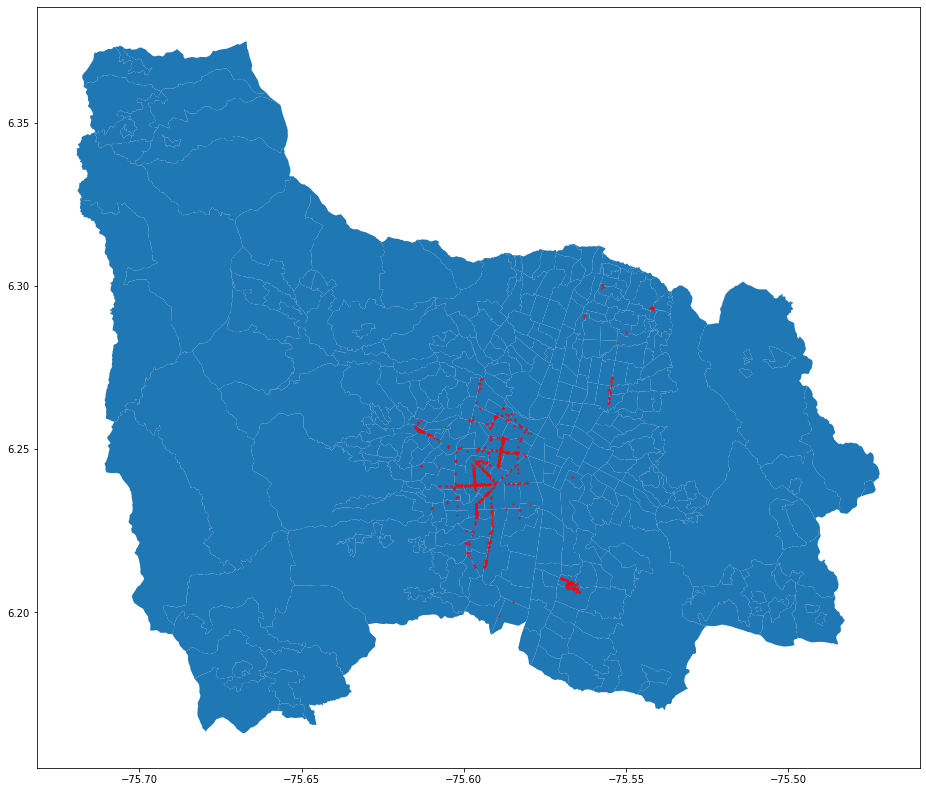

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Podríamos usar la cantidad de estos

###**Arbol**


In [ ]:
dummy = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Arbol.shp')
dummy.head()

,OBJECTID,PROYECTO,SYMBOL,FECHA,RULEID,geometry
0,226,None,1,None,1,POINT Z (829291.524 1186401.026 1846.232)
1,227,None,1,None,1,POINT Z (829298.409 1186408.776 1850.552)
2,228,None,1,None,1,POINT Z (829312.595 1186463.998 1857.752)
3,229,None,1,None,1,POINT Z (829234.054 1186526.111 1871.112)
4,230,None,1,None,1,POINT Z (829236.571 1186533.877 1870.712)


In [ ]:
dummy.columns

Index(['OBJECTID', 'PROYECTO', 'SYMBOL', 'FECHA', 'RULEID', 'geometry'], dtype='object')

In [ ]:
dummy.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
dummy= dummy.to_crs("EPSG:4326")

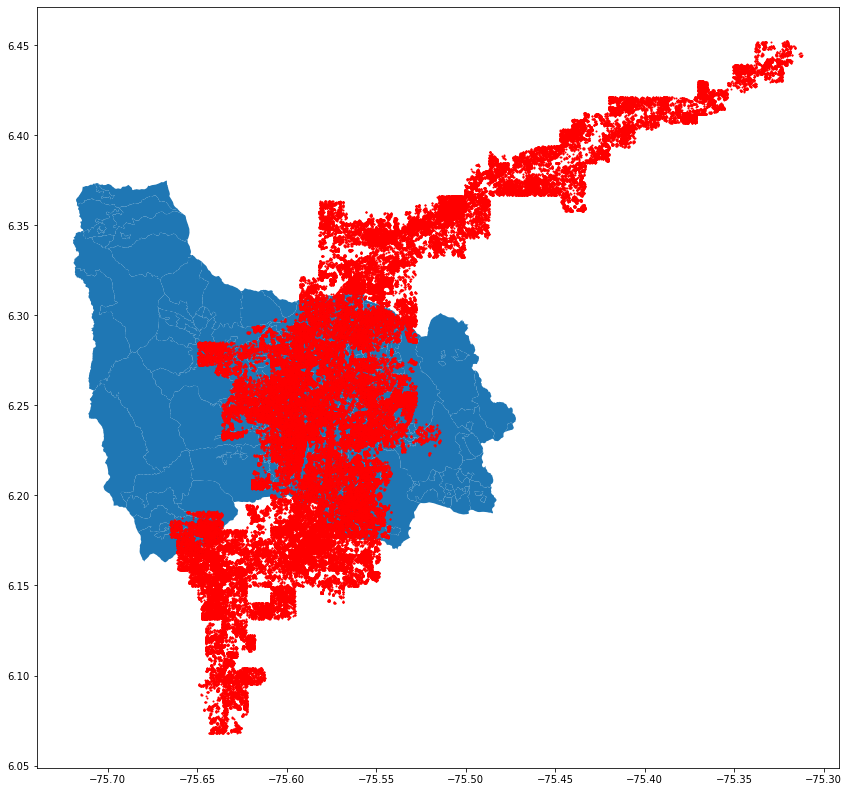

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
dummy.plot(ax=axis, color = "red",markersize =1)

Cantidad

## **Join entre las diferentes bases**

A continuación se harán los diferentes joins entre las sábanas encontradas con las características territoriales y el shapefile asociado a los barrios, de esta manera tendremos al finalizar el shapefile con características provenientes de conteos de las diferentes bases. Para esto haremos uso de la siguiente función

In [117]:
def countPunts(medellin_hurtos, shape_points, name_column):
  join_gdf = sjoin(medellin_hurtos,shape_points)
  df = pd.DataFrame(join_gdf.groupby('indice_man').count()['OBJECTID_l']).reset_index()
  df.rename(columns={'OBJECTID_l':name_column}, inplace=True)
  medellin_hurtos = medellin_hurtos.merge(df,how ='left', on='indice_man')
  medellin_hurtos[name_column] = medellin_hurtos[name_column].astype('Int64')
  return medellin_hurtos

###**Union venteros**

In [ ]:
mede_shp = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas.shp')
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,BARRIO,NOMBRE_BAR,SECTOR,INDICADOR_,NOMBRE_COM,SHAPE__Are,SHAPE__Len,indice_man,casos,geometry
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,02,Santo Domingo Savio No. 2,1,U,POPULAR,267945.791016,2904.091172,0,2,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034..."
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,02,Santo Domingo Savio No. 2,1,U,POPULAR,267945.791016,2904.091172,1,0,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6..."
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,02,Santo Domingo Savio No. 2,1,U,POPULAR,267945.791016,2904.091172,2,2,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6..."
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,02,Santo Domingo Savio No. 2,1,U,POPULAR,267945.791016,2904.091172,3,0,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918..."
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,02,Santo Domingo Savio No. 2,1,U,POPULAR,267945.791016,2904.091172,4,0,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888..."


In [ ]:
venteros = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/venteros.shp')
venteros.head()

,OBJECTID,DOC_AUTORI,NROAUTORIZ,DIRECCIONV,DIRVENTAGE,UBICACION,SECTOR,CUDRANTE,NOMBRE_COM,SEXO,...,TIPO_VENTA,SUBTIPO,TIPOLGIA,NOMBRE_DEL,TIEMPO_CAR,FECHAREGIS,X_COORDENA,Y_COORDENA,LINK,geometry
0,20,Resolución,NaN,Carrera 52A 46 - CR 52A ENTRE CL 46 Y 47...,Carrera 52A 46 -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,ALBA LUZ MOLINA TORO,Femenino,...,Estacionaria,2,MARROQUINERIA,MÓDULO,L-S 07:00-19:30,01/11/2011 12:01:18 p.m.,834705.8951,1.182858e+06,NaN,POINT (834705.895 1182858.308)
1,21,Resolución,NaN,Calle 47 52A - CL 47 ENTRE CR 52A Y 53 P...,Calle 47 52A -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,Bibiana Maryi Restrepo Henao,Femenino,...,Estacionaria,2,CALZADO,MÓDULO,L-S 8:00-19:00,01/11/2011 12:06:57 p.m.,834716.1152,1.182927e+06,NaN,POINT (834716.115 1182926.565)
2,22,Resolución,NaN,Calle 47 52 - CL 47 ENTRE CR 52 Y 52A PT...,Calle 47 52 -,CENTRO REPRESENTATIVO,HALAMBRA,CUATRO,MARIELA DEL SOCORRO CASTRO DE ARIAS,Femenino,...,Estacionaria,2,ROPA EXTERIOR,MÓDULO,L-S 8:00-19:00,01/11/2011 01:05:03 p.m.,834764.2862,1.182910e+06,NaN,POINT (834764.286 1182910.206)
3,23,Resolución,NaN,Calle 51 51 - 72,Calle 51 51 - 72,CENTRO REPRESENTATIVO,La Candelaria,DOS,LILIANA MARCELA ARDILA HERNANDEZ,Femenino,...,Semi Estacionario,3,FRUTAS,EXHIBIDOR,L-D 6:00-19:00,01/11/2011 01:16:56 p.m.,834930.8950,1.183215e+06,NaN,POINT (834930.895 1183214.856)
4,24,Resolución,NaN,Calle 51 55 - 13,Calle 51 55 - 13,CENTRO REPRESENTATIVO,La Candelaria,DOS,MARIA MAGDALENA LOPEZ,Femenino,...,Semi Estacionario,3,FRUTAS,CARRO,L-S 8:00-19:00,01/11/2011 01:37:30 p.m.,834600.9990,1.183350e+06,NaN,POINT (834600.999 1183349.818)


In [ ]:
venteros= venteros.to_crs("EPSG:4326")

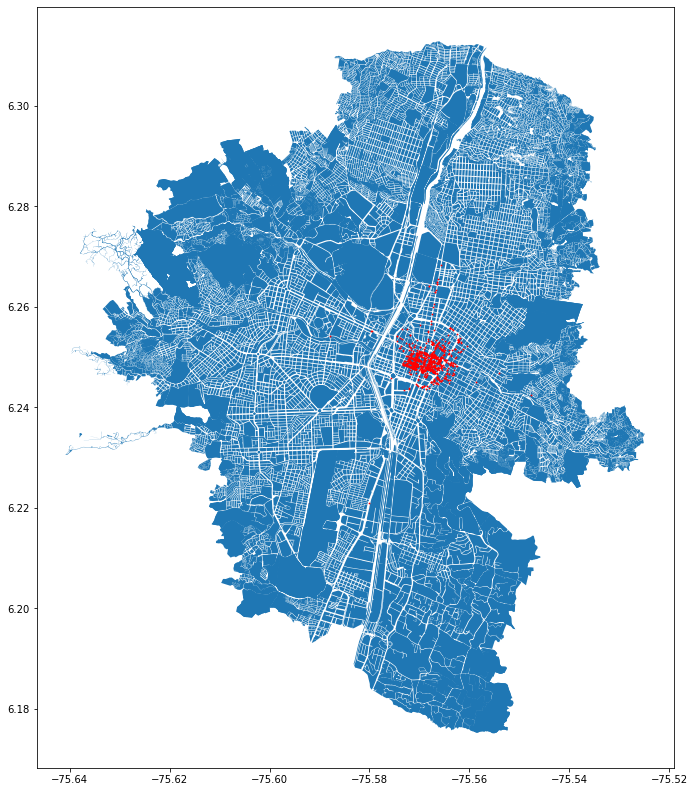

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
venteros.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
dummy_venteros = sjoin(mede_shp,venteros)
dummy_venteros.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,STRE_MAIL,TIPO_VENTA,SUBTIPO,TIPOLGIA,NOMBRE_DEL,TIEMPO_CAR,FECHAREGIS,X_COORDENA,Y_COORDENA,LINK
2226,1944,0407,0407005,24682.538493,773.970361,NaN,150,6903,0407,04,...,NO TIENE,Estacionaria,2,PICADURA Y DULCES,MÓDULO,NaN,24/11/2011 10:01:06 a.m.,835214.8109,1.184845e+06,NaN
2226,1944,0407,0407005,24682.538493,773.970361,NaN,150,6903,0407,04,...,NaN,Estacionaria,2,PICADURA Y DULCES,MÓDULO,D-V 08:0018:00,24/11/2011 10:16:06 a.m.,835193.3492,1.184719e+06,NaN
2226,1944,0407,0407005,24682.538493,773.970361,NaN,150,6903,0407,04,...,NO TIENE,Estacionaria,2,FRUTAS,MÓDULO,NaN,24/11/2011 09:07:16 a.m.,835193.3492,1.184719e+06,NaN
2226,1944,0407,0407005,24682.538493,773.970361,NaN,150,6903,0407,04,...,NaN,Estacionaria,2,PICADURA Y DULCES,MÓDULO,L-S 8:00-18:00,24/11/2011 11:25:07 a.m.,835201.3183,1.184770e+06,NaN
2226,1944,0407,0407005,24682.538493,773.970361,NaN,150,6903,0407,04,...,NaN,Estacionaria,2,PICADURA Y DULCES,MÓDULO,L-D 09:0018:00,24/11/2011 10:24:24 a.m.,835201.3183,1.184770e+06,NaN


In [ ]:
dummy_venteros[['BARRIO','indice_man']]

,BARRIO,indice_man
2226,07,2226
2226,07,2226
2226,07,2226
2226,07,2226
2226,07,2226
...,...,...
7150,03,7150
7163,03,7163
7178,10,7178
7178,10,7178


In [ ]:
len(dummy_venteros.indice_man.unique())

105

In [ ]:
dummy_venteros.shape

(687, 51)

In [ ]:
bla = pd.DataFrame(dummy_venteros.groupby('indice_man').count()['OBJECTID_l']).reset_index()

In [ ]:
bla

,indice_man,OBJECTID_l
0,2226,5
1,6503,5
2,6509,21
3,6511,2
4,6520,14
...,...,...
100,7137,1
101,7150,1
102,7163,1
103,7178,2


In [ ]:
bla.rename(columns={'OBJECTID_l':'numero_venteros'}, inplace=True)

In [ ]:
bla

,indice_man,numero_venteros
0,2226,5
1,6503,5
2,6509,21
3,6511,2
4,6520,14
...,...,...
100,7137,1
101,7150,1
102,7163,1
103,7178,2


In [ ]:
mede_shp = mede_shp.merge(bla,how ='left', on='indice_man')

In [ ]:
mede_shp.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO', 'COMUNA', 'BARRIO',
       'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM', 'SHAPE__Are',
       'SHAPE__Len', 'indice_man', 'casos', 'geometry', 'numero_venteros'],
      dtype='object')

In [ ]:
mede_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 10736 entries, 0 to 10735
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID_l       10736 non-null  int64   
 1   BARRIOVERE       5780 non-null   object  
 2   COBAMA           10727 non-null  object  
 3   SHAPE_AREA       10736 non-null  float64 
 4   SHAPE_LEN        10736 non-null  float64 
 5   nombre           1 non-null      object  
 6   index_righ       10736 non-null  int64   
 7   OBJECTID_r       10736 non-null  int64   
 8   CODIGO           10736 non-null  object  
 9   COMUNA           10736 non-null  object  
 10  BARRIO           10736 non-null  object  
 11  NOMBRE_BAR       10736 non-null  object  
 12  SECTOR           10736 non-null  int64   
 13  INDICADOR_       10736 non-null  object  
 14  NOMBRE_COM       10736 non-null  object  
 15  SHAPE__Are       10736 non-null  float64 
 16  SHAPE__Len       10736 non-null 

###**Union sitios turisticos**

In [ ]:
turisticos = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Sitios_turisticos.shp')
turisticos.head()

,OBJECTID,NOMBRESITI,IMPERDIBLE,TIPOATRACT,COD_COMUNA,COM_CORR,LABEL,geometry
0,1,Cerro Nutibara,NO,Cerro,16,Belén,Cerro Nutibara,POINT (833753.022 1181545.608)
1,2,Teatro La Casa de Crisanto,NO,Edificación para la cultura,16,Belén,Teatro La Casa de Crisanto,POINT (833767.182 1181871.964)
2,3,Unidad Deportiva de Belén Andrés Escobar Salda...,NO,Escenario para la recreación y el deporte,16,Belén,UD. Belén,POINT (832809.285 1181521.876)
3,4,Teatro Universidad de Medellín Gabriel Obregón...,NO,Edificación para la cultura,16,Belén,Teatro Universidad de Medellín,POINT (830326.576 1181209.786)
4,5,Aeroparque Juan Pablo II,NO,Escenario para la recreación y el deporte,15,Guayabal,Aeroparque Juan Pablo II,POINT (832376.684 1179944.475)


In [ ]:
turisticos.shape

(300, 8)

In [ ]:
turisticos.TIPOATRACT.unique()

array(['Cerro', 'Edificación para la cultura',
       'Escenario para la recreación y el deporte',
       'Arquitectura para el comercio', 'Elemento del espacio público',
       'Obras de ingeniería e infraestructura',
       'Sector urbano o rural de interés', 'Otro',
       'Centro hospitalario y asistencial', 'Monumento', 'Estatua',
       'Funeraria', 'Lagunas', 'Agropecuaria', 'Vivienda rural', 'Templo',
       'Edificación para la educación', 'Cordillera',
       'Conocimientos y prácticas sobre el universo y la naturaleza',
       'Lugares de observación de fauna y flora', 'Alto',
       'Arquitectura para la industria', 'Edificación para la ciencia',
       'Áreas con declaratorias municipales', 'Edificación gubernamental',
       'Cascada, catarata o salto', 'Reserva natural', 'Cementerio',
       'Vivienda urbana', 'Escultura', 'Monte', 'Vía parque',
       'Centro doctrinero', 'Quebrada', 'Arquitectura para el transporte'],
      dtype=object)

In [ ]:
turisticos= turisticos.to_crs("EPSG:4326")

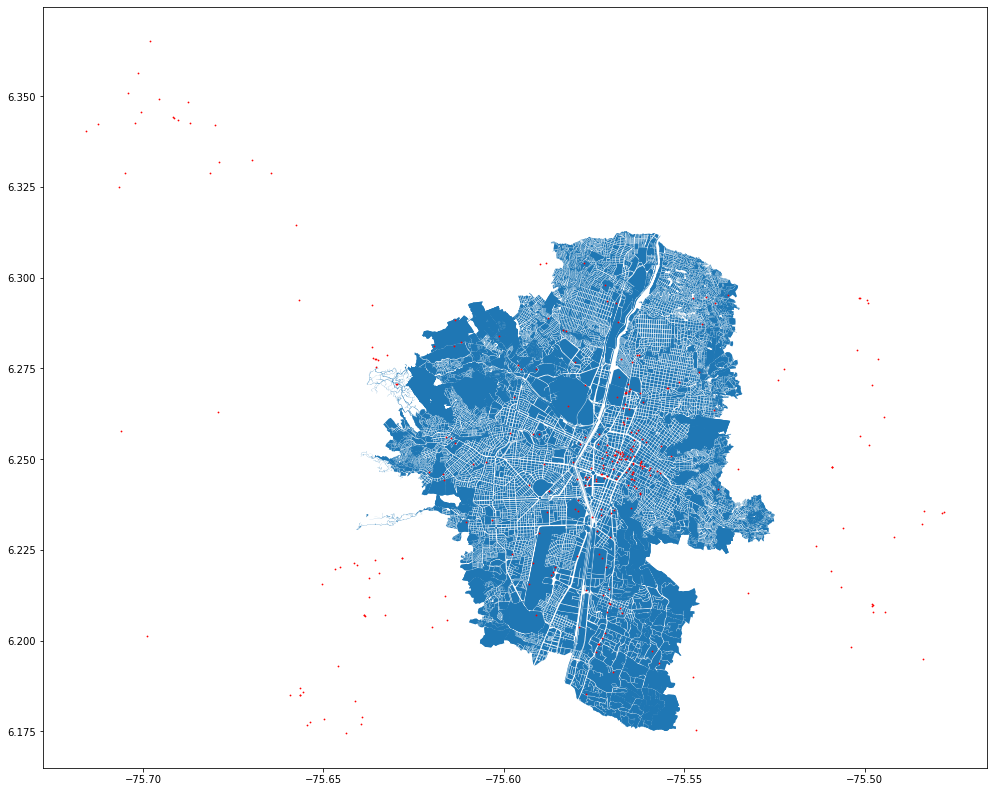

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
turisticos.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,turisticos,'numero_sitios_turisticos')

In [ ]:
mede_shp.numero_sitios_turisticos =mede_shp.numero_sitios_turisticos.astype('Int64')

In [ ]:
mede_shp.shape

(10736, 22)

###**Union Semaforos**

In [ ]:
semaforos = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Semaforos.shp')
semaforos.head()

,OBJECTID,LAYER,ORDEN,DIRECCION,CLASE_CL,M,M1,M2,M3,P,...,IDCRUCE,IDCONTROL,FECHA_INST,COMENTARIO,SEM_CICLA,SEM_PEAT_C,PULSADOR_P,DETECT_MAL,DETEC_MALL,geometry
0,27,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 34 x CL 7,EC-1,2.0,0.0,NaN,NaN,2.0,...,0052,039,NaN,NaN,0,0,0,0,NaN,POINT (835401.374 1178247.054)
1,28,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 35 x CL 10,EC-1,0.0,1.0,1,NaN,0.0,...,0053,020,NaN,NaN,0,0,2,0,1,POINT (835299.874 1178543.562)
2,29,S_ QUE COMPARTES CONTROLADOR LOCAL,14.0,CR 35 x CL 10 A,EC-1,0.0,0.0,1,NaN,0.0,...,0054,014,NaN,NaN,0,0,2,0,NaN,POINT (835344.076 1178633.033)
3,30,CORREDOR TRANVIARIO,9.0,CR 35 x CL 49,NaN,0.0,3.0,NaN,NaN,0.0,...,0055,250,NaN,NaN,0,0,0,0,NaN,POINT (836306.003 1182312.778)
4,31,CONECTADOS A CENTRAL CON PARES PROPIOS DE LA S...,14.0,CR 35 x CL 5 SUR,EC-1,1.0,1.0,1,NaN,0.0,...,0056,042,NaN,NaN,0,0,4,0,NaN,POINT (834984.642 1177245.022)


In [ ]:
semaforos.shape

(710, 36)

In [ ]:
semaforos.columns


Index(['OBJECTID', 'LAYER', 'ORDEN', 'DIRECCION', 'CLASE_CL', 'M', 'M1', 'M2',
       'M3', 'P', 'P1', 'P2', 'P3', 'PP1', 'PP2', 'PP4', 'SEM_VEH_PO', 'S_MEN',
       'SEM_PEAT', 'TOTAL_LAMP', 'SONORIZADO', 'CONTAD_REG', 'VOLTAJE_V',
       'CORRIENTE', 'CONSUMO_W', 'GLOBALID', 'IDCRUCE', 'IDCONTROL',
       'FECHA_INST', 'COMENTARIO', 'SEM_CICLA', 'SEM_PEAT_C', 'PULSADOR_P',
       'DETECT_MAL', 'DETEC_MALL', 'geometry'],
      dtype='object')

In [ ]:
semaforos= semaforos.to_crs("EPSG:4326")

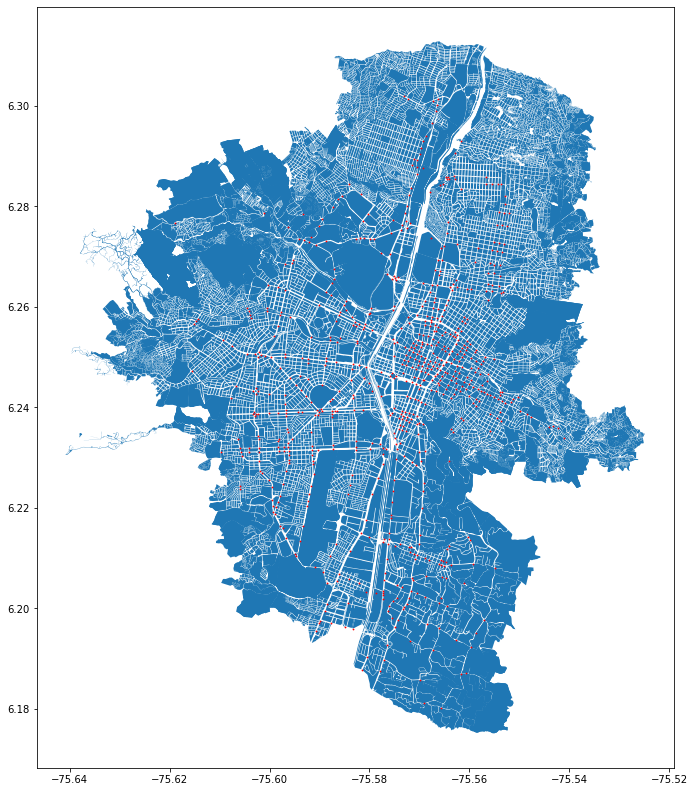

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
semaforos.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,semaforos,'numero_semaforos')

In [ ]:
mede_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 10736 entries, 0 to 10735
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   OBJECTID_l                10736 non-null  int64   
 1   BARRIOVERE                5780 non-null   object  
 2   COBAMA                    10727 non-null  object  
 3   SHAPE_AREA                10736 non-null  float64 
 4   SHAPE_LEN                 10736 non-null  float64 
 5   nombre                    1 non-null      object  
 6   index_righ                10736 non-null  int64   
 7   OBJECTID_r                10736 non-null  int64   
 8   CODIGO                    10736 non-null  object  
 9   COMUNA                    10736 non-null  object  
 10  BARRIO                    10736 non-null  object  
 11  NOMBRE_BAR                10736 non-null  object  
 12  SECTOR                    10736 non-null  int64   
 13  INDICADOR_                10736 non-nu

###**Union SedeSalud**



In [ ]:
sedeSalud = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/SedeSalud.shp')
sedeSalud.head()

,OBJECTID,CODIGO_SED,NOMBRE_CEN,NATURALEZA,FAX,TELEFONO,CORREO,COMPHOSP,MODALIDAD,COMPLURG,...,DIRECCION,CODIGO_BAR,CODSCONS,LINK,OBSERVACIO,REPORTASIV,REPORTAVAC,REPORTARIP,REPORTANUT,geometry
0,268,050010217846,CENTRO DE SALUD LA LOMA,Pública,NaN,4387767,coordinacionlaloma@metrosalud.gov.co,Ninguna,Ninguna,Ninguna,...,CL 55A 125A 05,6014,050010217846,NaN,NaN,Si,Si,Si,Si,POINT (828068.330 1185541.980)
1,269,050010921401,CLINICA DEL CAMPESTRE S.A,Privado con Ánimo de Lucro,NaN,4442006,clinicadelcampestre1@une.net.co,Ninguna,Ninguna,Ninguna,...,CL 17SUR 44 06,1423,050010921401,NaN,NaN,Si,No,Si,No,POINT (833861.350 1176225.920)
2,270,050010819901,UBA COOMEVA EPS CLINICA MEDELLIN LTDA,Privado con Ánimo de Lucro,NaN,3697221,gerencia@ubamedellin.co,Ninguna,Ninguna,Ninguna,...,CL 54 46 27,1019,050010819901,NaN,NaN,Si,Si,Si,Si,POINT (835505.250 1183255.230)
3,271,050010217841,CENTRO DE SALUD FLORENCIA,Pública,NaN,4614747,coordinacionflorencia@metrosalud.gov.co,Ninguna,Ninguna,Ninguna,...,CL 112 74 20,5040,050010217841,NaN,NaN,Si,Si,Si,Si,POINT (834814.790 1189629.200)
4,272,050010115001,FUNDACION INSTITUTO NEUROLOGICO DE COLOMBIA,Privado sin Ánimo de Lucro,NaN,NaN,Ninguna,Alta,Hospitalario,Baja,...,CL 55 46 36,1018,050010115001,NaN,NaN,Si,No,Si,No,POINT (835528.490 1183375.090)


In [ ]:
sedeSalud.shape

(145, 22)

In [ ]:
sedeSalud.columns

Index(['OBJECTID', 'CODIGO_SED', 'NOMBRE_CEN', 'NATURALEZA', 'FAX', 'TELEFONO',
       'CORREO', 'COMPHOSP', 'MODALIDAD', 'COMPLURG', 'NOMBRE_SER',
       'COBAMACOR', 'DIRECCION', 'CODIGO_BAR', 'CODSCONS', 'LINK',
       'OBSERVACIO', 'REPORTASIV', 'REPORTAVAC', 'REPORTARIP', 'REPORTANUT',
       'geometry'],
      dtype='object')

In [ ]:
sedeSalud= sedeSalud.to_crs("EPSG:4326")

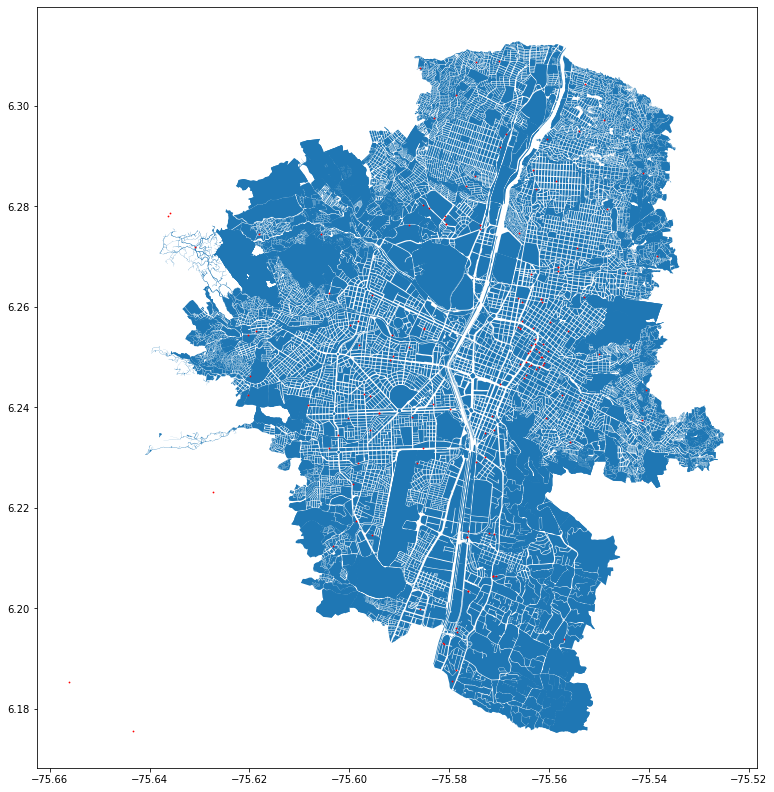

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
sedeSalud.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
mede_shp =countPunts(mede_shp,semaforos,'num_sedes_salud')

###**Union Poste_Alumbrado**


In [ ]:
poste = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Poste_Alumbrado.shp')
poste.head()

,OBJECTID,G3E_FID,ESTADO,MATERIAL,ALTURA,PROPIETARI,DEPARTAMEN,CLASE,TIPO_INSTA,PROYECTO,REQUERIMIE,geometry
0,45,14142951,OPERACION,CONCRETO,0,MEDELLÍN,NaN,CIRCULAR,NaN,19381264,46131,MULTIPOINT (825323.389 1174958.977)
1,46,14194011,OPERACION,PRFV,0,ALUMBRADO PUBLICO,NaN,CIRCULAR,NaN,20422211,48696,MULTIPOINT (825362.719 1175002.324)
2,47,14194029,OPERACION,PRFV,0,ALUMBRADO PUBLICO,NaN,CIRCULAR,NaN,20422211,48696,MULTIPOINT (825371.510 1175013.702)
3,48,14194039,OPERACION,PRFV,0,ALUMBRADO PUBLICO,NaN,CIRCULAR,NaN,20422211,48696,MULTIPOINT (825391.319 1175027.428)
4,49,14194077,OPERACION,PRFV,0,ALUMBRADO PUBLICO,NaN,CIRCULAR,NaN,20422211,48696,MULTIPOINT (825353.675 1175015.297)


In [ ]:
poste.PROPIETARI.value_counts()

ALUMBRADO PUBLICO    35218
MEDELLÍN              1514
Name: PROPIETARI, dtype: int64

In [ ]:
poste= poste.to_crs("EPSG:4326")

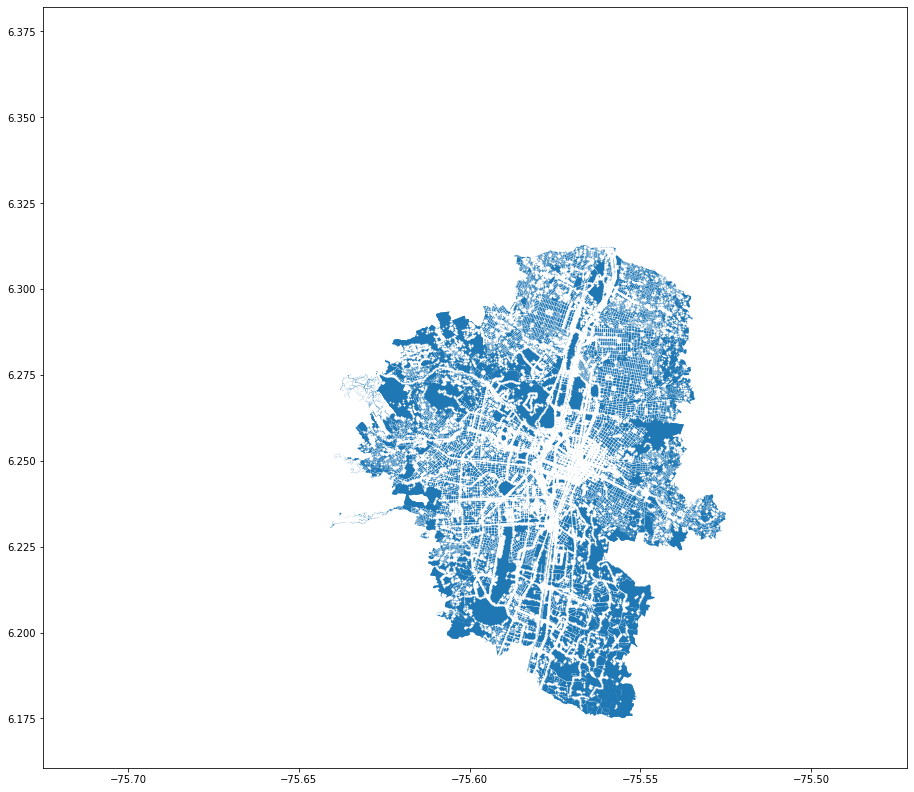

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
poste.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,poste,'num_postes_alumbrado')

###**Union Paraderos bus**


In [ ]:
paraderos = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Paraderos.shp')
paraderos.head()

,OBJECTID,ID_PARADER,NOMBRE,DIRECCION,ORIENTACIO,MOBILIARIO,FROM_DATE,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,geometry
0,228,50228,NaN,"CR 62 x CL 56A, Medellin",E,NaN,2018-08-01,826663.6218,1.174641e+06,-75.643610,6.173367,POINT (826663.622 1174640.612)
1,229,50229,NaN,"CR 62 55 Sur-69, Medellin",N,NaN,2018-08-01,826672.5699,1.174765e+06,-75.643530,6.174487,POINT (826672.570 1174764.552)
2,230,50230,NaN,"CR 62B x CL 33, Medellin",W,NaN,2018-08-01,826674.2832,1.176694e+06,-75.643517,6.191933,POINT (826674.283 1176694.350)
3,231,50231,NaN,"CR 62 x CL 55, Medellin",S,NaN,2018-08-01,826674.3375,1.174758e+06,-75.643514,6.174427,POINT (826674.338 1174757.941)
4,233,50233,NaN,"CL 62B x CR 143A , Medellin",S,NaN,2018-08-01,826678.1049,1.186126e+06,-75.643495,6.277197,POINT (826678.105 1186125.666)


In [ ]:
paraderos.shape

(5274, 12)

In [ ]:
paraderos= paraderos.to_crs("EPSG:4326")

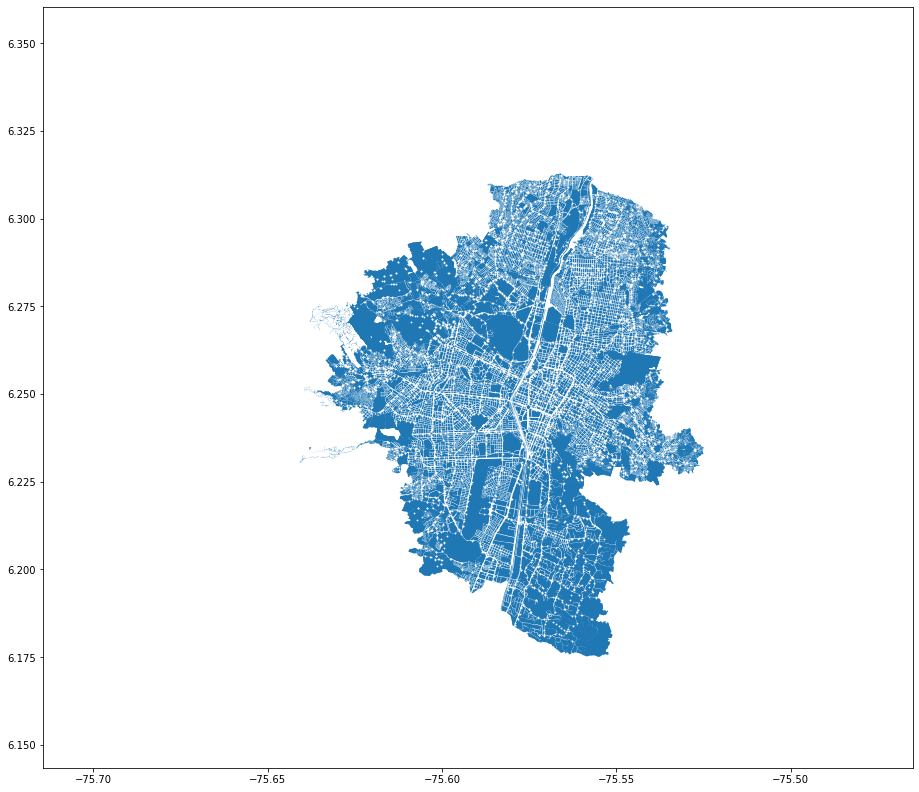

In [ ]:
axis = mede_shp.plot(figsize=(20,14))
paraderos.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,paraderos,'num_paraderos_carro')

###**Union InstituEduca**


In [ ]:
colegios = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/InstituEduca.shp')
colegios.head()

,OBJECTID,NOMBRE_EST,SEDE_EDUCA,NUCLEO,SERVICIO,SECTOR,DIRECCION,TELEFONO,ESTADO,VIGENCIA,X_MAGNAMED,Y_MAGNAMED,CLASIFICAC,CODIGO_DAN,CONS_SEDE,DANE_SEDE,geometry
0,102,INST EDUC PEDRO LUIS VILLA,INST EDUC PEDRO LUIS VILLA,916.0,OFICIAL,Oficial,CR 43 66 C 40,2337963,Activo,2020.0,836597.1525,1.184350e+06,Oficial - Sede Principal,105001002488,10500100248801,105001002488,POINT (836597.152 1184349.520)
1,103,INST EDUC PEDRO LUIS VILLA,SEC ESC MARCO FIDEL SUAREZ,916.0,OFICIAL,Oficial,CL 70 A 43 74,2331640,Activo,2020.0,836641.0500,1.184897e+06,Oficial - Sede Escuela,105001002488,10500100248802,105001002046,POINT (836641.050 1184897.220)
2,104,INST EDUC PEDRO LUIS VILLA,SEC ESC VERSALLES,916.0,OFICIAL,Oficial,CL 71 33 33,2843485,Activo,2020.0,837469.2060,1.184828e+06,Oficial - Sede Escuela,105001002488,10500100248803,105001006122,POINT (837469.206 1184827.623)
3,105,INST EDUC CRISTO REY,INST EDUC CRISTO REY,933.0,OFICIAL,Oficial,CL 2 SUR 50 D 30,2850778,Activo,2020.0,833516.7700,1.178141e+06,Oficial - Sede Principal,105001002496,10500100249601,105001002496,POINT (833516.770 1178141.250)
4,106,INST EDUC CRISTO REY,SEC ESC CRISTO REY-APOLO,933.0,OFICIAL,Oficial,CR 50G 3SUR 34,2556549,Activo,2020.0,833283.1000,1.178079e+06,Oficial - Sede Escuela,105001002496,10500100249602,105001010740,POINT (833283.100 1178079.126)


In [ ]:
colegios.SERVICIO.value_counts()

OFICIAL                   421
NO OFICIAL                379
COBERTURA CONTRATADA       49
CONFESIONES RELIGIOSAS      7
REGIMEN ESPECIAL            4
Name: SERVICIO, dtype: int64

In [ ]:
colegios.shape

(860, 17)

In [ ]:
colegios.drop(index=list(range(804,835)), inplace=True)

In [ ]:
colegios= colegios.to_crs("EPSG:4326")

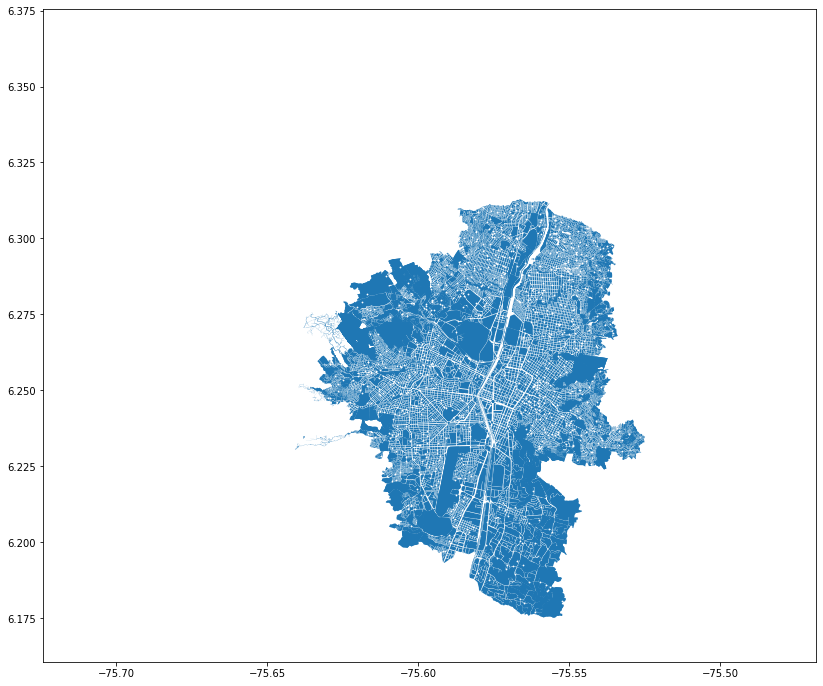

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
colegios.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,colegios,'num_inst_educativas')

###**Union Hoteles**


In [ ]:
hoteles = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Hoteles.shp')
hoteles.head()

,OBJECTID,NOMBRE,DIRECCION,CATEGORIA,TEL,FAX,GERENTE,LINK,HABITACION,ESTRELLAS,RULEID,NIT,ESTADO,RNT,ID,geometry
0,577,NORMANDIA,CL 53 49 100,HOTEL,2512296,NaN,LUIS FERNANDO LOBO,hotelnrmandia@hotmail.com,0,0,1,13360239-4,ACTIVO,11308,83,POINT (835239.690 1183352.532)
1,578,MARACAIBO REAL,CL 53 49 64,HOTEL,5129197,NaN,ELPIDIA ZULUAGA,NaN,0,0,1,13360239-4,ACTIVO,12744,84,POINT (835261.283 1183338.597)
2,579,JUNIMAR,CL 53 49 80,HOTEL,512527,2316595,MARGARITA PÉREZ,NaN,0,0,1,39715924,CANCELADO,11893,85,POINT (835251.881 1183344.822)
3,580,LA BELLA VILLA,CL 53 50 28,HOTEL,NaN,NaN,ELIZABETH RESTREPO,NaN,0,0,1,1127276044-0,SUSPENDIDO,11571,86,POINT (835154.665 1183404.901)
4,581,SANTELMO,CL 53 50A 8,APARTA HOTEL,2313144,NaN,JULIO CESAR SALAZAR ECHEVERRI,NaN,0,0,2,800052538-5,ACTIVO,12295,35,POINT (835118.400 1183427.484)


In [ ]:
hoteles.ESTADO.unique()

array(['ACTIVO', 'CANCELADO', 'SUSPENDIDO', 'NO REGISTRA'], dtype=object)

In [ ]:
hoteles.ESTADO.value_counts()

ACTIVO         121
SUSPENDIDO      35
NO REGISTRA     33
CANCELADO       12
Name: ESTADO, dtype: int64

In [ ]:
hoteles =hoteles[hoteles.ESTADO !='CANCELADO']

In [ ]:
hoteles.shape

(189, 16)

In [ ]:
hoteles= hoteles.to_crs("EPSG:4326")

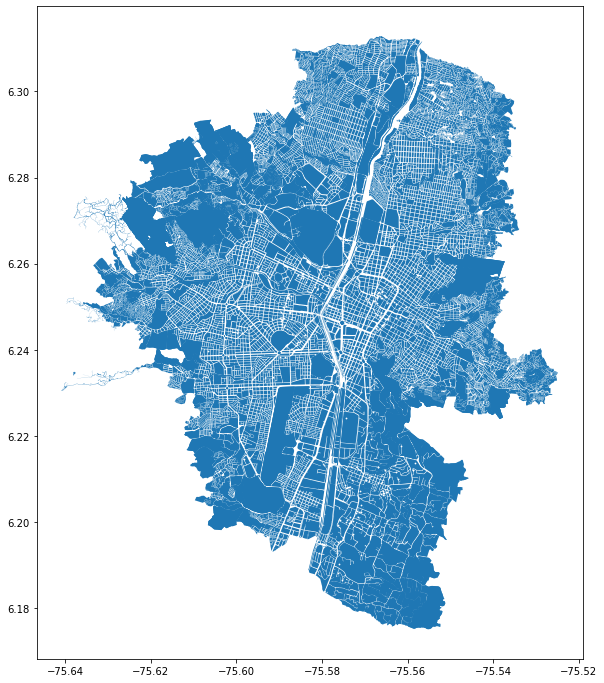

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
hoteles.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,hoteles,'num_hoteles')

###**Union Escenarios_deportivos**


In [ ]:
deportivos = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Escenarios_deportivos.shp')
deportivos.head()

,OBJECTID,ID,COD_DEFINI,NOMBRE,NOMBRE_EQU,TIPOLOGIA_,DIRECCION,CBML,COD_TIPOLO,TIPOLOGIA1,...,COD_BARRIO,NOMBRE_BAR,HORARIO,LINK_FOTO,LINK_DETAL,X_MAGNAMED,Y_MAGNAMED,LATITUD,LONGITUD,geometry
0,1,1.0,01_02_05,CANCHA POLIDEPORTIVA CARPINELO,NA,BARRIAL,CR 26C CL 97A,01120080033,1.0,CANCHA POLIDEPORTIVA,...,0112,Carpinelo,NaN,NaN,NaN,837992.6961,1.187208e+06,6.286986,-75.541269,POINT (837992.696 1187207.874)
1,2,2.0,01_03_01,GIMNASIO AL AIRE LIBRE CARPINELO,NA,BARRIAL,CR 26C CL 97A,01120080033,14.0,GIMNASIO AL AIRE LIBRE,...,0112,Carpinelo,NaN,NaN,NaN,837987.4752,1.187187e+06,6.286796,-75.541316,POINT (837987.475 1187186.811)
2,3,3.0,01_02_06,CANCHA POLIDEPORTIVA DIVINA PROVIDENCIA,NA,BARRIAL,CL 108 CR 43B,01030110001,1.0,CANCHA POLIDEPORTIVA,...,0103,Popular,NaN,NaN,NaN,837154.2567,1.188302e+06,6.296877,-75.548844,POINT (837154.257 1188301.922)
3,4,4.0,01_03_03,GIMNASIO AL AIRE LIBRE DIVINA PROVIDENCIA,NA,BARRIAL,CL 108 CR 43B,01030110001,14.0,GIMNASIO AL AIRE LIBRE,...,0103,Popular,NaN,NaN,NaN,837155.3843,1.188300e+06,6.296856,-75.548834,POINT (837155.384 1188299.579)
4,5,5.0,01_04_05,LUDOTEKA POPULAR DIVINA PROVIDENCIA,NA,BARRIAL,CL 107E CR 43 - 35,01030040055,31.0,LUDOTEKA INTERACTIVA,...,0103,Popular,NaN,NaN,NaN,837138.7970,1.188285e+06,6.296725,-75.548984,POINT (837138.797 1188285.063)


In [ ]:
deportivos.shape

(967, 23)

In [ ]:
deportivos= deportivos.to_crs("EPSG:4326")

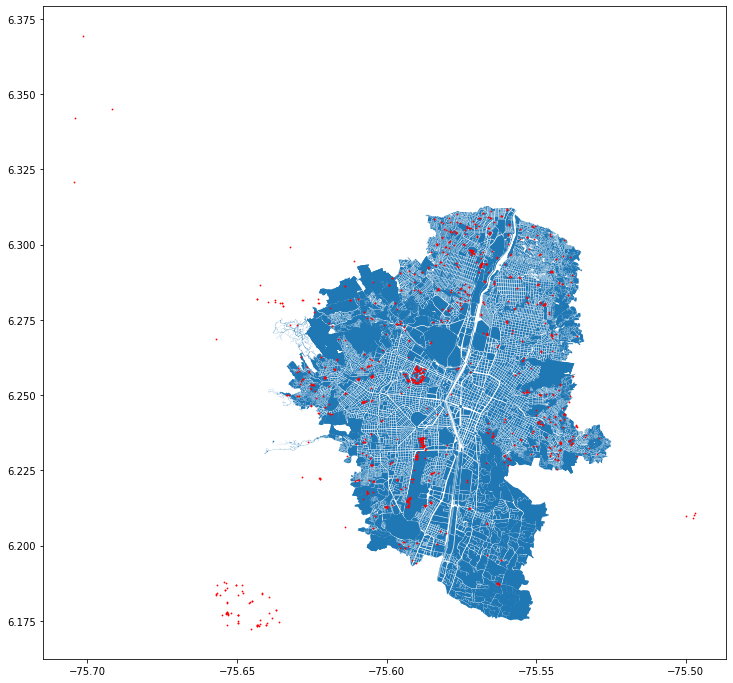

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
deportivos.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,deportivos,'num_esc_deport')

###**Union Convive_la_noche**






In [ ]:
noche = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Convive_la_noche.shp')
noche.head()

,NOMBRE_DEL,DIRECCIÓN,COMUNA,HORARIO,CODIGO,BARRIO,COMUNA1,x,y,geometry
0,ABEYMAR (Nuevo),CLL 106 # 32 A-97 INT. 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837752.68,1187940.93,POINT (837752.680 1187940.930)
1,BAR CANELA,CL 106A 33A 26,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837774.26,1187962.83,POINT (837774.260 1187962.830)
2,BAR LOS RELICARIOS,CR 46 109 54,1.0,2:00 a.m,0103,Popular,01,837102.37,1188576.12,POINT (837102.370 1188576.120)
3,BAR SEVEN NIGHT,CL 106 32A 87 201,1.0,4:00 a. m.,0101,Santo Domingo Savio No.1,01,837780.50,1187934.20,POINT (837780.500 1187934.200)
4,BILLAR CALICHE DE SANTO DOMINGO,CR 30 111 02,1.0,2:00 a. m.,0102,Santo Domingo Savio No.2,01,837878.13,1188631.24,POINT (837878.130 1188631.240)


In [ ]:
noche= noche.to_crs("EPSG:4326")

In [ ]:
def countPunts(medellin_hurtos, shape_points, name_column):
  join_gdf = sjoin(medellin_hurtos,shape_points)
  df = pd.DataFrame(join_gdf.groupby('key').count()['BARRIO']).reset_index()
  df.rename(columns={'BARRIO':name_column}, inplace=True)
  medellin_hurtos = medellin_hurtos.merge(df,how ='left', on='key')
  medellin_hurtos[name_column] = medellin_hurtos[name_column].astype('Int64')
  return medellin_hurtos

In [ ]:
join_gdf = sjoin(mede_shp,noche)


In [ ]:
join_gdf.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO_left', 'COMUNA_left',
       'BARRIO_left', 'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM',
       'SHAPE__Are', 'SHAPE__Len', 'indice_man', 'casos', 'geometry',
       'numero_venteros', 'numero_sitios_turisticos', 'numero_semaforos',
       'num_sedes_salud', 'num_postes_alumbrado', 'num_paraderos_carro',
       'num_inst_educativas', 'num_hoteles', 'num_esc_deport', 'index_right',
       'NOMBRE_DEL', 'DIRECCIÓN', 'COMUNA_right', 'HORARIO', 'CODIGO_right',
       'BARRIO_right', 'COMUNA1', 'x', 'y'],
      dtype='object')

In [ ]:
df = pd.DataFrame(join_gdf.groupby('indice_man').count()['OBJECTID_l']).reset_index()
df.rename(columns={'OBJECTID_l':'num_conv_nocturno'}, inplace=True)
mede_shp = mede_shp.merge(df,how ='left', on='indice_man')
mede_shp['num_conv_nocturno'] = mede_shp['num_conv_nocturno'].astype('Int64')


In [ ]:
mede_shp

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,numero_venteros,numero_sitios_turisticos,numero_semaforos,num_sedes_salud,num_postes_alumbrado,num_paraderos_carro,num_inst_educativas,num_hoteles,num_esc_deport,num_conv_nocturno
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,NaN,<NA>,<NA>,<NA>,2,<NA>,<NA>,<NA>,<NA>,<NA>
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10731,9763,1614,1614031,3675.532749,258.897275,NaN,174,6927,1614,16,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
10732,9764,1614,1614032,10239.211067,428.143259,NaN,174,6927,1614,16,...,NaN,<NA>,<NA>,<NA>,<NA>,1,<NA>,<NA>,<NA>,<NA>
10733,9765,1614,1614033,4579.839949,285.074888,NaN,174,6927,1614,16,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
10734,9766,1614,1614034,3061.829677,224.643049,NaN,174,6927,1614,16,...,NaN,<NA>,<NA>,<NA>,<NA>,1,<NA>,<NA>,<NA>,<NA>


In [ ]:
mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_2.shp')

<ipython-input-172-3618015c27ff>:1: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_2.shp')


###**Union Centros_comerciales**


In [ ]:
mede_shp = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_2.shp')
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,numero_sit,numero_sem,num_sedes_,num_postes,num_parade,num_inst_e,num_hotele,num_esc_de,num_conv_n,geometry
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034..."
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6..."
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6..."
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918..."
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888..."


In [ ]:
mede_shp.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO', 'COMUNA', 'BARRIO',
       'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM', 'SHAPE__Are',
       'SHAPE__Len', 'indice_man', 'casos', 'numero_ven', 'numero_sit',
       'numero_sem', 'num_sedes_', 'num_postes', 'num_parade', 'num_inst_e',
       'num_hotele', 'num_esc_de', 'num_conv_n', 'geometry'],
      dtype='object')

In [ ]:
centros = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Centros_comerciales.shp')
centros.head()

,OBJECTID,NOMBRE,DIRECCION,LINK_FOTO,LINK_DETAL,CREDITOS_F,ID,LABEL,geometry
0,1,Centro Comercial Villanueva,Carrera 47 52 86,NaN,NaN,NaN,1,C.C. Villanueva,POINT (835450.924 1183702.952)
1,2,Centro Comercial La Strada,Carrera 43A 1Sur 150,NaN,NaN,NaN,2,C.C. La Strada,POINT (834608.972 1177807.245)
2,3,Centro Comercial Los Molinos,Calle 30A 82A 26,NaN,NaN,NaN,3,C.C. Los Molinos,POINT (831000.770 1181150.205)
3,4,Centro Comercial Monterrey,Carrera 48 10 45,NaN,www.monterrey.com.co,NaN,4,C.C. Monterrey,POINT (834075.428 1179130.732)
4,5,Centro Comercial Oviedo,Carrera 43A 6Sur 15,NaN,https://www.oviedo.com.co,NaN,5,C.C. Oviedo,POINT (834309.314 1177497.958)


In [ ]:
centros.crs

<Derived Projected CRS: EPSG:6257>
Name: MAGNA-SIRGAS / Medellin urban grid
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Colombia - Medellin city.
- bounds: (-75.66, 6.12, -75.5, 6.37)
Coordinate Operation:
- name: Medellin urban grid
- method: Colombia Urban
Datum: Marco Geocentrico Nacional de Referencia
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
centros= centros.to_crs("EPSG:4326")

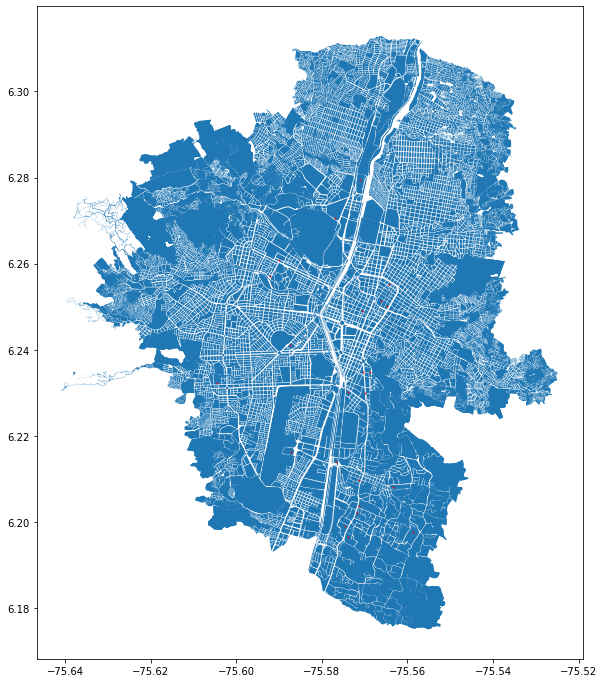

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
centros.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,centros,'num_centrocomercial')

###**Cámaras**


In [ ]:
camaras = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Camaras.shp')
camaras.head()

,ID_PVV,Tipo,Año,Estado,COD_BAR,BARRIO,COMUNA,X,Y,geometry
0,472,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833850.116704,1.182219e+06,POINT (833850.117 1182218.615)
1,473,PVV Cámara FIJA,2017.0,Fuera de servicio,1105,Los Conquistadores,11.0,833839.048021,1.182230e+06,POINT (833839.048 1182229.677)
2,474,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833830.194390,1.182293e+06,POINT (833830.194 1182292.726)
3,475,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833811.377148,1.182291e+06,POINT (833811.377 1182290.514)
4,476,PVV Cámara FIJA,2017.0,En producción,1105,Los Conquistadores,11.0,833810.271068,1.182324e+06,POINT (833810.271 1182323.698)


In [ ]:
camaras= camaras.to_crs("EPSG:4326")

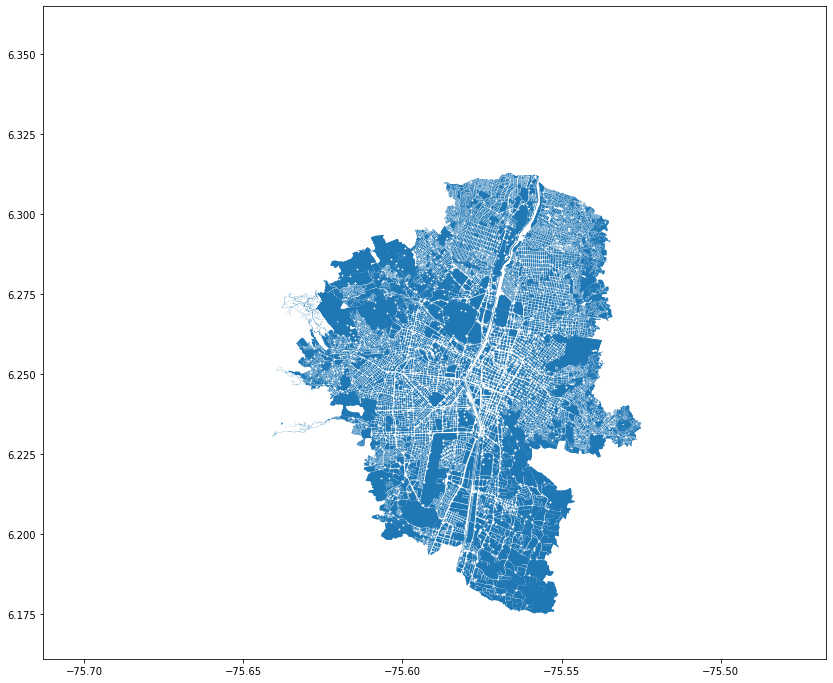

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
camaras.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
join_gdf = sjoin(mede_shp,camaras)


In [ ]:
join_gdf.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO', 'COMUNA_left',
       'BARRIO_left', 'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM',
       'SHAPE__Are', 'SHAPE__Len', 'indice_man', 'casos', 'numero_ven',
       'numero_sit', 'numero_sem', 'num_sedes_', 'num_postes', 'num_parade',
       'num_inst_e', 'num_hotele', 'num_esc_de', 'num_conv_n', 'geometry',
       'num_centrocomercial', 'index_right', 'ID_PVV', 'Tipo', 'Año', 'Estado',
       'COD_BAR', 'BARRIO_right', 'COMUNA_right', 'X', 'Y'],
      dtype='object')

In [ ]:
join_gdf.BARRIO_left

44       02
68       11
119      03
318      01
434      04
         ..
10537    09
10537    09
10561    12
10674    13
10675    13
Name: BARRIO_left, Length: 1045, dtype: object

In [ ]:
df = pd.DataFrame(join_gdf.groupby('indice_man').count()['OBJECTID_l']).reset_index()
#df.rename(columns={'BARRIO_left':'num_camaras'}, inplace=True)
#mede_shp = mede_shp.merge(df,how ='left', on='key')
#mede_shp['num_camaras'] = mede_shp['num_camaras'].astype('Int64')


In [ ]:
df.rename(columns={'OBJECTID_l':'num_camaras'}, inplace=True)

In [ ]:
mede_shp = mede_shp.merge(df,how ='left', on='indice_man')

In [ ]:
mede_shp['num_camaras'] = mede_shp['num_camaras'].astype('Int64')

###**Bibliotecas**


In [ ]:
biblio = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Bibliotecas.shp')
biblio.head()

,OBJECTID,UBICACION,NOMBRE,TELEFONO,TIPO,COMUNA,BARRIO,HORARIO,LABEL,X_COORD,Y_COORD,LINK_FOTO,CREDITOS_F,LINK_DETAL,CORREO,geometry
0,1,CL 50 43 64,Archivo Histórico de Medellín,385 73 46 / 512 65 47,ARCHIVO HISTÓRICO,La Candelaria,La Candelaria,Lunes a jueves: 7:30 am-12:00 m y 1:30-5:30 pm...,Archivo Histórico de Medellín,835543.7151,1.182855e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/archivo-hist...,archivo.historico@medellin.gov.co,POINT (835543.716 1182854.746)
1,2,CR 43 118 26 piso 3,Biblioteca Pública Popular No.2,236 03 16 / 522 00 38,BIBLIOTECA DE PROXIMIDAD,Popular,Popular,Lunes a viernes: 9:00 am - 6:00 pm. Sábado: 9:...,Biblioteca Pública Popular No.2,837338.2142,1.188890e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/biblioteca-p...,popular2@bibliotecasmedellin.gov.co,POINT (837338.215 1188890.175)
2,3,CR 80 104 04,"Parque Biblioteca Gabriel García Márquez, Doce...",477 67 27,PARQUE BIBLIOTECA,Doce de Octubre,Santander,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,Gabriel García Márquez - Doce de Octubre,833956.3085,1.189135e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,docedeoctubre@bibliotecasmedellin.gov.co,POINT (833956.309 1189135.458)
3,4,CR 65 14 115,"Parque Biblioteca Manuel Mejía Vallejo, Guayabal",351 04 95 / 351 29 66,PARQUE BIBLIOTECA,Guayabal,Santa Fe,Lunes a sábado: 8:00 am - 7:00 pm. Domingos y ...,Manuel Mejía Vallejo - Guayabal,833011.5805,1.179833e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,guayabal@bibliotecasmedellin.gov.co,POINT (833011.581 1179833.015)
4,5,CR 4C 6 206,"Parque Biblioteca José Horacio Betancur, San A...",286 29 77 / 286 54 24,PARQUE BIBLIOTECA,Corregimiento de San Antonio de Prado,Área de Expansión San Antonio de Prado,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,José Horacio Betancur - San Antonio de Prado,825459.4690,1.174971e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,sanantonio@bibliotecasmedellin.gov.co,POINT (825459.474 1174970.641)


In [ ]:
biblio= biblio.to_crs("EPSG:4326")

In [ ]:
biblio.head()

,OBJECTID,UBICACION,NOMBRE,TELEFONO,TIPO,COMUNA,BARRIO,HORARIO,LABEL,X_COORD,Y_COORD,LINK_FOTO,CREDITOS_F,LINK_DETAL,CORREO,geometry
0,1,CL 50 43 64,Archivo Histórico de Medellín,385 73 46 / 512 65 47,ARCHIVO HISTÓRICO,La Candelaria,La Candelaria,Lunes a jueves: 7:30 am-12:00 m y 1:30-5:30 pm...,Archivo Histórico de Medellín,835543.7151,1.182855e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/archivo-hist...,archivo.historico@medellin.gov.co,POINT (-75.56340 6.24763)
1,2,CR 43 118 26 piso 3,Biblioteca Pública Popular No.2,236 03 16 / 522 00 38,BIBLIOTECA DE PROXIMIDAD,Popular,Popular,Lunes a viernes: 9:00 am - 6:00 pm. Sábado: 9:...,Biblioteca Pública Popular No.2,837338.2142,1.188890e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/biblioteca-p...,popular2@bibliotecasmedellin.gov.co,POINT (-75.54718 6.30220)
2,3,CR 80 104 04,"Parque Biblioteca Gabriel García Márquez, Doce...",477 67 27,PARQUE BIBLIOTECA,Doce de Octubre,Santander,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,Gabriel García Márquez - Doce de Octubre,833956.3085,1.189135e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,docedeoctubre@bibliotecasmedellin.gov.co,POINT (-75.57774 6.30441)
3,4,CR 65 14 115,"Parque Biblioteca Manuel Mejía Vallejo, Guayabal",351 04 95 / 351 29 66,PARQUE BIBLIOTECA,Guayabal,Santa Fe,Lunes a sábado: 8:00 am - 7:00 pm. Domingos y ...,Manuel Mejía Vallejo - Guayabal,833011.5805,1.179833e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,guayabal@bibliotecasmedellin.gov.co,POINT (-75.58627 6.22031)
4,5,CR 4C 6 206,"Parque Biblioteca José Horacio Betancur, San A...",286 29 77 / 286 54 24,PARQUE BIBLIOTECA,Corregimiento de San Antonio de Prado,Área de Expansión San Antonio de Prado,Lunes a sábado: 9:00 am - 8:00 pm. Domingos y ...,José Horacio Betancur - San Antonio de Prado,825459.4690,1.174971e+06,NaN,NaN,http://bibliotecasmedellin.gov.co/parque-bibli...,sanantonio@bibliotecasmedellin.gov.co,POINT (-75.65449 6.17635)


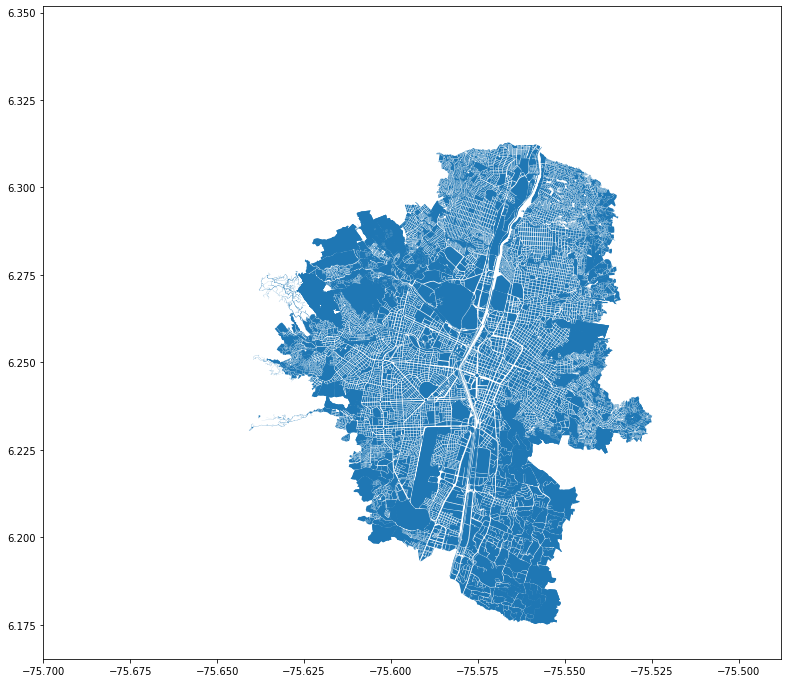

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
biblio.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
join_gdf = sjoin(mede_shp,biblio)


In [ ]:
join_gdf.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO', 'COMUNA_left',
       'BARRIO_left', 'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM',
       'SHAPE__Are', 'SHAPE__Len', 'indice_man', 'casos', 'numero_ven',
       'numero_sit', 'numero_sem', 'num_sedes_', 'num_postes', 'num_parade',
       'num_inst_e', 'num_hotele', 'num_esc_de', 'num_conv_n', 'geometry',
       'num_centrocomercial', 'num_camaras', 'index_right', 'OBJECTID',
       'UBICACION', 'NOMBRE', 'TELEFONO', 'TIPO', 'COMUNA_right',
       'BARRIO_right', 'HORARIO', 'LABEL', 'X_COORD', 'Y_COORD', 'LINK_FOTO',
       'CREDITOS_F', 'LINK_DETAL', 'CORREO'],
      dtype='object')

In [ ]:
df = pd.DataFrame(join_gdf.groupby('indice_man').count()['OBJECTID_l']).reset_index()


In [ ]:
df.rename(columns={'OBJECTID_l':'num_biblios'}, inplace=True)

In [ ]:
mede_shp = mede_shp.merge(df,how ='left', on='indice_man')

In [ ]:
mede_shp['num_biblios'] = mede_shp['num_biblios'].astype('Int64')

In [ ]:
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,num_postes,num_parade,num_inst_e,num_hotele,num_esc_de,num_conv_n,geometry,num_centrocomercial,num_camaras,num_biblios
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034...",<NA>,<NA>,<NA>
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6...",<NA>,<NA>,<NA>
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,2.0,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6...",<NA>,<NA>,<NA>
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918...",<NA>,<NA>,<NA>
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888...",<NA>,<NA>,<NA>


###**arbol**


In [ ]:
arbol = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/Shapes/Arbol.shp')
arbol.head()

,OBJECTID,PROYECTO,SYMBOL,FECHA,RULEID,geometry
0,226,NaN,1,NaN,1,POINT Z (829291.524 1186401.026 1846.232)
1,227,NaN,1,NaN,1,POINT Z (829298.409 1186408.776 1850.552)
2,228,NaN,1,NaN,1,POINT Z (829312.595 1186463.998 1857.752)
3,229,NaN,1,NaN,1,POINT Z (829234.054 1186526.111 1871.112)
4,230,NaN,1,NaN,1,POINT Z (829236.571 1186533.877 1870.712)


In [ ]:
arbol= arbol.to_crs("EPSG:4326")

In [ ]:
arbol.shape

(198430, 6)

In [ ]:
mede_shp = countPunts(mede_shp,arbol,'num_arboles')

In [ ]:
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,num_parade,num_inst_e,num_hotele,num_esc_de,num_conv_n,geometry,num_centrocomercial,num_camaras,num_biblios,num_arboles
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034...",<NA>,<NA>,<NA>,1
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6...",<NA>,<NA>,<NA>,<NA>
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6...",<NA>,<NA>,<NA>,<NA>
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918...",<NA>,<NA>,<NA>,<NA>
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888...",<NA>,<NA>,<NA>,1


In [ ]:
mede_shp.columns

Index(['OBJECTID_l', 'BARRIOVERE', 'COBAMA', 'SHAPE_AREA', 'SHAPE_LEN',
       'nombre', 'index_righ', 'OBJECTID_r', 'CODIGO', 'COMUNA', 'BARRIO',
       'NOMBRE_BAR', 'SECTOR', 'INDICADOR_', 'NOMBRE_COM', 'SHAPE__Are',
       'SHAPE__Len', 'indice_man', 'casos', 'numero_ven', 'numero_sit',
       'numero_sem', 'num_sedes_', 'num_postes', 'num_parade', 'num_inst_e',
       'num_hotele', 'num_esc_de', 'num_conv_n', 'geometry',
       'num_centrocomercial', 'num_camaras', 'num_biblios', 'num_arboles'],
      dtype='object')

In [ ]:
mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_3.shp')

<ipython-input-225-8a8f22aa622e>:1: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_3.shp')


## **LECTURA Y UNIÓN CON LOS NUEVOS SHAPES**

###**taxis**

In [ ]:
taxis = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Acopio de taxis/movilidad_gdb.shx')
taxis.head()

,OBJECTID,ANO_VIGENC,ACT_ADMIN,DIRECCION,COSTADO,UBICACION,CANT_VEHIC,CODIGO_COM,NOMBRE_COM,OBSERVACIO,ESTADO,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,NUMERO_ACO,geometry
0,641,2008,Decreto 1385 de 2005,CALLE 55 x CARRERAS 57 Y 57A PLAZA MINORISTA.,N,NaN,8,10,La Candelaria,NaN,H,834438.2559,1.183847e+06,-75.573383,6.256604,NaN,POINT (-75.57338 6.25660)
1,642,2008,Decreto 1989 de 2008,CALLE 9 SUR x CARRERAS 83AA Y 84,N,P,5,16,Belén,NaN,H,830744.2608,1.178022e+06,-75.606752,6.203943,NaN,POINT (-75.60675 6.20394)
2,643,2008,Decreto 1989 de 2008,CALLE 65 x CARRERAS 69 Y 70,N,P,3,07,Robledo,NaN,H,833265.3180,1.184445e+06,-75.583980,6.262009,NaN,POINT (-75.58398 6.26201)
3,644,2008,Decreto 1989 de 2008,CARRERA 50A x LOS N° 64-45 Y N° 64-65,W,P,5,10,La Candelaria,NaN,H,835729.9114,1.184387e+06,-75.561713,6.261482,NaN,POINT (-75.56171 6.26148)
4,645,2008,Decreto 1989 de 2008,CARRERA 85A x CALLES 78B Y 79,N,P,5,07,Robledo,NaN,H,832944.9532,1.186871e+06,-75.586875,6.283940,NaN,POINT (-75.58688 6.28394)


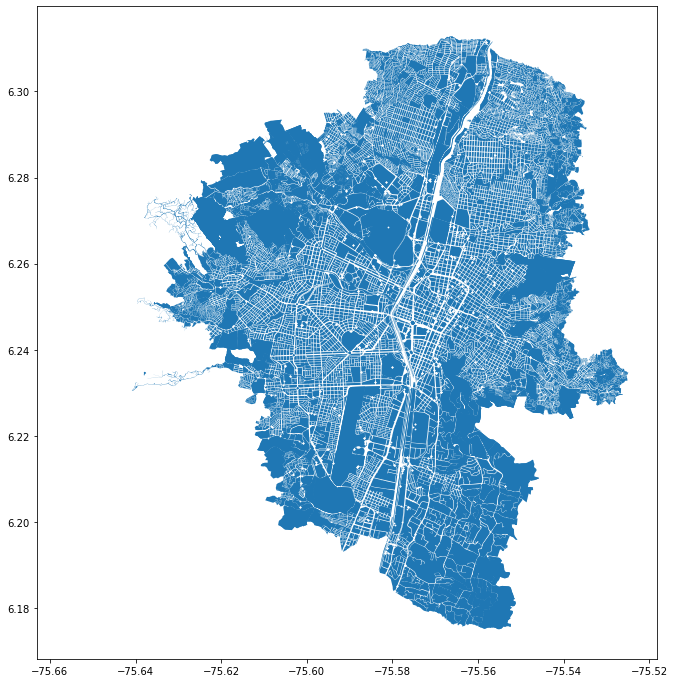

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
taxis.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,taxis,'acopios_tax')

In [ ]:
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,num_inst_e,num_hotele,num_esc_de,num_conv_n,geometry,num_centrocomercial,num_camaras,num_biblios,num_arboles,acopios_tax
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034...",<NA>,<NA>,<NA>,1,<NA>
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6...",<NA>,<NA>,<NA>,<NA>,<NA>
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6...",<NA>,<NA>,<NA>,<NA>,<NA>
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918...",<NA>,<NA>,<NA>,<NA>,<NA>
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888...",<NA>,<NA>,<NA>,1,<NA>


###**arboles**



In [ ]:
arboles = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Árbol Urbano/medioambiente_gdb.shp')
arboles.head()

,OBJECTID,id_individ,cod_indivi,id_interve,s_especie,tipoarbol,id_tipo_in,contrato,s_interven,d_fecha,s_estado_a,s_estado_i,s_observac,point_x,point_y,geometry
0,1,2494,00116120740048,10836990,Fraxinus uhdei,Común,23,AMVA 004 CV DE 2022,Monitoreo de variables dasometricas,2022-02-05,Individuo Enfermo,Aprobado,"MHH- Individuo en regular estado, en la bifurc...",831726.0958,1.180174e+06,MULTIPOINT (-75.59786 6.22330)
1,2,1886,00115090880071,9280249,Citrus limon,Común,23,4600059174 DE 2015,Monitoreo de variables dasometricas,2016-02-04,Individuo Enfermo,Aprobado,NaN,832551.2212,1.178653e+06,MULTIPOINT (-75.59037 6.20957)
2,3,27540,00110180170020,10144262,Bulnesia arborea,Patrimonio Cultural,23,4600074768_PCAM DE 2018,Monitoreo de variables dasometricas,2018-05-12,Individuo Enfermo,Aprobado,"Ubicado en Calle 56 con Carrera 46, Municipio ...",835612.8440,1.183429e+06,MULTIPOINT (-75.56284 6.25283)
3,4,13861,001null0003739,9123013,Ficus elastica,Común,23,4600043683 DE 2012,Monitoreo de variables dasometricas,2014-05-20,Individuo Enfermo,Aprobado,NaN,833728.4536,1.183212e+06,MULTIPOINT (-75.57985 6.25082)
4,5,27402,00110190000024,9147992,Erythrina fusca,Común,23,22222 DE 2014,Monitoreo de variables dasometricas,2014-10-19,Individuo Enfermo,Aprobado,NaN,834874.4137,1.183269e+06,MULTIPOINT (-75.56950 6.25136)


In [ ]:
arboles.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
arboles.shape

(242866, 16)

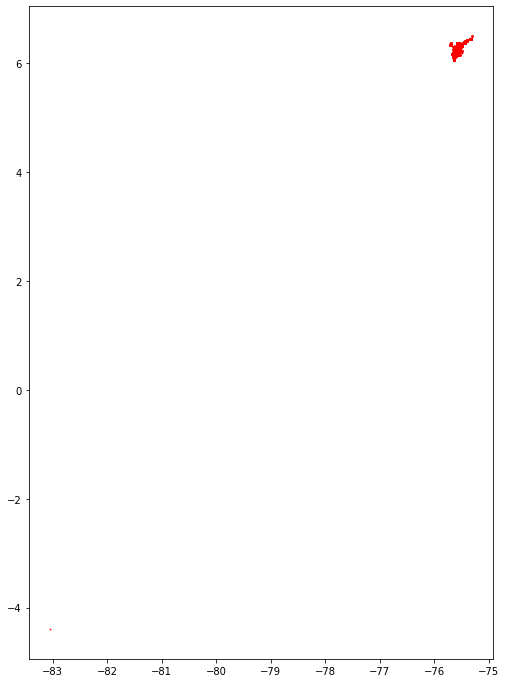

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
arboles.plot(ax=axis, color = "red",markersize =0.6)

In [ ]:
join_gdf = sjoin(mede_shp,arboles)


In [ ]:
mede_shp = countPunts(mede_shp,arboles,'arboles_dos')

###**atractivos turisticos**


In [ ]:
turisticos2 = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Atractivos turísticos/desarrollo_economico_gdb.shp')
turisticos2.head()

,OBJECTID,NOMBRESITI,IMPERDIBLE,TIPOATRACT,LABEL,DIRECCION,COD_COMUNA,COMUNA,BARRIO,X_MAGNAMED,Y_MAGNAMED,LATITUD,LONGITUD,geometry
0,1,Aeroparque Parque Juan Pablo II,NO,Parque temático y recreativo,NaN,CR 70 No. 16 - 04,15,15,Parque Juan Pablo II,832413.3850,1.180052e+06,6.222290,-75.591675,POINT (-75.59167 6.22229)
1,2,Aeropuerto Enrique Olaya Herrera,NO,Aeropuerto de pasajeros,NaN,CR 65 A No. 13 - 157,15,15,Parque Juan Pablo II,832656.5921,1.179674e+06,6.218872,-75.589478,POINT (-75.58948 6.21887)
2,3,Barrio Prado,NO,Sector urbano o rural de interés,NaN,CR 50 No. 62-99,10,10,Prado,835717.1628,1.184170e+06,6.259521,-75.561829,POINT (-75.56183 6.25952)
3,4,Basílica Menor Nuestra Señora de la Candelaria,NO,Basílica,NaN,CR 49 a No. 50 - 85,10,10,La Candelaria,835088.8716,1.183130e+06,6.250122,-75.567505,POINT (-75.56750 6.25012)
4,5,Bulevar Libertadores de América,NO,Sector urbano o rural de interés,NaN,CR 70 entre la CL 47D y circular 1A,11,11,Florida Nueva,832785.1207,1.183258e+06,6.251282,-75.588318,POINT (-75.58832 6.25128)


In [ ]:
turisticos.shape

(300, 8)

In [ ]:

turisticos2.shape

(92, 14)

Voy a dejar el primero, tiene más registros

###**camaras ars**
Estas son las camaras de Apoyo a la red semaforica

In [ ]:
ars = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Camaras ARS - SIMM/movilidad_gdb.shp')
ars.head()

ERROR:fiona._env:Pointer 'hGeom' is NULL in 'OGR_G_GetGeometryType'.

ERROR:fiona._env:Pointer 'hGeom' is NULL in 'OGR_G_GetGeometryType'.



,OBJECTID,NAME,DIRECCION,LOCALIZACI,X,Y,POINT_X,POINT_Y,geometry
0,1,ARS_1,Asados de la 80,Av. 80 x Cll 30A,831252.050700,1.181125e+06,831255.2856,1.181132e+06,POINT (-75.60214 6.23206)
1,2,ARS_2,Av. Bolivariana x Carrera 65,Carrera 66B x Calle 42,833290.706561,1.182619e+06,833293.9147,1.182626e+06,POINT (-75.58372 6.24557)
2,3,ARS_3,Avenida Villas Occidente,Carrera 66 B x Calle 33,832876.477746,1.181940e+06,832879.6889,1.181947e+06,POINT (-75.58746 6.23943)
3,4,ARS_4,Avenida Villas Oriente,Carrera 66 x Calle 33,832987.390034,1.181946e+06,832990.5992,1.181953e+06,POINT (-75.58646 6.23948)
4,5,ARS_5,Banco Caja Social,Cra 43A x Cll 3 Sur,834524.489332,1.177703e+06,834527.6439,1.177710e+06,POINT (-75.57257 6.20112)


In [ ]:
ars.shape

(67, 9)

In [ ]:
ars.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

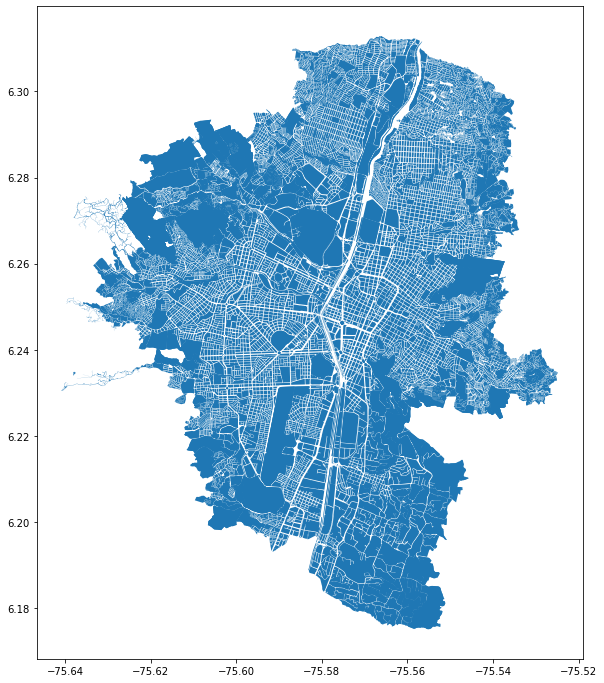

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
ars.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,ars,'ars_camaras')

###**camaras cctv 2**


In [ ]:
camaras2 = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Camaras CCTV Movilidad -SIMM/movilidad_gdb.shp')
camaras2.head()

,OBJECTID,DIRECCION,LOCALIZACI,LINK_FOTO,LINK_DETAL,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,geometry
0,1,Cr 83C Cl 33,El Castillo,https://www.medellin.gov.co/simm/camaras-cctv/...,https://www.medellin.gov.co/simm/,830604.8779,1.181860e+06,-75.608014,6.238633,POINT (-75.60801 6.23863)
1,2,Cr 89 Cl 44,Everest,https://www.medellin.gov.co/simm/camaras-cctv/...,https://www.medellin.gov.co/simm/,830676.1727,1.183354e+06,-75.607371,6.252148,POINT (-75.60737 6.25215)
2,3,Cr 108BB Cl 62D,Túnel de Occidente,https://www.medellin.gov.co/simm/camaras-cctv/...,https://www.medellin.gov.co/simm/,829333.0341,1.186061e+06,-75.619508,6.276615,POINT (-75.61951 6.27661)
3,4,Cr 65 Cl 71,La Florida,https://www.medellin.gov.co/simm/camaras-cctv/...,https://www.medellin.gov.co/simm/,833956.7933,1.185411e+06,-75.577733,6.270738,POINT (-75.57773 6.27074)
4,5,Cr 134 Cl 59,Vivero Túnel de Occidente,https://www.medellin.gov.co/simm/camaras-cctv/...,https://www.medellin.gov.co/simm/,826956.5548,1.186004e+06,-75.640979,6.276098,POINT (-75.64098 6.27610)


In [ ]:
camaras.shape

(2896, 10)

In [ ]:
camaras2.shape

(81, 10)

Estas camaras son de movilidad, no las pondré

###**camaras fotodetención**


In [ ]:
fotodetencion = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Camaras Fotodeteccion - FDT - SIMM/movilidad_gdb.shp')
fotodetencion.head()

,OBJECTID,OBJECTID_1,ID,DIRECCION,DESCRIPCIO,TIPO,LONGITUD,LATITUD,SENTIDO,OPERANDO,...,EV,PSC,PYP,SR,CI,SOAT,RTM,POINT_X,POINT_Y,geometry
0,1,72,101,Avenida 80 por Calle 35,Don Quijote NORTE-SUR,CAMARA,831178.736482,1.182428e+06,NORTE-SUR,OPERANDO,...,X,NaN,X,X,NaN,x,x,831181.9810,1.182435e+06,POINT (-75.60286 6.24369)
1,2,73,201,Avenida 80 por Carrera 76,La Mota NORTE-SUR,CAMARA,831572.965068,1.179689e+06,NORTE-SUR,OPERANDO,...,X,NaN,X,X,NaN,x,x,831576.1851,1.179696e+06,POINT (-75.59927 6.21898)
2,3,74,202,Avenida 80 por Carrera 76,La Mota NORTE-SUR,CAMARA,831580.505709,1.179705e+06,NORTE-SUR,OPERANDO,...,X,NaN,X,X,NaN,x,x,831583.7257,1.179712e+06,POINT (-75.59920 6.21908)
3,4,75,301,Calle 10 A por Carrera 36,10 Hotel ORI-OCC,CAMARA,835307.125302,1.178659e+06,ORIENTE-OCCIDENTE,DESMONTADO,...,X,X,X,X,NaN,x,x,835310.2720,1.178667e+06,POINT (-75.56551 6.20962)
4,5,76,302,Calle 10 A por Carrera 36,10 Hotel ORI-OCC,CAMARA,835302.627376,1.178646e+06,ORIENTE-OCCIDENTE,DESMONTADO,...,X,X,X,X,NaN,x,x,835305.7740,1.178654e+06,POINT (-75.56552 6.20952)


In [ ]:
fotodetencion.shape

(80, 21)

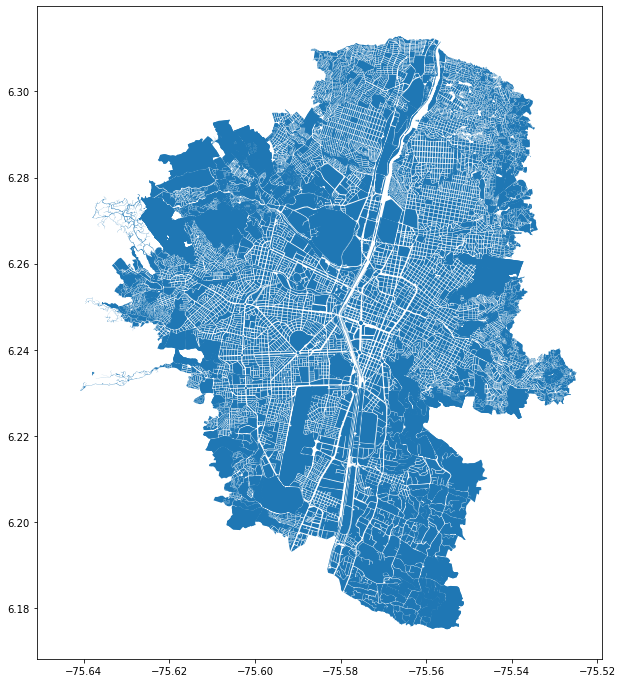

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
fotodetencion.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,fotodetencion,'fotodeteccion')

### **Ciclorrutas2**


In [ ]:
ciclorutas = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Ciclorrutas/planeacion_gdb.shp')
ciclorutas.head()

,OBJECTID,NOMBRE,LABEL,ESTADO,SHAPE__Len,geometry
0,1,Calle 29,Calle 29,Proyectado,1700.720442,"LINESTRING (-75.58270 6.23330, -75.58214 6.233..."
1,2,Ciclorruta Carrera 65,Carrera 65,Existente,428.461195,"LINESTRING (-75.58855 6.21074, -75.58854 6.210..."
2,3,Ciclorruta Fase 3,Ciclorruta Fase 3,Proyectado,1449.747578,"LINESTRING (-75.60850 6.23856, -75.60849 6.238..."
3,4,Ciclorruta Fase 3,Ciclorruta Fase 3,Proyectado,981.979737,"LINESTRING (-75.57514 6.24912, -75.57352 6.248..."
4,5,Calle 30A,Calle 30A,Proyectado,2050.612762,"LINESTRING (-75.60988 6.23161, -75.60757 6.231..."


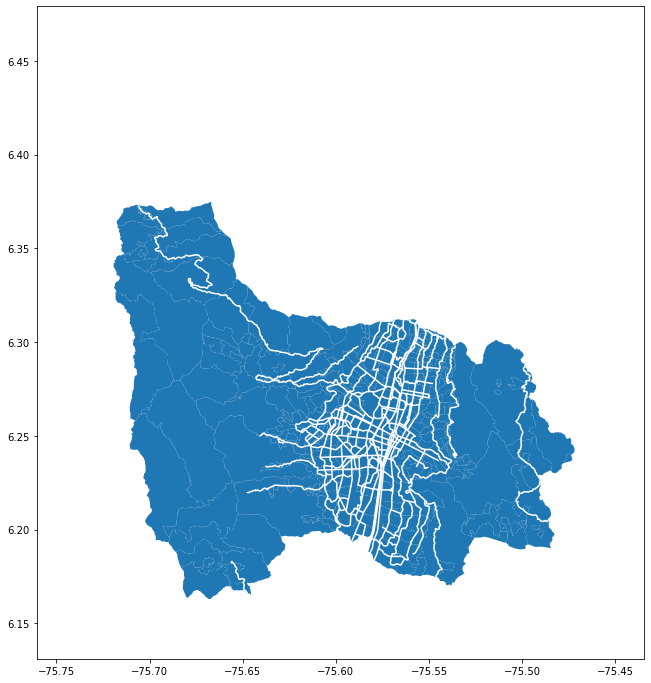

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
ciclorutas.plot(ax=axis, color = "white",markersize =0.6)

### **Cruces semafóricos**


In [ ]:
cruces = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Cruces semafóricos/movilidad_gdb.shp')
cruces.head()

,OBJECTID,ID_CRUCE,ID_CONTROL,DIRECCION,UBICACION,COD_BARRIO,X_MAGNAMED,Y_MAGNAMED,LATITUD,LONGITUD,LINK_FOTO,COD_SMF_CL,geometry
0,1,52,39,CR 34 CL 7,NaN,1417,835401.3739,1.178247e+06,6.205977,-75.564682,NaN,NaN,POINT (-75.56468 6.20598)
1,2,53,20,CR 35 CL 10,NaN,1418,835299.8738,1.178544e+06,6.208657,-75.565599,NaN,NaN,POINT (-75.56560 6.20866)
2,3,54,14,CR 35 CL 10 A,NaN,1406,835344.0760,1.178633e+06,6.209466,-75.565199,NaN,NaN,POINT (-75.56520 6.20947)
3,4,55,250,CR 35 CL 49,NaN,0907,836306.0031,1.182313e+06,6.242732,-75.556509,NaN,NaN,POINT (-75.55651 6.24273)
4,5,56,42,CR 35 CL 5 S,NaN,1415,834984.6417,1.177245e+06,6.196918,-75.568446,NaN,NaN,POINT (-75.56845 6.19692)


In [ ]:
semaforos.shape

(710, 36)

In [ ]:
cruces.shape

(723, 13)

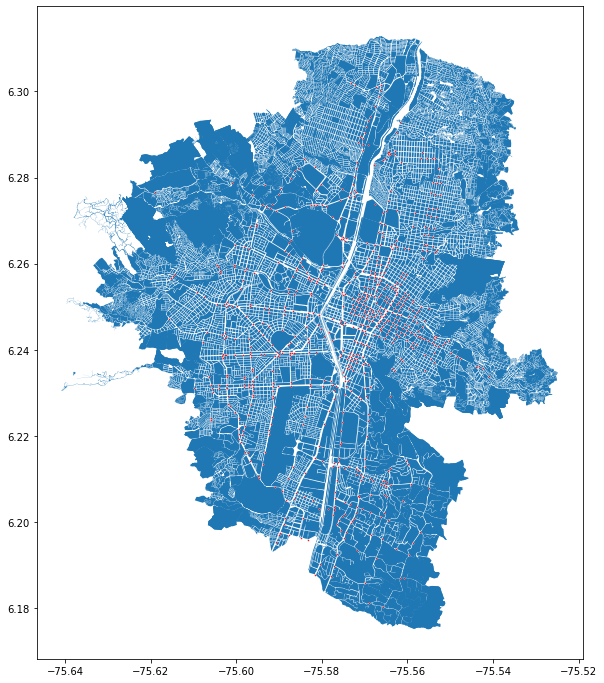

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
cruces.plot(ax=axis, color = "white",markersize =0.6)
semaforos.plot(ax=axis, color = "red",markersize =0.3)

In [ ]:
mede_shp = countPunts(mede_shp,cruces,'semaforos2')

### **Ecoparques**


In [ ]:
ecoparques = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Ecoparques/medioambiente_gdb.shp')
ecoparques.head()

,OBJECTID,NOMBRE,QUEBRADA_A,DOMINIO,FUNCION,CATEGORIA,SUBCATEGOR,JERARQUIA,ORDEN,COD_COMUNA,COMUNA,LABEL,ID_ELEMENT,ID_ZONA,CBML,DIRECCION_,SHAPE__Are,SHAPE__Len,geometry
0,1,Ecoparque Las Cometas,Q. Los Christmas,Bienes de uso público,Parques,Ecoparque,Ecoparque de quebrada y otros cuerpos de agua,Nivel zonal / Corregimental,Local,70,Corregimiento de Altavista,Las Cometas,1,1,70010000271,Carrera 113 18,5662.234863,371.328776,"POLYGON ((-75.64057 6.22068, -75.64060 6.22068..."
1,2,Ecoparque Bermejala Moravia,Q. La Bermejala,Bienes de uso público,Parques,Ecoparque,Ecoparque de quebrada y otros cuerpos de agua,Nivel Comunal/ Suburbano Nivel 1,Local,04,Aranjuez,Bermejala Moravia,3,3,04059990005,Calles 82A 52,14863.061523,1585.265205,"POLYGON ((-75.56798 6.28067, -75.56799 6.28060..."
2,3,Ecoparque Campo Santo Villatina,Q. La Loquita y Q. La Gallinaza,Bienes de uso público,Parques,Ecoparque,Ecoparque de Borde,Nivel Comunal/ Suburbano Nivel 1,Local,08,Villa Hermosa,Campo Santo Villatina,70,41,08140080230,Calle 56D 16,19177.791016,634.681608,"POLYGON ((-75.53866 6.24204, -75.53864 6.24203..."
3,4,Ecoparque Villa Turbay,NaN,Bienes de uso público,Parques,Ecoparque,Ecoparque de Borde,Nivel zonal / Corregimental,Local,90,Corregimiento de Santa Elena,Villa Turbay,102,61,90080000134,Calle 56B 4 este,13429.064453,620.865837,"POLYGON ((-75.52746 6.23726, -75.52748 6.23721..."
4,5,Ecoparque La Presidenta,Q. La Presidenta,Bienes de uso público,Parques,Ecoparque,Ecoparque de quebrada y otros cuerpos de agua,Nivel Comunal/ Suburbano Nivel 1,Local,14,El Poblado,La Presidenta,51,30,14170120006,Carrera 43A 7D,20032.840332,910.115708,"POLYGON ((-75.57088 6.20847, -75.57083 6.20843..."


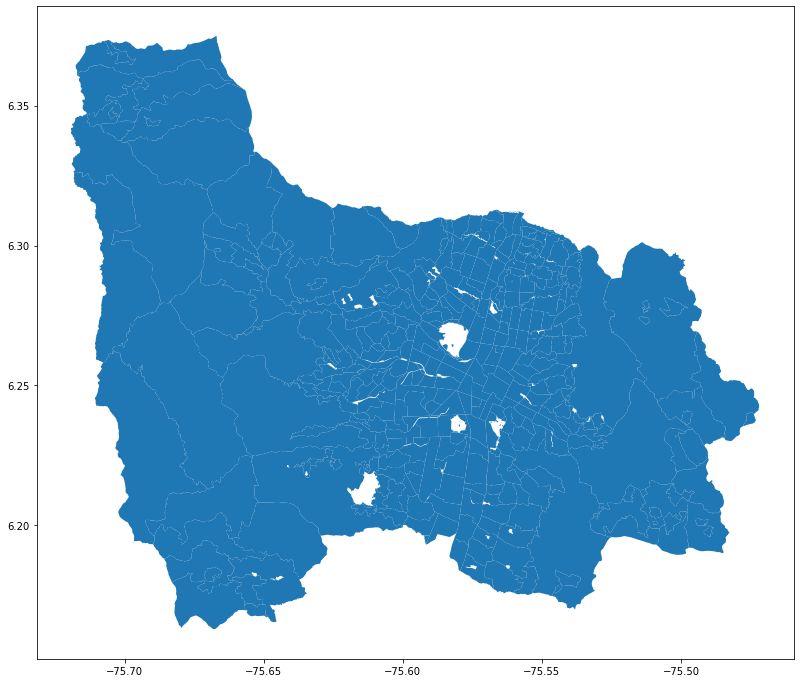

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
ecoparques.plot(ax=axis, color = "white",markersize =0.6)


Tratar de calcular la distancia a dichos lugares

### **Estaciones metro**


In [ ]:
estaciones = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Estaciones (Transporte masivo)/planeacion_gdb.shp')
estaciones.head()

,OBJECTID,NOMBRE,LINEA,RULEID,OVERRIDE,ESTADO,TIPO,TIPO_EST,geometry
0,452,El Pinal,Línea M,2,NaN,3,2,Estación,POINT (-75.54448 6.24526)
1,453,Sena-Pedregal,Línea P,2,NaN,1,2,Estación,POINT (-75.56732 6.30188)
2,454,Doce de Octubre,Línea P,2,NaN,1,2,Estación,POINT (-75.57595 6.30425)
3,455,El Progreso,Línea P,2,NaN,1,2,Estación,POINT (-75.58233 6.30600)
4,456,Acevedo,Línea A,1,NaN,1,1,Estación,POINT (-75.55831 6.30027)


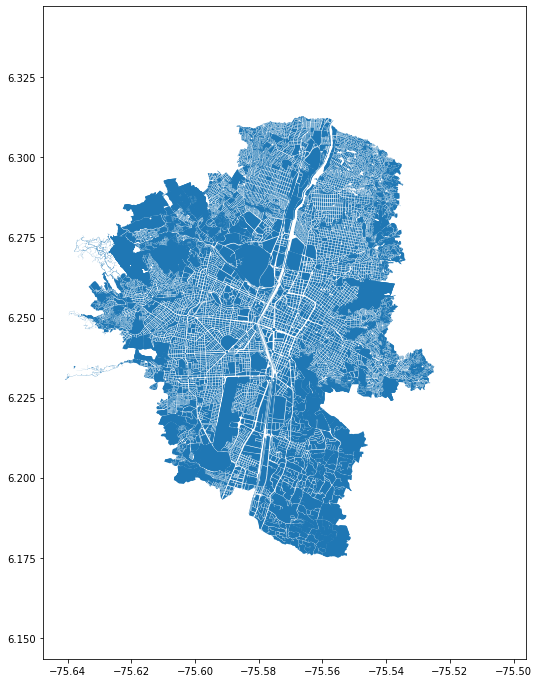

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
estaciones.plot(ax=axis, color = "white",markersize =0.6)


In [ ]:
mede_shp = countPunts(mede_shp,estaciones,'estaciones_metro')

### **Estadisticas por manzana (VOLVER)**


In [ ]:
estad_manz = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Estadisticas por Manzana/catastro.shp')
estad_manz.head()

,COMUNA,TOTAL_AREA,TOTAL_AR_1,AREA_PRIVA,CANT_PREDI,CANT_PROPI,CANT_MEJOR,AREA_MANZA,POBLACION_,OBJECTID,BARRIO,COBAMA,DESTINACIO,SHAPE__Are,SHAPE__Len,geometry
0,1,872,2597,1824,22,24,0,4551,68,1,0101,0101001,Residencial,4634.315918,407.335380,"POLYGON ((-75.54221 6.29241, -75.54223 6.29239..."
1,1,854,2577,1165,15,17,0,4551,0,2,0101,0101001,Comercial y Servicios,4634.315918,407.335380,"POLYGON ((-75.54221 6.29241, -75.54223 6.29239..."
2,1,3539,1742,1742,1,1,0,4551,0,3,0101,0101001,Equipamientos,4634.315918,407.335380,"POLYGON ((-75.54221 6.29241, -75.54223 6.29239..."
3,1,157,0,0,1,1,0,4551,0,4,0101,0101001,Lotes,4634.315918,407.335380,"POLYGON ((-75.54221 6.29241, -75.54223 6.29239..."
4,1,2282,4978,4443,55,66,0,2282,171,5,0101,0101002,Residencial,2323.870605,212.162231,"POLYGON ((-75.54260 6.29251, -75.54260 6.29254..."


In [ ]:
estad_manz.DESTINACIO.unique()

array(['Residencial', 'Comercial y Servicios', 'Equipamientos', 'Lotes',
       'Vias', 'Industrial', 'Complementarios', 'Otros'], dtype=object)

### **Hacienda**

Cantidad de establecimientos de Industria y Comercio activos por actividad comercial por mes



In [ ]:
hacienda = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/hacienda_gdb/hacienda_gdb.shp')
hacienda.head()

,OBJECTID,FECHA_INIC,HOMOLOGACI,GRUPO_ACTI,COMUNA,BARRIO,COORD_X,COORD_Y,geometry
0,1970561,2020-05-01,6209,SERVICIOS,El Poblado,Lalinde,835379.95,1179105.33,POINT (-75.56754 6.21368)
1,1970562,2020-05-04,1051,COMERCIO,Manrique,Versalles No. 1,837695.12,1184549.04,POINT (-75.54648 6.26281)
2,1970563,2020-05-04,4111,SERVICIOS,El Poblado,Altos del Poblado,836277.28,1179469.31,POINT (-75.55943 6.21695)
3,1970564,2020-05-05,4771,INDUSTRIA,La Candelaria,La Candelaria,834720.94,1182936.90,POINT (-75.57339 6.24833)
4,1970565,2020-05-05,8121,SERVICIOS,Aranjuez,Aranjuez,835656.00,1186689.42,POINT (-75.56483 6.28221)


In [ ]:
hacienda.GRUPO_ACTI.unique()

array(['SERVICIOS', 'COMERCIO', 'INDUSTRIA', 'FINANCIERO',
       'TRATAMIENTO ESPECIAL'], dtype=object)

In [ ]:
hacienda.groupby(['COMUNA','GRUPO_ACTI']).count()

OBJECTID  FECHA_INIC  HOMOLOGACI  BARRIO  \
COMUNA        GRUPO_ACTI                                                       
0             INDUSTRIA                    1           1           1       1   
AE            COMERCIO                    15          15          12      15   
              INDUSTRIA                   28          28          23      28   
              SERVICIOS                   38          38          32      38   
ALTAVISTA     COMERCIO                     1           1           1       1   
...                                      ...         ...         ...     ...   
Villa Hermosa COMERCIO                   525         525         417     525   
              FINANCIERO                  14          14          14      14   
              INDUSTRIA                 1655        1655        1254    1655   
              SERVICIOS                 1676        1676        1361    1676   
              TRATAMIENTO ESPECIAL         7           7           7       7   

                                    COORD_X  COORD_Y  geometry  
COMUNA        GRUPO_ACTI                                        
0             INDUSTRIA                   1        1         1  
AE            COMERCIO                   15       15        15  
              INDUSTRIA                  28       28        28  
              SERVICIOS                  38       38        38  
ALTAVISTA     COMERCIO                    1        1         1  
...                                     ...      ...       ...  
Villa Hermosa COMERCIO                  525      525       525  
              FINANCIERO                 14       14        14  
              INDUSTRIA                1655     1655      1655  
              SERVICIOS                1676     1676      1676  
              TRATAMIENTO ESPECIAL        7        7         7  

[188 rows x 7 columns]

In [ ]:
hacienda_serv = hacienda[hacienda.GRUPO_ACTI=='SERVICIOS']
hacienda_serv.shape

(83907, 9)

In [ ]:
hacienda_comer = hacienda[hacienda.GRUPO_ACTI=='COMERCIO']
hacienda_comer.shape

(23092, 9)

In [ ]:
hacienda_indus = hacienda[hacienda.GRUPO_ACTI=='INDUSTRIA']
hacienda_indus.shape

(74681, 9)

In [ ]:
hacienda_fin = hacienda[hacienda.GRUPO_ACTI=='FINANCIERO']
hacienda_fin.shape

(1741, 9)

In [ ]:
hacienda_espe = hacienda[hacienda.GRUPO_ACTI=='TRATAMIENTO ESPECIAL']
hacienda_espe.shape

(661, 9)

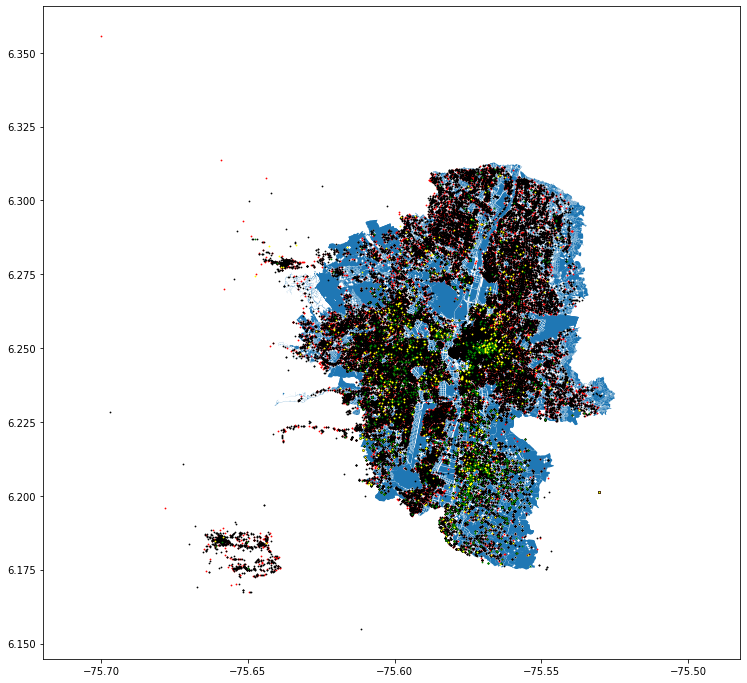

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
hacienda_serv.plot(ax=axis, color = "white",markersize =0.6)
hacienda_comer.plot(ax=axis, color = "red",markersize =0.6)
hacienda_indus.plot(ax=axis, color = "black",markersize =0.6)
hacienda_fin.plot(ax=axis, color = "green",markersize =0.6)
hacienda_espe.plot(ax=axis, color = "yellow",markersize =0.6)

In [ ]:
hacienda.columns

Index(['OBJECTID', 'FECHA_INIC', 'HOMOLOGACI', 'GRUPO_ACTI', 'COMUNA',
       'BARRIO', 'COORD_X', 'COORD_Y', 'geometry'],
      dtype='object')

In [ ]:
hacienda.columns = ['OBJECTID', 'FECHA_INIC', 'HOMOLOGACI', 'GRUPO_ACTI', 'COMUNA',
       'BARRIO2', 'COORD_X', 'COORD_Y', 'geometry']

In [ ]:
mede_shp = countPunts(mede_shp,hacienda_serv,'hacienda_servicios')

In [ ]:
mede_shp = countPunts(mede_shp,hacienda_comer,'hacienda_comercio')

In [ ]:
mede_shp = countPunts(mede_shp,hacienda_indus,'hacienda_industria')

In [ ]:
mede_shp = countPunts(mede_shp,hacienda_fin,'hacienda_financiera')

In [ ]:
mede_shp = countPunts(mede_shp,hacienda_espe,'hacienda_trat_especial')

In [ ]:
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,arboles_dos,ars_camaras,fotodeteccion,semaforos2,estaciones_metro,hacienda_servicios,hacienda_comercio,hacienda_industria,hacienda_financiera,hacienda_trat_especial
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


### **CATASTRO (VOLVER)**


In [ ]:
catastro = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Observatorio Inmobiliario de Medellín de Catastro/catastro.shp')
catastro.head()

,OBJECTID,CODIGO,CBML,TIPO_DE_OF,ESTADO,MATRICULA,AREA_PRIVA,VALOR_COME,FECHA,FUENTE,VALOR_M2,NOMBRE_FUE,USO_OFERTA,geometry
0,1,85913,04100010007,2,US,23771,25,350000,2012-12-04,1,14000.0,3,1,POINT (-75.55511 6.26957)
1,2,89038,04100010024,1,US,190459,113,100000000,2013-04-19,1,885000.0,3,3,POINT (-75.55560 6.26976)
2,3,85915,04100010053,2,US,900091449,102,900000,2012-12-04,1,9000.0,3,2,POINT (-75.55486 6.27000)
3,4,81630,04100010060,1,US,5094576,100,130000000,2012-07-31,1,1300000.0,1,1,POINT (-75.55482 6.26974)
4,5,80926,04100020006,1,US,5083280,220,110000000,2012-07-05,1,500000.0,3,1,POINT (-75.55621 6.26977)


In [ ]:
catastro.shape

(15725, 14)

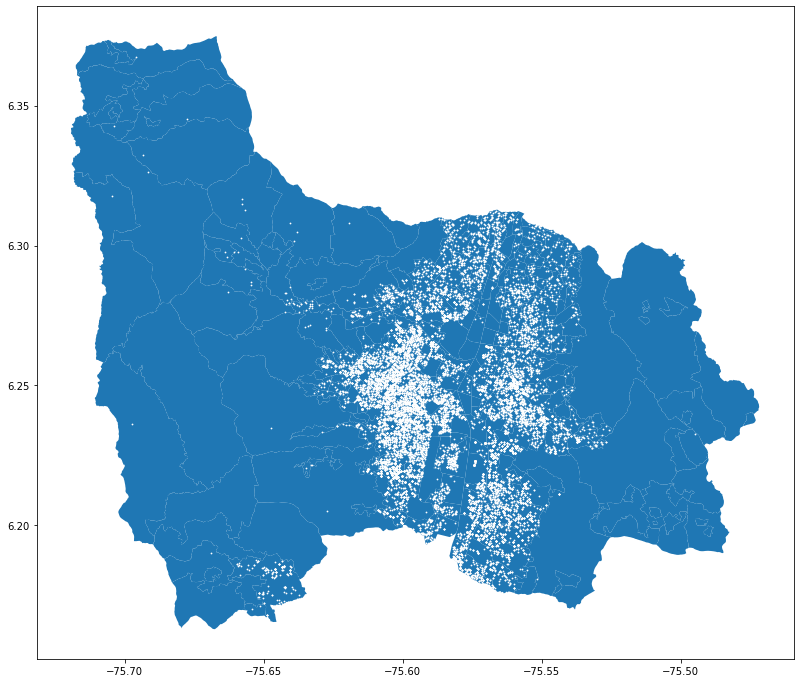

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
catastro.plot(ax=axis, color = "white",markersize =0.6)


### **Paradas trasnporte público**


In [ ]:
trasp_pub = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Paradas de Transporte Público Colectivo/movilidad_gdb.shp')
trasp_pub.head()

,ID_PARADER,ID_PARADA,ID_RUTA,NRO_PARADA,NOMBRE,DIRECCION,ORIENTACIO,MOBILIARIO,TIPO_PARAD,RECORRIDO,...,TIPO_RUTA,EMPRESA,ID_GFLOTA,FROM_DATE,OBJECTID,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,geometry
0,50233,90332008,90332,8.0,NaN,"CL 62B x CR 143A , Medellin",S,NaN,Reglamentaria,Origen-Destino,...,Integrada,Tax Maya,112112,2018-08-01,1,826678.1049,1.186126e+06,-75.643495,6.277197,POINT (-75.64349 6.27720)
1,50237,90331082,90331,82.0,NaN,"CR 143A 62B-281, Medellin",W,NaN,Reglamentaria,Destino-Origen,...,Integrada,Tax Maya,112102,2018-08-01,2,826709.9541,1.186398e+06,-75.643208,6.279659,POINT (-75.64321 6.27966)
2,50237,90334023,90334,23.0,NaN,"CR 143A 62B-281, Medellin",W,NaN,Reglamentaria,Destino-Origen,...,Integrada,Tax Maya,112072,2018-08-01,3,826709.9541,1.186398e+06,-75.643208,6.279659,POINT (-75.64321 6.27966)
3,50237,90328080,90328,80.0,NaN,"CR 143A 62B-281, Medellin",W,NaN,Reglamentaria,Destino-Origen,...,Integrada,Tax Maya,112062,2021-08-30,4,826709.9541,1.186398e+06,-75.643208,6.279659,POINT (-75.64321 6.27966)
4,50237,90355078,90355,78.0,NaN,"CR 143A 62B-281, Medellin",W,NaN,Reglamentaria,Destino-Origen,...,Integrada,Tax Maya,113042,2021-08-30,5,826709.9541,1.186398e+06,-75.643208,6.279659,POINT (-75.64321 6.27966)


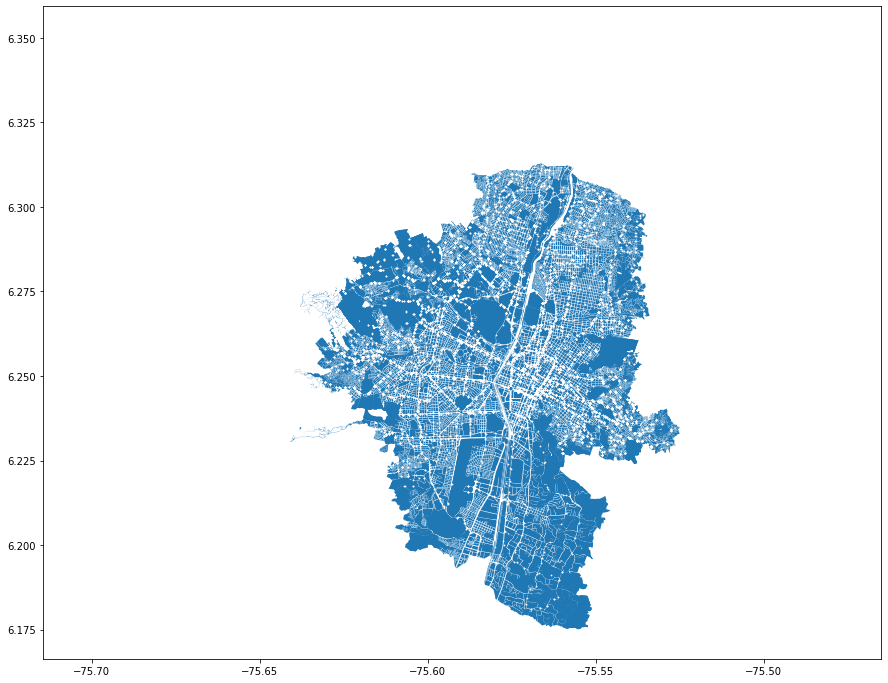

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
trasp_pub.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
trasp_pub.shape

(10291, 23)

In [ ]:
trasp_pub.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
mede_shp = countPunts(mede_shp,trasp_pub,'paraderos_carro2')

### **Bienes de interés cultural (volver)**


In [ ]:
bien_cultu = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Patrimonio - Bienes de Interes Cultural BIC/planeacion_gdb.shp')
bien_cultu.head()

,OBJECTID,GRUPO,SUBGRUPO,TIPO,NOMBRE,DIRECCION,LABEL,NOMBRE_SEC,SHAPE__Are,SHAPE__Len,geometry
0,1,Arquitectónico,Paisaje cultural,N.A,Edificio San Fernando,Carrera 49 50 54/72/58,Edificio San Fernando,NaN,697.600586,106.045285,"POLYGON ((-75.56627 6.24947, -75.56631 6.24938..."
1,2,Arquitectónico,Paisaje cultural,N.A,"Edificio Gran Colombia ""Bemogu""",Carrera 49 50 10/22,"Edificio Gran Colombia ""Bemogu""",NaN,632.124023,101.103838,"POLYGON ((-75.56647 6.24910, -75.56656 6.24893..."
2,3,Arquitectónico,Edificaciones,Obra de arquitectura,Edificio Seguros Bolívar,Carrera 49 49 73,Edificio Seguros Bolívar,NaN,849.748535,116.661263,"POLYGON ((-75.56707 6.24884, -75.56711 6.24876..."
3,4,Arquitectónico,Paisaje cultural,N.A,Edificio Atlas Lalinde,Calle 50 49 44,Edificio Atlas Lalinde,NaN,663.951172,108.943454,"POLYGON ((-75.56716 6.24930, -75.56717 6.24929..."
4,5,Arquitectónico,Paisaje cultural,N.A,Edificio Luis M. Mejía,Carrera 49 50 1,Edificio Luis M. Mejía,NaN,437.872559,88.052031,"POLYGON ((-75.56722 6.24918, -75.56719 6.24925..."


In [ ]:
bien_cultu.shape

(397, 11)

In [ ]:
bien_cultu.NOMBRE


0                                  Edificio San Fernando
1                        Edificio Gran Colombia "Bemogu"
2                               Edificio Seguros Bolívar
3                                 Edificio Atlas Lalinde
4                                 Edificio Luis M. Mejía
                             ...                        
392                             Edificación Barrio Prado
393                            Convento Siervas de María
394                              Edificación Republicana
395                                     Edificio Erlinda
396    Edificación Republicana Sede Congregación Mariana
Name: NOMBRE, Length: 397, dtype: object

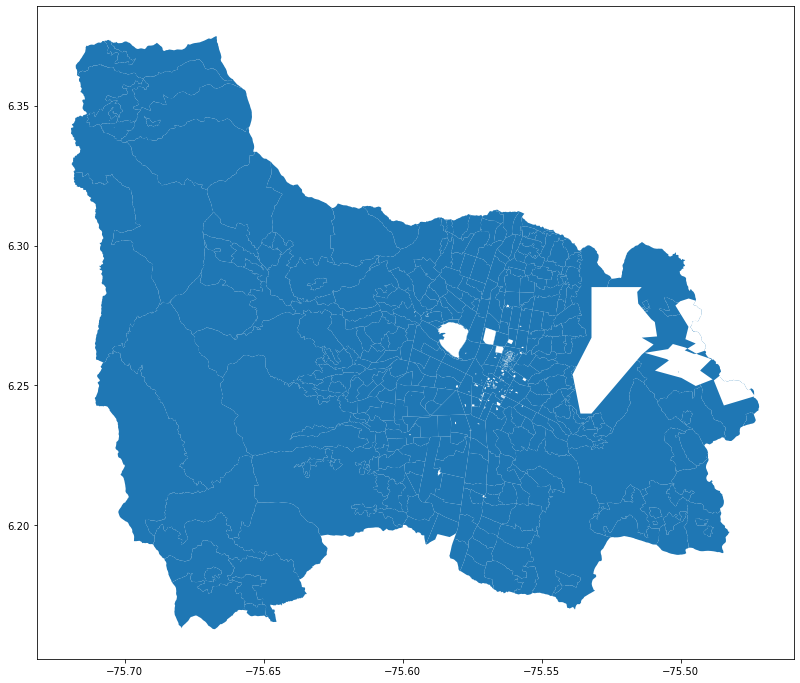

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
bien_cultu.plot(ax=axis, color = "white",markersize =0.6)

### **Quebradas (Volver)**


In [ ]:
quebradas = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Quebradas/medioambiente_gdb.shp')
quebradas.head()

,OBJECTID,IDTRAM,CODQUEB,CODTRAM,COTIPOTRAM,COFORMA,CELDA,COMATTALUD,COMATLECHO,COFUNCIONA,...,CODIRAGUAS,CODIRAGU_1,COAGUA,OBSERVACIO,NOMBRE,CODCAMPO,CONSECUTIV,TIPOCAUCE,SHAPE__Len,geometry
0,1,TR0010090096523206020000,90096523206020000,TR00100,N,O,1.0,P,T,O,...,NaN,NaN,N,NaN,NaN,NaN,20829,Afluente,354.124029,"LINESTRING (-75.68446 6.34962, -75.68439 6.349..."
1,2,TR0140003042000000000000,03042000000000000,TR01400,B,C,2.0,C,C,V,...,NaN,NaN,C,NaN,Q. La Guayabala,NaN,20830,Afluente,228.000677,"LINESTRING (-75.62509 6.20678, -75.62507 6.206..."
2,3,TR0030003042100000000000,03042100000000000,TR00300,B,C,1.0,C,C,V,...,NaN,NaN,C,NaN,NaN,NaN,20831,Afluente,10.305760,"LINESTRING (-75.62141 6.20592, -75.62140 6.205..."
3,4,TR0040003042100000000000,03042100000000000,TR00400,N,O,1.0,P,P,O,...,NaN,NaN,C,NaN,NaN,NaN,20832,Afluente,109.793787,"LINESTRING (-75.62138 6.20601, -75.62137 6.206..."
4,5,TR0010003012010000000000,03012010000000000,TR00100,N,O,1.0,T,T,O,...,NaN,NaN,N,NaN,NaN,NaN,20833,Afluente,76.627800,"LINESTRING (-75.63881 6.21491, -75.63882 6.214..."


In [ ]:
quebradas.shape

(10312, 24)

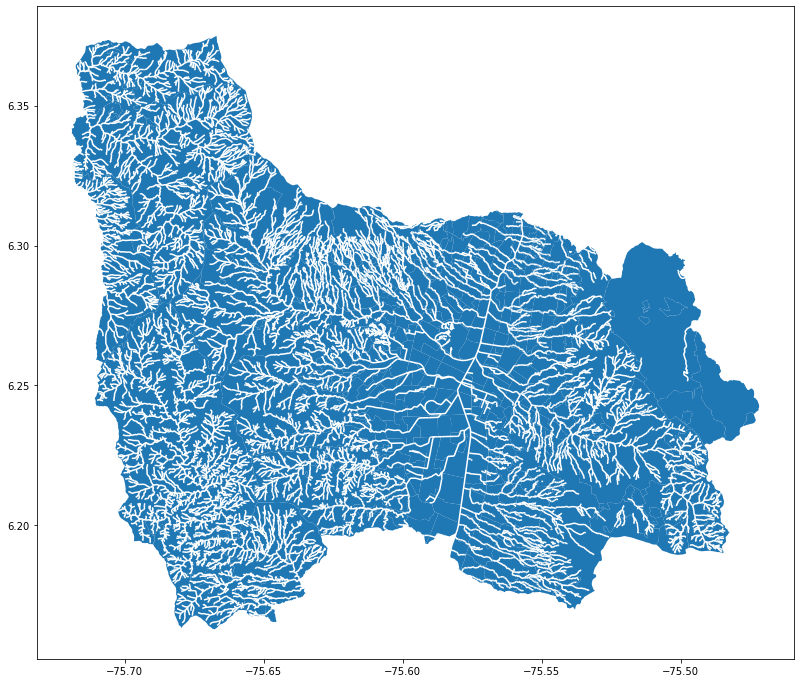

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
quebradas.plot(ax=axis, color = "white",markersize =0.6)

### **Señalización(Volver)**


In [ ]:
señal = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Senalizacion/movilidad_gdb.shp')
señal.head()

,OBJECTID,ID_OP,ORD_ELEM,NO_CARRILE,POSC_CALZA,SENTIDO_FL,ABS_INICIA,ABS_FINAL,OFFSET,COD_SENAL_,...,LINK_FOTO,TEXTO_DESC,ID_SENAL_H,COD_BARRIO,X_MAGNAMED,Y_MAGNAMED,LATITUD,LONGITUD,SHAPE__Len,geometry
0,1,5000250,2,2,21.0,-1.0,8.5,13.5,-1.6,FGI,...,NaN,NaN,1,1504,NaN,NaN,NaN,NaN,5.029859,"LINESTRING (-75.58338 6.22090, -75.58343 6.22091)"
1,2,5000249,2,2,22.0,1.0,31.5,36.5,1.5,FGI,...,NaN,NaN,2,1504,NaN,NaN,NaN,NaN,5.029859,"LINESTRING (-75.58322 6.22089, -75.58326 6.22090)"
2,3,2000358,2,4,21.0,-1.0,45.0,50.0,-1.6,F,...,NaN,NaN,3,1509,NaN,NaN,NaN,NaN,4.227329,"LINESTRING (-75.58664 6.20542, -75.58665 6.20538)"
3,5,2000362,2,4,NaN,NaN,16.1,52.1,NaN,LC,...,NaN,NaN,5,1509,NaN,NaN,NaN,NaN,36.406588,"LINESTRING (-75.58578 6.20755, -75.58574 6.207..."
4,6,2000362,2,4,NaN,NaN,57.1,67.2,NaN,LC,...,NaN,NaN,6,1509,NaN,NaN,NaN,NaN,10.213067,"LINESTRING (-75.58564 6.20789, -75.58560 6.20797)"


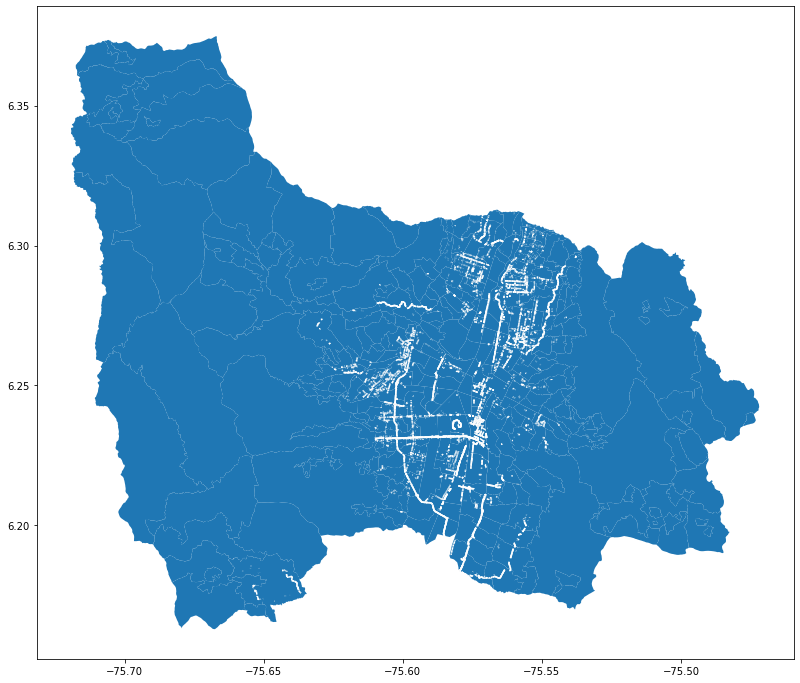

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
señal.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
señal.columns

Index(['OBJECTID', 'ID_OP', 'ORD_ELEM', 'NO_CARRILE', 'POSC_CALZA',
       'SENTIDO_FL', 'ABS_INICIA', 'ABS_FINAL', 'OFFSET', 'COD_SENAL_',
       'DESC_SENAL', 'TIPO_LINEA', 'COLOR_LINE', 'MATERIAL_P', 'ESPESOR_LI',
       'LONG_ACUM', 'FECHA', 'DIRECCION', 'OBSERVACIO', 'ID_CONTRAT',
       'LINK_FOTO', 'TEXTO_DESC', 'ID_SENAL_H', 'COD_BARRIO', 'X_MAGNAMED',
       'Y_MAGNAMED', 'LATITUD', 'LONGITUD', 'SHAPE__Len', 'geometry'],
      dtype='object')

In [ ]:
señal.ABS_FINAL

0        13.5
1        36.5
2        50.0
3        52.1
4        67.2
         ... 
23116    21.5
23117    16.8
23118    17.2
23119    10.7
23120    17.7
Name: ABS_FINAL, Length: 23121, dtype: float64

### **Residuos**


In [ ]:
residuos = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Sitios de aprovechamiento de residuos sólidos/medioambiente_gdb.shp')
residuos.head()

,OBJECTID,ANO,COORDENADA,COORDENA_1,ID_COMPRAV,geometry
0,1,2012,827509.5600,1.174893e+06,5048,POINT (-75.63597 6.17565)
1,2,2012,825128.6300,1.175848e+06,5046,POINT (-75.65748 6.18428)
2,3,2012,825519.3504,1.175864e+06,5044,POINT (-75.65395 6.18442)
3,4,2012,826605.0900,1.175870e+06,5045,POINT (-75.64414 6.18448)
4,5,2012,825334.0400,1.175945e+06,4992,POINT (-75.65562 6.18516)


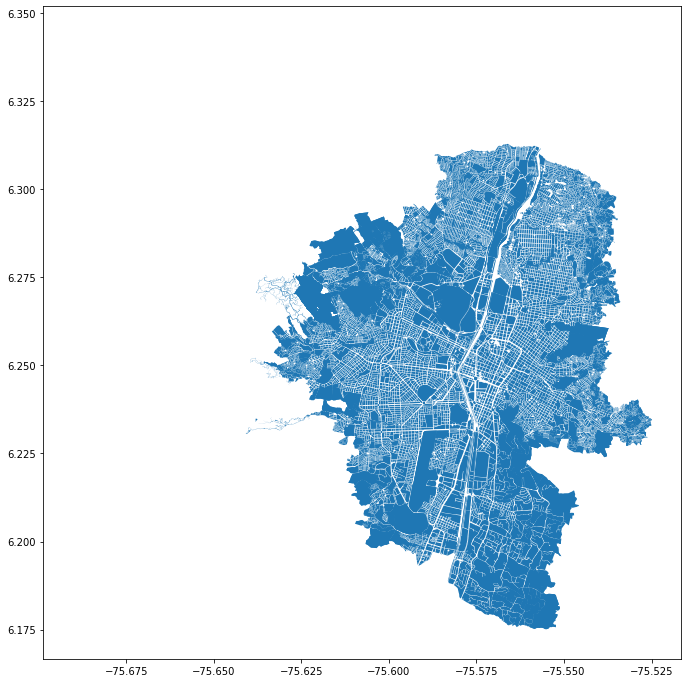

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
residuos.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,residuos,'centros_residuos')

### **Usos del predio(VOLVER)**

pa calculada que permite ubicar la información predial alfanumérica (matrículas e identificadores de predios) teniendo en cuenta el código de ubicación del predio -CBML- y cruzando la información de la dirección, número de mejora, número IEP, número de edificación, destinación, estrato, entre otras variables



In [ ]:
pred = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Usos del Predio/catastro.shp')
pred.head()

,OBJECTID,ID_PREDIO,CBML,TIPO_PUNTO,NUMERO_TIP,X_MAGNAMED,Y_MAGNAMED,LONGITUD,LATITUD,NOMBRE_PRE,DIRECCION,PISO_UBICA,NUMERO_EDI,NUMERO_PRE,DESTINACIO,ESTRATO,geometry
0,7254,700005501,50020000072,Mejora,1.0,821348.2053,1.191472e+06,-75.691661,6.325525,NaN,VÍA LA FRISOLA PARTE BAJA # 677,1.0,NaN,NaN,Residencial,2.0,POINT (-75.69166 6.32552)
1,7255,700005502,50020000074,Mejora,1.0,821328.5148,1.191510e+06,-75.691839,6.325860,NaN,VÍA LA FRISOLA PARTE BAJA # 680 (0101),1.0,NaN,NaN,Residencial,2.0,POINT (-75.69184 6.32586)
2,7256,700005505,50020000101,Mejora,1.0,820164.9722,1.191544e+06,-75.702353,6.326166,VIA MIRADOR DE OCCIDENTE + 3.1,VÍA LA FRISOLA PARTE BAJA KM 2 # 345 (0150),1.0,NaN,NaN,Residencial,2.0,POINT (-75.70235 6.32617)
3,7257,700005506,50020000101,Mejora,2.0,820116.9593,1.191605e+06,-75.702787,6.326724,VIA MIRADOR DE OCCIDENTE + 3.1,VÍA LA FRISOLA PARTE BAJA KM 2 # 601 (0140),1.0,NaN,NaN,Residencial,2.0,POINT (-75.70279 6.32672)
4,7258,700005507,50020000101,Mejora,3.0,820125.9128,1.191368e+06,-75.702705,6.324576,VIA MIRADOR DE OCCIDENTE + 3.1,VÍA LA FRISOLA PARTE ALTA # 497,1.0,NaN,NaN,Residencial,2.0,POINT (-75.70271 6.32458)


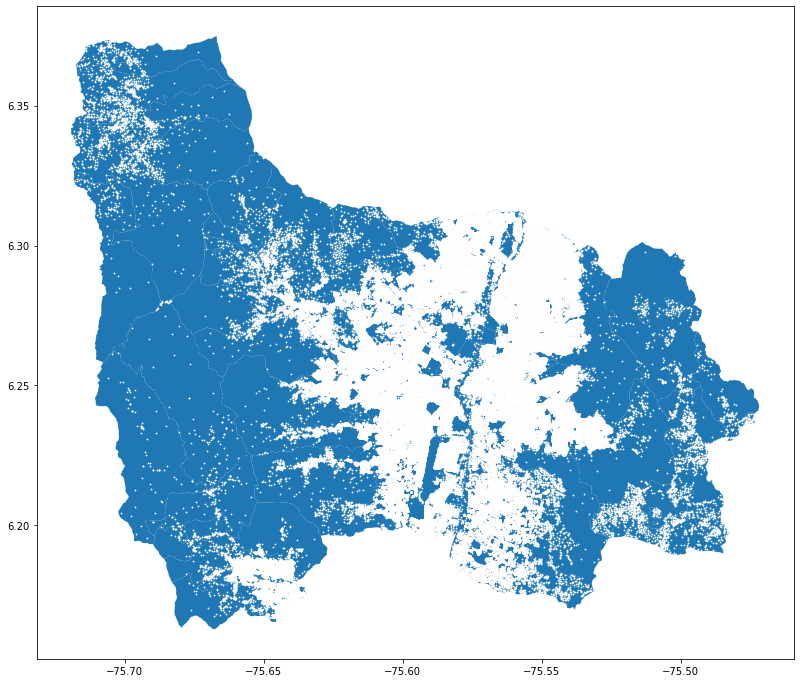

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
pred.plot(ax=axis, color = "white",markersize =0.6)

In [ ]:
mede_shp = countPunts(mede_shp,pred,'predios')

In [ ]:
mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_4.shp')

<ipython-input-289-4751b4cef4e1>:1: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  mede_shp.to_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_4.shp')


### **Zonas verdes**


In [ ]:
zonas_verdes = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/nuevos_shapes/Zonas Verdes/medioambiente_gdb.shp')
zonas_verdes.head()

,OBJECTID,ID_PL,ID_POLIGON,TIPOLOGIA,CATEGORIA,SUBCATEGOR,COBER_DOM,NARB_APROX,CUBIERTA_V,POTENCIAL_,...,OBSERVACIO,SH_SUBCATE,SH_COMPONE,SH_ELEMENT,SH_ELEME_1,SH_SUBCLAS,SH_SUBCL_1,SHAPE__Are,SHAPE__Len,geometry
0,1,579,2308,AsocioMovilidad,OrejaPuente,No aplica,Grama,Rango 1,No aplica,No aplica,...,4 arboles,No aplica,No aplica,No aplica,No aplica,No aplica,No aplica,515.319824,201.346458,"POLYGON ((-75.56831 6.24431, -75.56849 6.24399..."
1,2,583,2908,AsocioEP,EcoparqueQuebrada,No aplica,Grama,Rango 4,No aplica,No aplica,...,No todo el polígono está contenido en la Estru...,Áreas de interés estratégico,Sistema Hidrográfico,Rios y quebradas con sus retiros,No aplica,30,No aplica,4295.934570,946.228669,"POLYGON ((-75.55555 6.24540, -75.55544 6.24531..."
2,3,583,2909,AsocioEP,EcoparqueQuebrada,No aplica,Grama,Rango 3,No aplica,No aplica,...,12 arbustos y arboles. No llega street view,Áreas de interés estratégico,Sistema Hidrográfico,Rios y quebradas con sus retiros,No aplica,30,No aplica,3710.842285,874.660960,"POLYGON ((-75.55456 6.24448, -75.55462 6.24455..."
3,4,580,3107,AsocioMovilidad,OrejaPuente,No aplica,Grama,Rango 1,No aplica,No aplica,...,NaN,No aplica,No aplica,No aplica,No aplica,No aplica,No aplica,68.582520,41.557343,"POLYGON ((-75.56783 6.24438, -75.56783 6.24438..."
4,5,581,3582,AsocioMovilidad,FranjaAmoblamiento,No aplica,Jardin,Rango 1,No aplica,No aplica,...,1 arbol,No aplica,No aplica,No aplica,No aplica,No aplica,No aplica,29.161133,38.335025,"POLYGON ((-75.55986 6.24442, -75.55987 6.24441..."


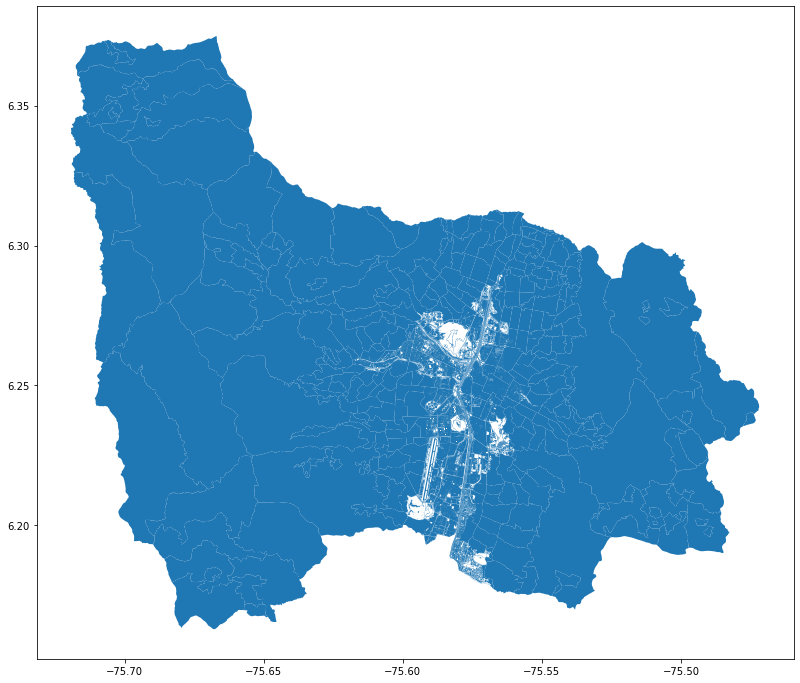

In [ ]:
axis = mede_shp.plot(figsize=(20,12))
zonas_verdes.plot(ax=axis, color = "white",markersize =0.6)

### **LECTURA**

In [ ]:
mede_shp = gpd.read_file('/content/drive/MyDrive/Maestria_eafit/shapes_creados/casos_hurtos_manzanas_4.shp')
mede_shp.head()

,OBJECTID_l,BARRIOVERE,COBAMA,SHAPE_AREA,SHAPE_LEN,nombre,index_righ,OBJECTID_r,CODIGO,COMUNA,...,estaciones,hacienda_s,hacienda_c,hacienda_i,hacienda_f,hacienda_t,paraderos_,centros_re,predios,geometry
0,1,NaN,0102007,3981.148627,418.198377,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.0,"POLYGON ((-75.54153 6.30039, -75.54151 6.30034..."
1,2,NaN,0102041,395.789943,153.853216,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,"MULTIPOLYGON (((-75.53827 6.29925, -75.53825 6..."
2,3,NaN,0102025,2166.340269,428.456959,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.0,"MULTIPOLYGON (((-75.53937 6.29904, -75.53933 6..."
3,8,NaN,0102027,755.183915,112.449069,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,"POLYGON ((-75.53907 6.29918, -75.53908 6.29918..."
4,23,NaN,0102017,779.242492,115.717128,NaN,38,6791,0102,01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,"POLYGON ((-75.54006 6.29889, -75.54006 6.29888..."


In [ ]:
mede_shp.shape

(10736, 48)

In [ ]:
mede_shp.columns

Index(['OBJECTID', 'CODIGO', 'COMUNA', 'BARRIO', 'NOMBRE_BAR', 'SECTOR',
       'INDICADOR_', 'NOMBRE_COM', 'SHAPE__Are', 'SHAPE__Len', 'key', 'casos',
       'numero_ven', 'numero_sit', 'numero_sem', 'num_sedes_', 'num_postes',
       'num_parade', 'num_inst_e', 'num_hotele', 'num_esc_de', 'num_conv_n',
       'num_centro', 'num_camara', 'num_biblio', 'num_arbole', 'acopios_ta',
       'arboles_do', 'ars_camara', 'fotodetecc', 'semaforos2', 'estaciones',
       'hacienda_s', 'hacienda_c', 'hacienda_i', 'hacienda_f', 'hacienda_t',
       'paraderos_', 'centros_re', 'predios', 'geometry'],
      dtype='object')

In [ ]:
mede_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 349 entries, 0 to 348
Data columns (total 41 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    349 non-null    int64   
 1   CODIGO      349 non-null    object  
 2   COMUNA      349 non-null    object  
 3   BARRIO      349 non-null    object  
 4   NOMBRE_BAR  349 non-null    object  
 5   SECTOR      349 non-null    int64   
 6   INDICADOR_  345 non-null    object  
 7   NOMBRE_COM  349 non-null    object  
 8   SHAPE__Are  349 non-null    float64 
 9   SHAPE__Len  349 non-null    float64 
 10  key         349 non-null    object  
 11  casos       349 non-null    int64   
 12  numero_ven  17 non-null     float64 
 13  numero_sit  115 non-null    float64 
 14  numero_sem  143 non-null    float64 
 15  num_sedes_  143 non-null    float64 
 16  num_postes  335 non-null    float64 
 17  num_parade  317 non-null    float64 
 18  num_inst_e  262 non-null    float64 
 19  